In [152]:
library(targets)
library(Seurat)
library(CellAnnotatoR)
library(tidyverse)
source('cellbender_preprocess.R')
source('process_seurat.R')

In [537]:
tar_meta(fields = error, complete_only = TRUE)

name,error
<chr>,<chr>
obj_cb_class_sct,unused argument obj_cb_02
obj_cb_neuron_3,1mCaused by error22m33m39m object labels_202310 not found
obj_cb_neuron_4,cannot coerce type builtin to vector of type character


In [527]:
obj = qs::qread("/projects/amj/my_projects/reference_ARCDVC/20231010_full_integration/1_dat/1_seurat_obj/20231027_ARC_VMH_filtered.qs")
obj

An object of class Seurat 
27239 features across 182346 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [535]:
predictions = qs::qread('_targets/objects/obj_cb_neuron_4')
predictions

,predicted.id,prediction.score.Lepr_8,prediction.score.Esr1_4,prediction.score.Esr1_1,prediction.score.Lepr_4,prediction.score.Sst.Nts,prediction.score.Lepr_6,prediction.score.Nfix.Nfib.Hgf,prediction.score.Lepr_9,prediction.score.Sst.Unc13c,⋯,prediction.score.Hdc,prediction.score.Esr1_2,prediction.score.Esr1_3,prediction.score.Reln.Lef1,prediction.score.Foxp2_3,prediction.score.Lepr_3,prediction.score.Sim1.Rprm,prediction.score.Sim1.Ebf3,prediction.score.Lepr_1,prediction.score.max
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SI-TT-A11_AAACCCAAGGTGGTTG,Sst/Pthlh,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,0,0.00000000,1.0000000
SI-TT-A11_AAACCCACATACAGCT,Nfix/Nfib,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,0,0.00000000,0.7402312
SI-TT-A11_AAACCCACATGAGGGT,Th/Nfib,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.1131071,⋯,0,0.0000000,0.000000000,0.010375684,0.008489881,0.000000000,0,0,0.00000000,0.2298922
SI-TT-A11_AAACCCAGTACGTTCA,Agrp,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,0,0.00000000,1.0000000
SI-TT-A11_AAACCCATCCAAGCAT,Sim1/Ebf3,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,1,0.00000000,1.0000000
SI-TT-A11_AAACCCATCCCATAAG,Fezf1_3,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.011590764,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,0,0.00000000,0.9010385
SI-TT-A11_AAACCCATCGTCCTCA,Pou6f2/Prkcq/Whrn,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,0,0.00000000,1.0000000
SI-TT-A11_AAACGAAAGAACTGAT,Dlk1_1,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,0,0.00000000,0.9836736
SI-TT-A11_AAACGAAAGCAGATAT,Fezf1_3,0.00000000,0.00000000,0.0000000,0.00000000,0.0000000,0.000000000,0,0.000000000,0.0000000,⋯,0,0.0000000,0.000000000,0.000000000,0.000000000,0.000000000,0,0,0.00000000,0.7850631


In [531]:
ref_obj = obj
  ref_sub <- subset(ref_obj, cells = sample(Cells(ref_obj), 20000))
  ref_sub$labels_202310 <- ifelse(grepl("Agrp",ref_sub$labels_202310), "Agrp", ref_sub$labels_202310)

In [533]:
ref_sub %>% `[[`

,orig.ident,nCount_RNA,nFeature_RNA,nCount_HTO,nFeature_HTO,HTO_mcl_maxID,HTO_mcl_secondID,HTO_mcl_margin,HTO_mcl_classification,HTO_mcl_classification.global,⋯,discard,Taxo2,p.score.Taxo2,SCT_snn_res.0.65,predicted.celltype.score,predicted.celltype,stablecamp6,stablecamp7,stableaffi,labels_202310
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<chr>,<dbl>,<chr>,<chr>,⋯,<lgl>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<fct>,<chr>,<chr>,<chr>
GGACGTCCAGTACTAC_1,P0507-1,20013,5304,544,10,L2-2,L3-2,0.9999379,L2-2,Singlet,⋯,NA,NA,NA,NA,NA,NA,NA,NA,Lepr_8,Lepr_8
ATGGAGGGTTAGGCCC_1,P0507-1,19583,5294,1156,10,120-6,120b-5,0.9999355,120-6,Singlet,⋯,NA,NA,NA,NA,NA,NA,NA,NA,Lepr_8,Lepr_8
AAGTACCAGTGCTACT_1,P0507-1,19212,5089,690,10,120b-5,L2-4,0.9998625,120b-5,Singlet,⋯,NA,NA,NA,NA,NA,NA,NA,NA,Esr1_4,Esr1_4
TCCTTTCCAAACTCGT_1,P0507-1,18909,4971,589,10,120b-5,L2-2,0.9997093,120b-5,Singlet,⋯,NA,NA,NA,NA,NA,NA,NA,NA,Esr1_1,Esr1_1
TCTGGCTCATGCCGGT_1,P0507-1,18773,5180,457,10,L3-2,Ob7-1,0.9924085,L3-2,Singlet,⋯,NA,NA,NA,NA,NA,NA,NA,NA,Lepr_4,Lepr_4
GTGCAGCAGCCTTGAT_1,P0507-1,18316,5204,508,10,L3-2,111-5,0.9990565,L3-2,Singlet,⋯,NA,NA,NA,NA,NA,NA,Sst/Nts,Sst/Nts,NA,Sst/Nts
CACCGTTCATTCCTAT_1,P0507-1,17844,5171,758,10,120b-5,111-5,0.9998412,120b-5,Singlet,⋯,NA,NA,NA,NA,NA,NA,NA,NA,Lepr_6,Lepr_6
TGCGGGTTCGAACCAT_1,P0507-1,17427,4921,416,10,L3-2,Ob7-1,0.9918263,L3-2,Singlet,⋯,NA,NA,NA,NA,NA,NA,NA,NA,Lepr_4,Lepr_4
CACTAAGTCACCATAG_1,P0507-1,17444,4989,529,10,L2-4,120b-5,0.9998888,L2-4,Singlet,⋯,NA,NA,NA,NA,NA,NA,edit_17,Nfix/Nfib/Hgf,NA,Nfix/Nfib/Hgf


In [24]:
tar_visnetwork()

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.2     ✔ purrr   0.3.4
✔ tibble  3.2.1     ✔ dplyr   1.1.2
✔ tidyr   1.2.1     ✔ stringr 1.4.1
✔ readr   2.1.2     ✔ forcats 0.5.2
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


HTML widgets cannot be represented in plain text (need html)

In [334]:
obj = qs::qread('_targets/objects/obj_cb_other_all') 
obj

An object of class Seurat 
29799 features across 138505 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



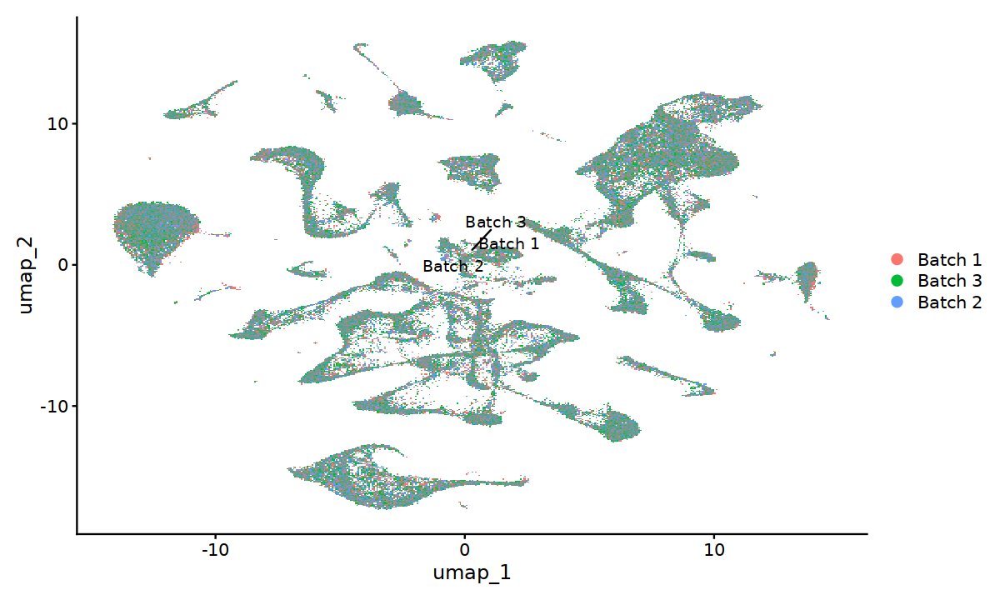

In [335]:
Idents(obj) <- obj %>% `[[` %>% pull(batch)
DimPlot(obj, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



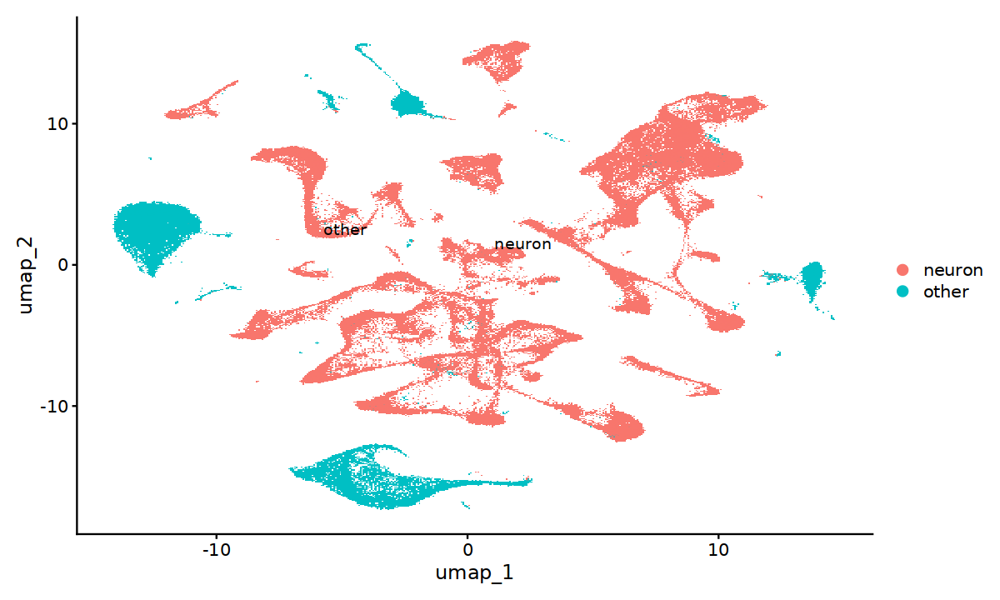

In [336]:
Idents(obj) <- obj %>% `[[` %>% pull(class)
DimPlot(obj, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



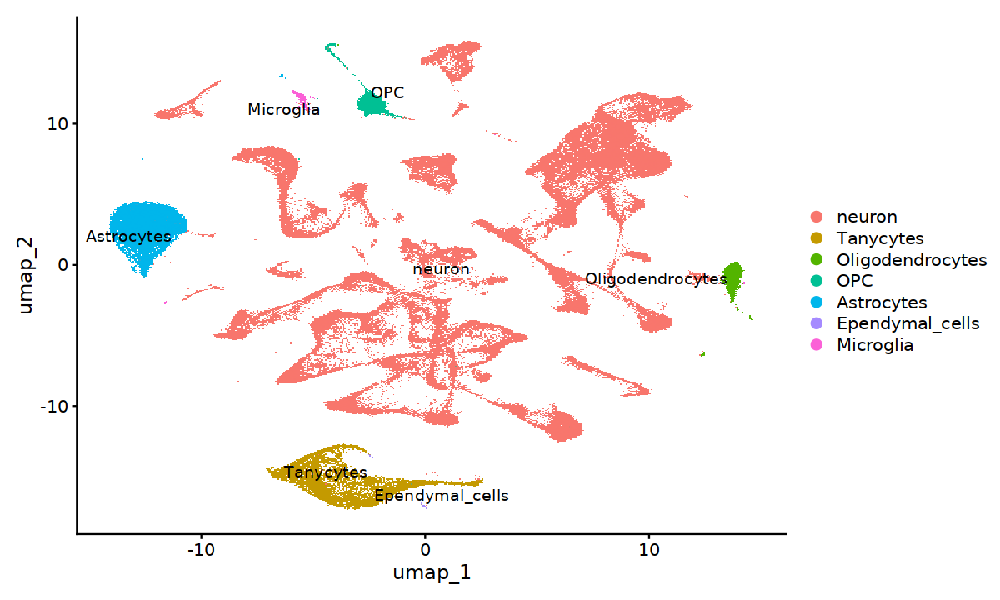

In [337]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



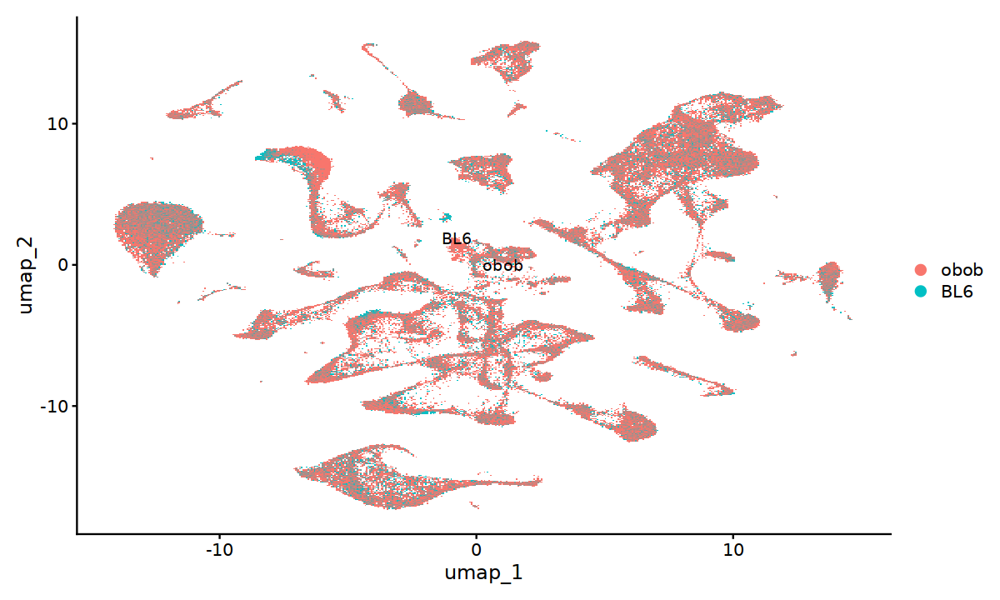

In [338]:
Idents(obj) <- obj %>% `[[` %>% pull(strain)
DimPlot(obj, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



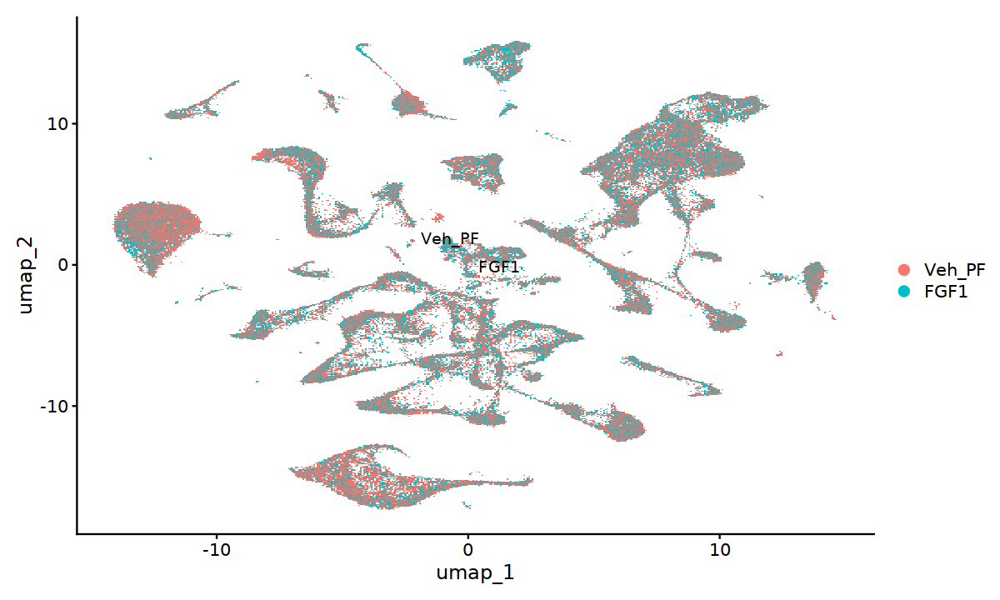

In [339]:
Idents(obj) <- obj %>% `[[` %>% pull(treatment)
DimPlot(obj, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



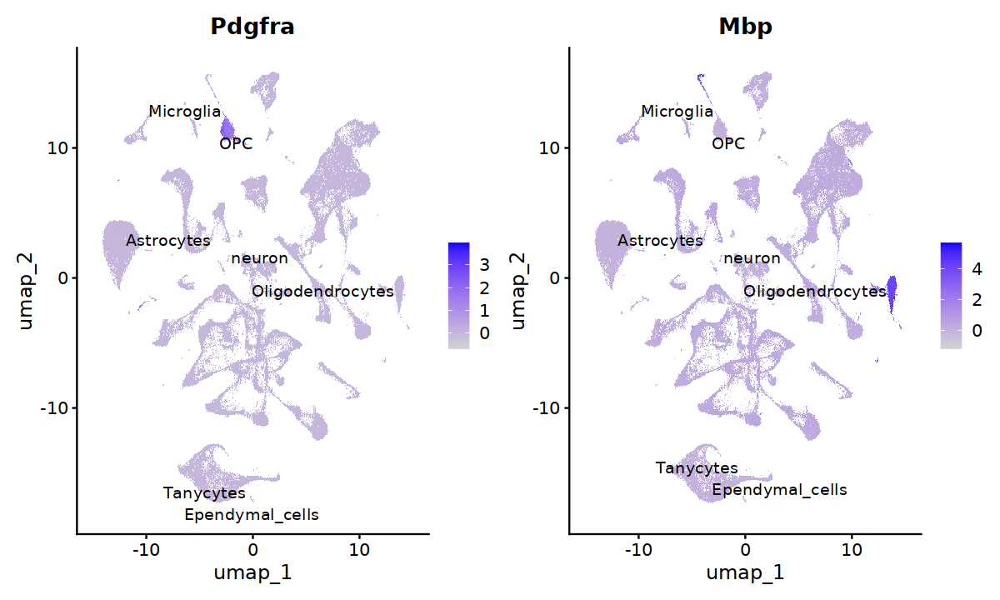

In [340]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=6)
FeaturePlot(obj, features=c("Pdgfra", "Mbp"), label=TRUE, repel=TRUE)

In [68]:
2

[1] 2

In [381]:
obj = qs::qread('_targets/objects/obj_cb_other') 
obj

An object of class Seurat 
29799 features across 33409 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

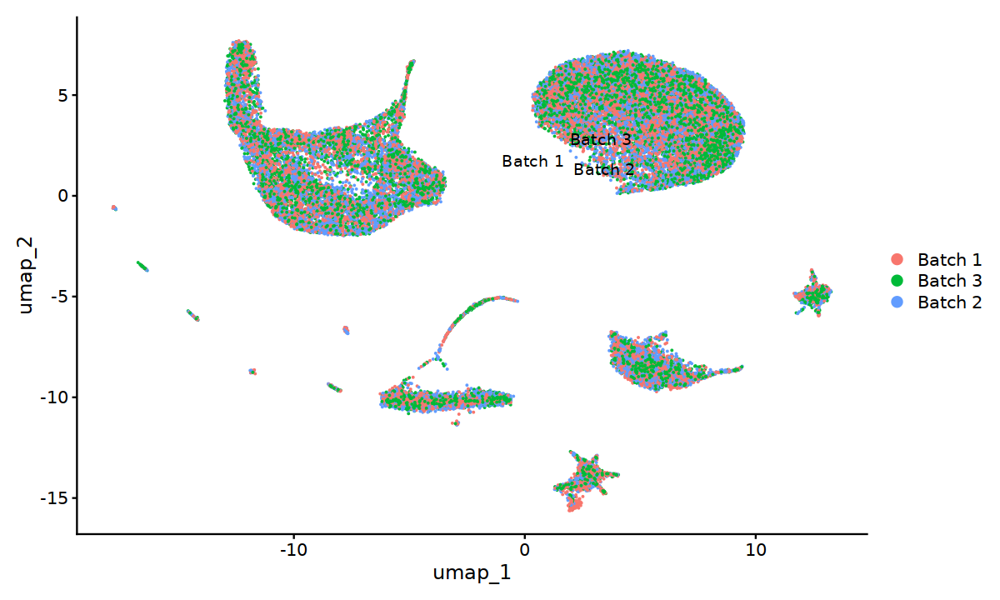

In [342]:
Idents(obj) <- obj %>% `[[` %>% pull(batch)
DimPlot(obj, reduction = "umap", label=T, repel = T)

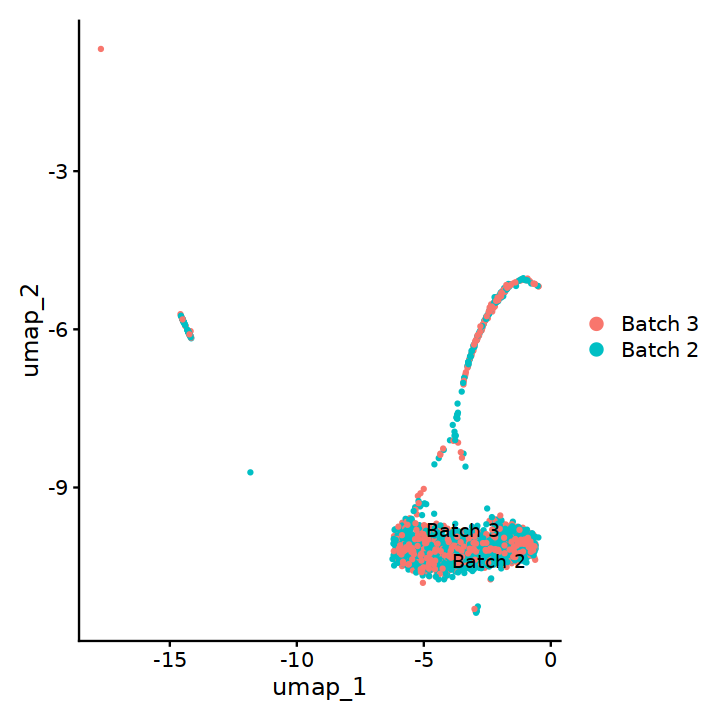

In [343]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% subset(subset = batch != 'Batch 1') %>%
subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

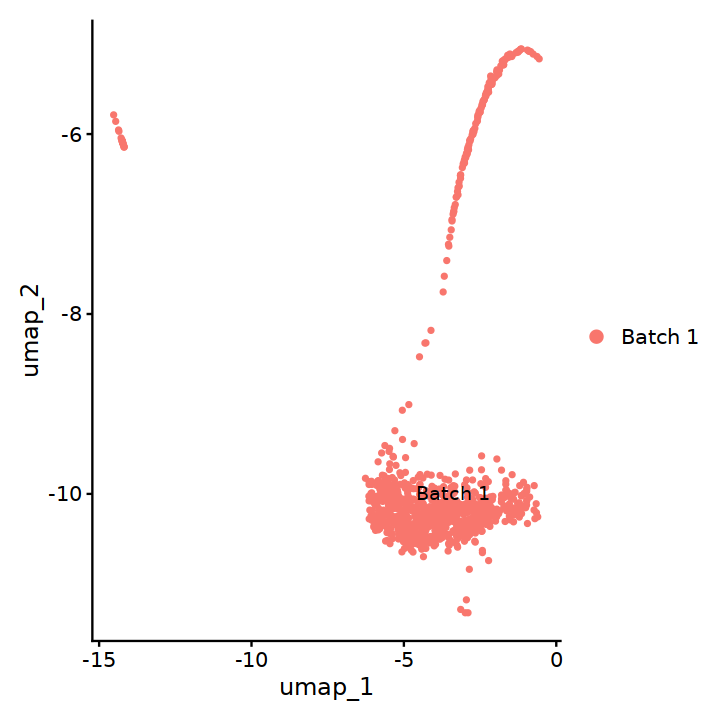

In [344]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% subset(subset = batch == 'Batch 1') %>%
subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

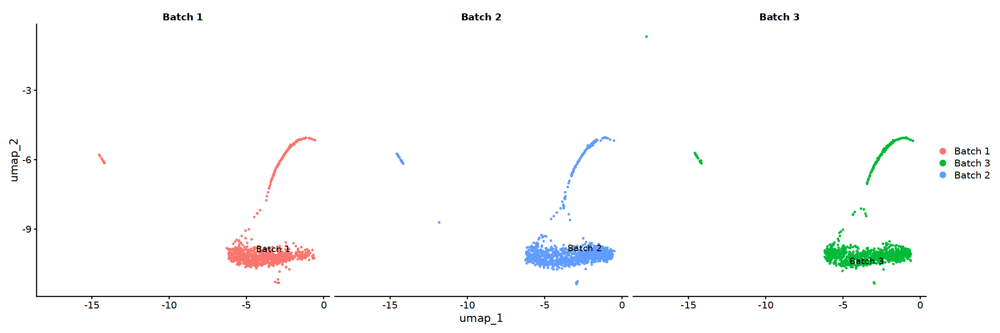

In [345]:
options(repr.plot.width=18, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% 
# subset(subset = batch == 'Batch 1') %>%
subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", split.by = 'batch', label=T, repel = T)

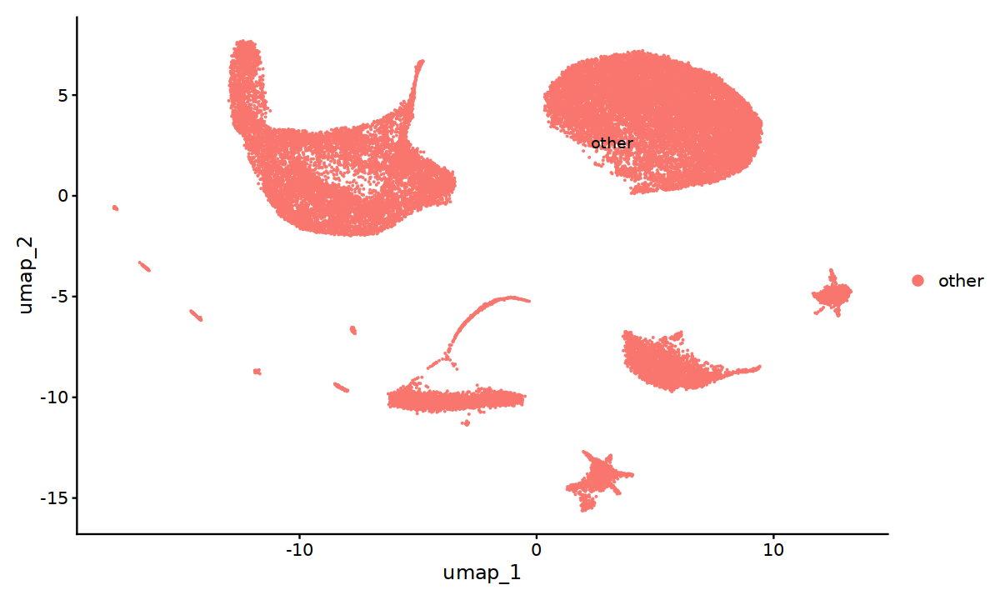

In [347]:
Idents(obj) <- obj %>% `[[` %>% pull(class)
DimPlot(obj, reduction = "umap", label=T, repel = T)

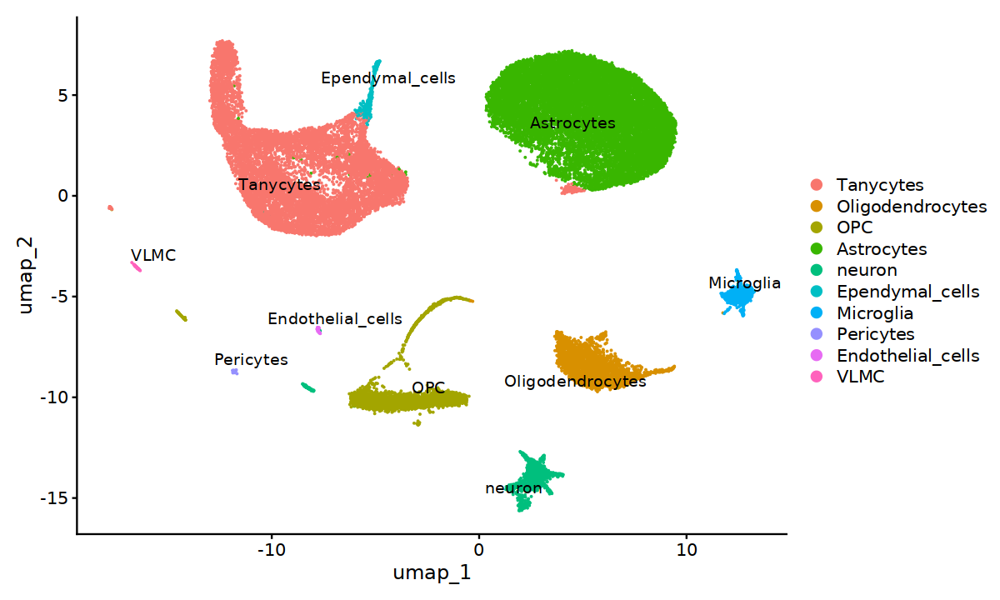

In [348]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj, reduction = "umap", label=T, repel = T)

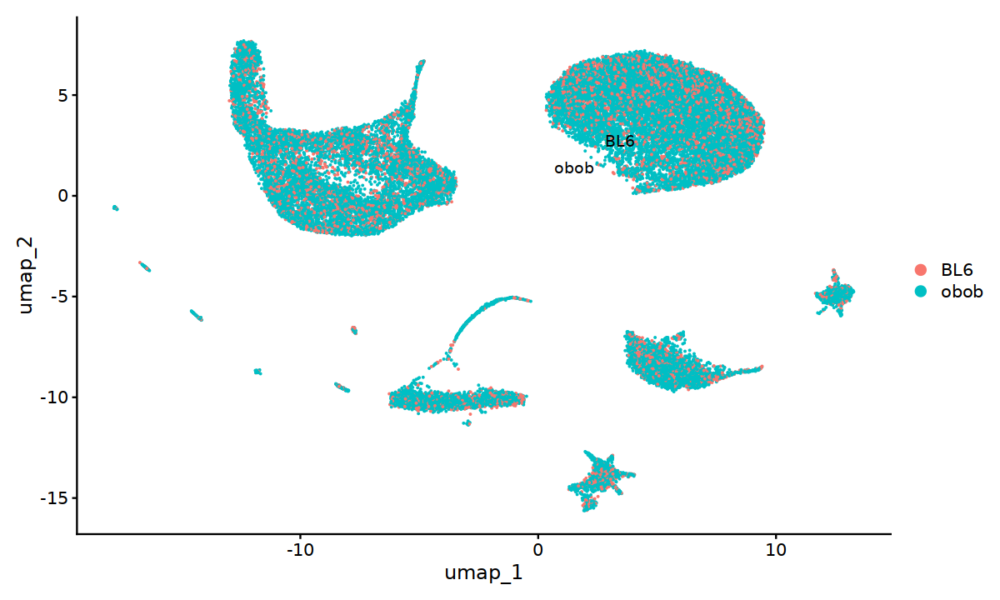

In [349]:
Idents(obj) <- obj %>% `[[` %>% pull(strain)
DimPlot(obj, reduction = "umap", label=T, repel = T)

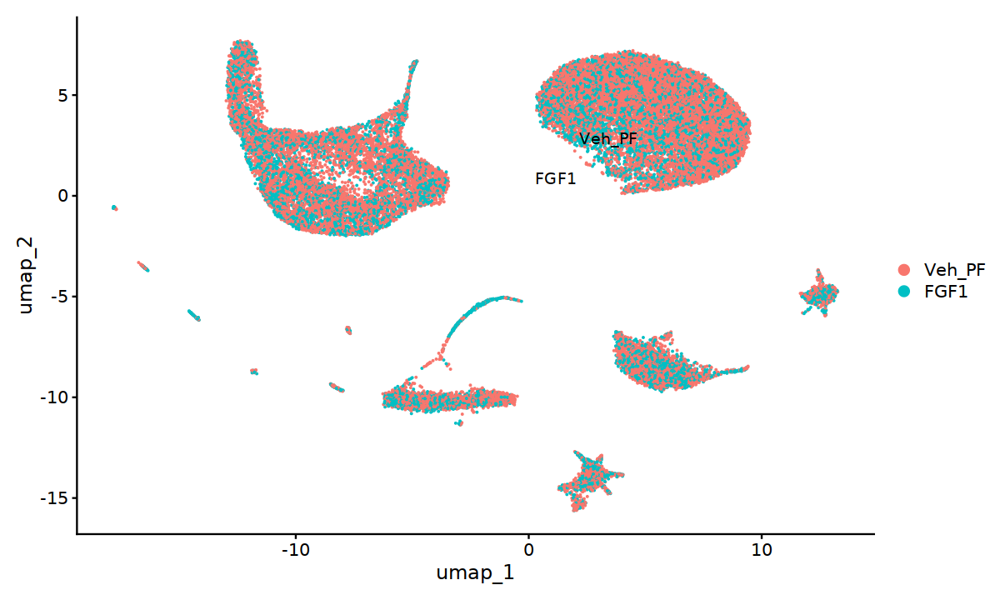

In [350]:
Idents(obj) <- obj %>% `[[` %>% pull(treatment)
DimPlot(obj, reduction = "umap", label=T, repel = T)

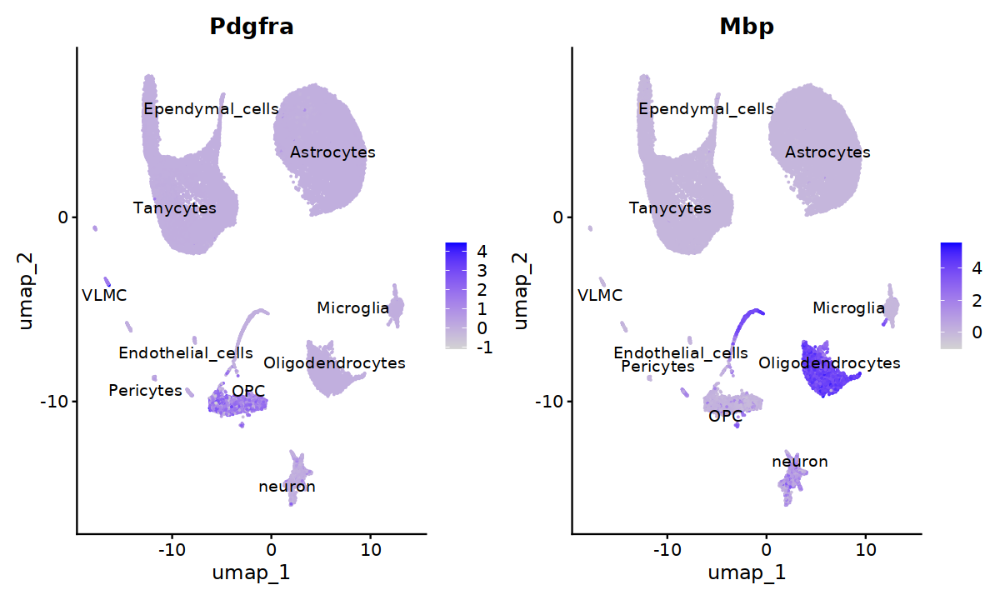

In [351]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=6)
FeaturePlot(obj, features=c("Pdgfra", "Mbp"), label=TRUE, repel=TRUE)

In [399]:
obj = qs::qread('_targets/objects/obj_cb_tany') 
obj

An object of class Seurat 
29799 features across 10262 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [416]:
#obj@assays$integrated@data #this is the lognorm equivalent

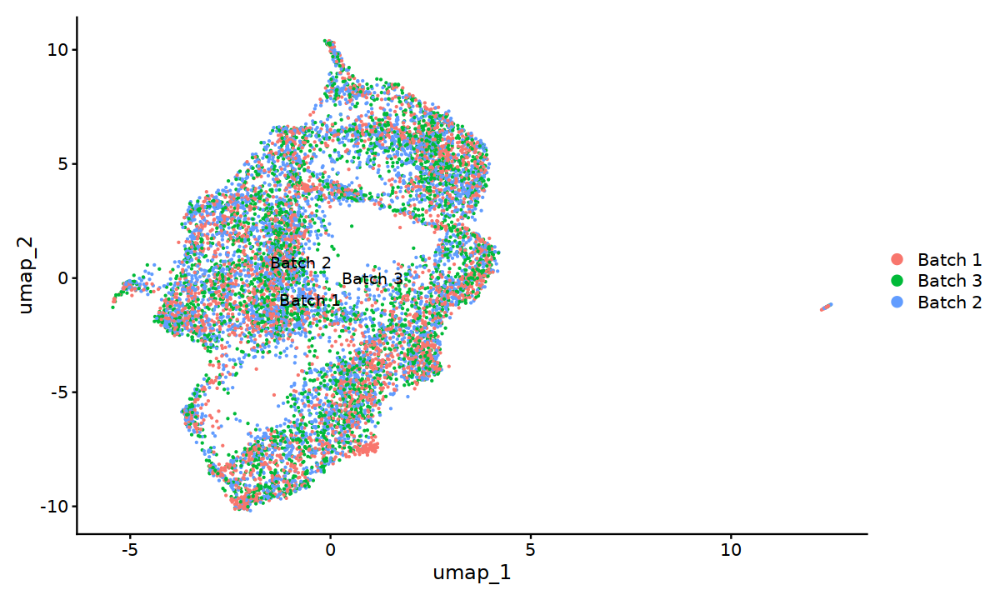

In [400]:
Idents(obj) <- obj %>% `[[` %>% pull(batch)
DimPlot(obj, reduction = "umap", label=T, repel = T)

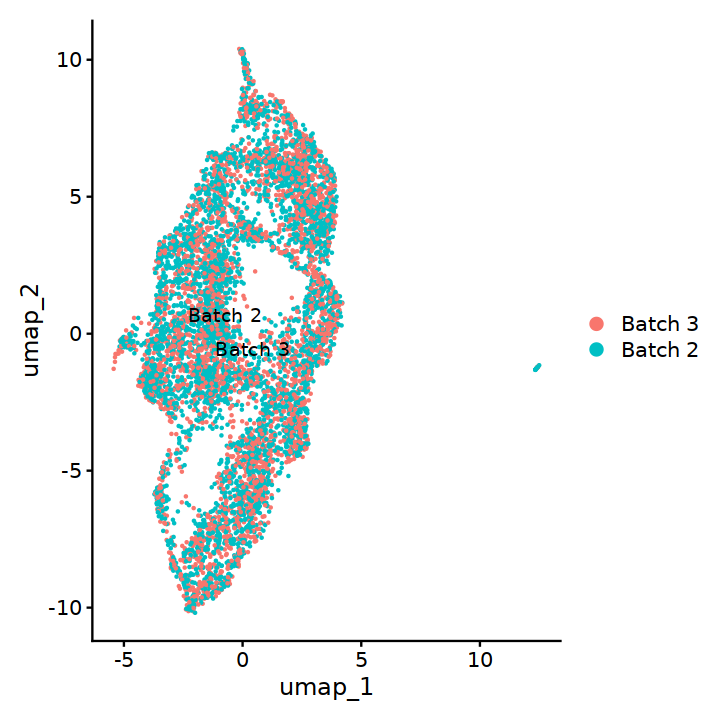

In [402]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% subset(subset = batch != 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

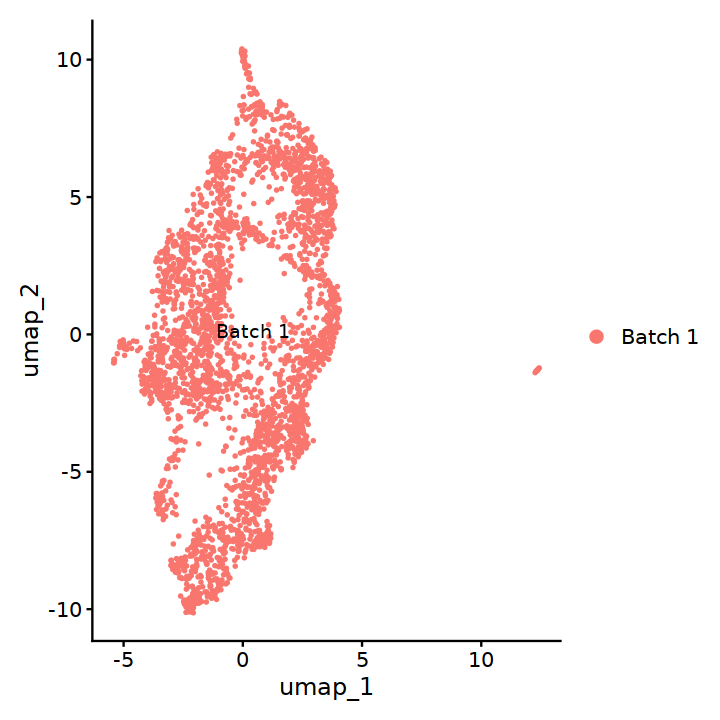

In [403]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% subset(subset = batch == 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

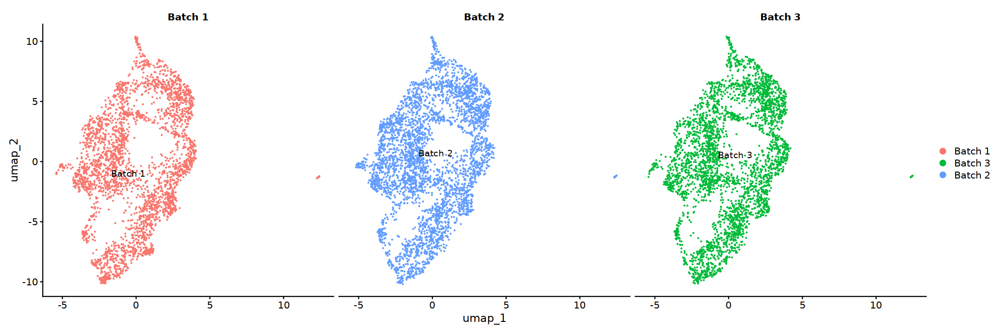

In [404]:
options(repr.plot.width=18, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% 
# subset(subset = batch == 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", split.by = 'batch', label=T, repel = T)

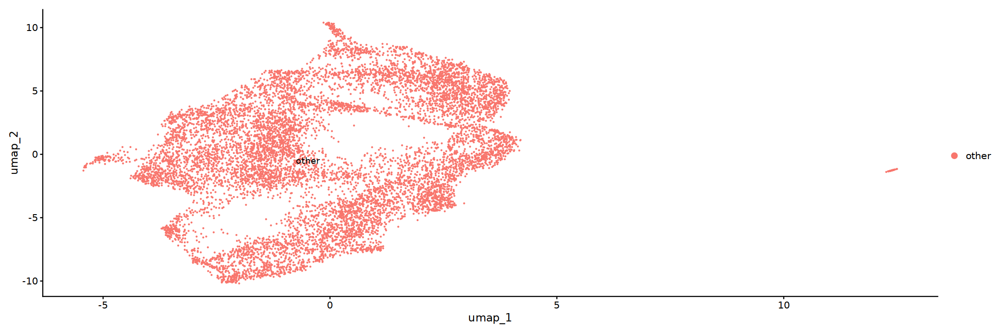

In [405]:
Idents(obj) <- obj %>% `[[` %>% pull(class)
DimPlot(obj, reduction = "umap", label=T, repel = T)

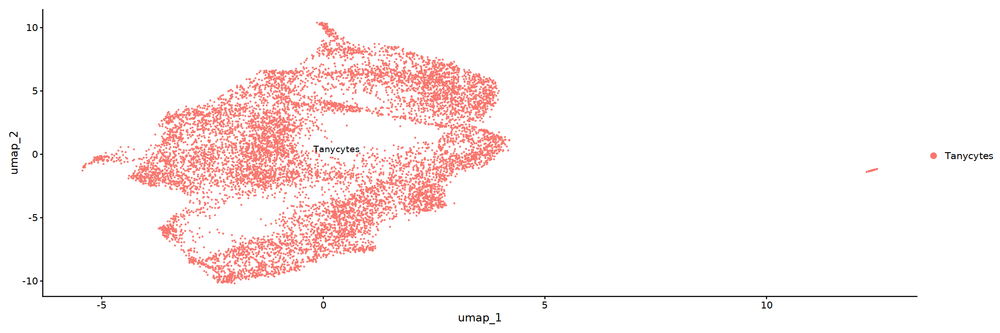

In [406]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj, reduction = "umap", label=T, repel = T)

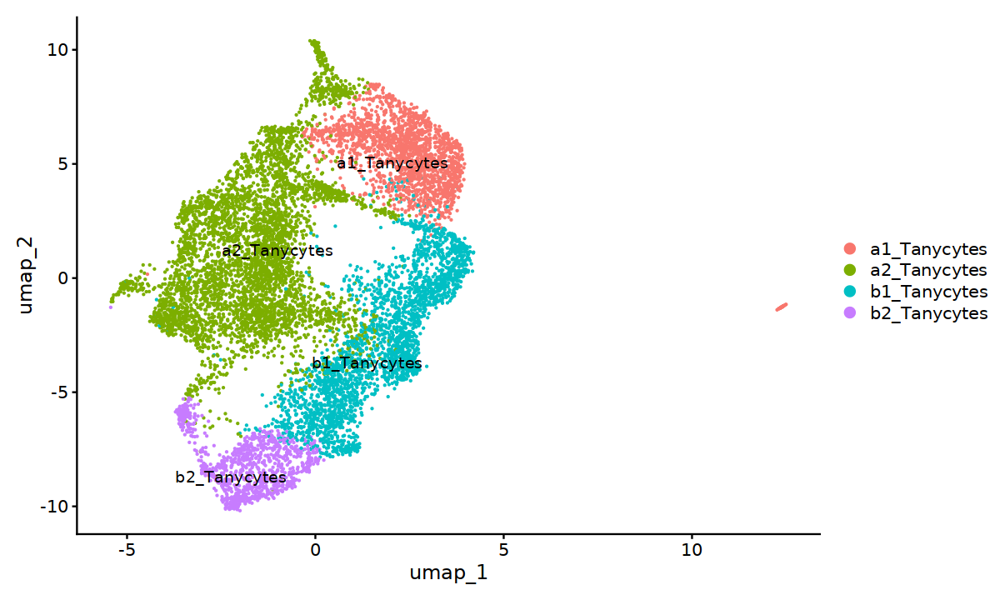

In [410]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl2)
DimPlot(obj, reduction = "umap", label=T, repel = T)

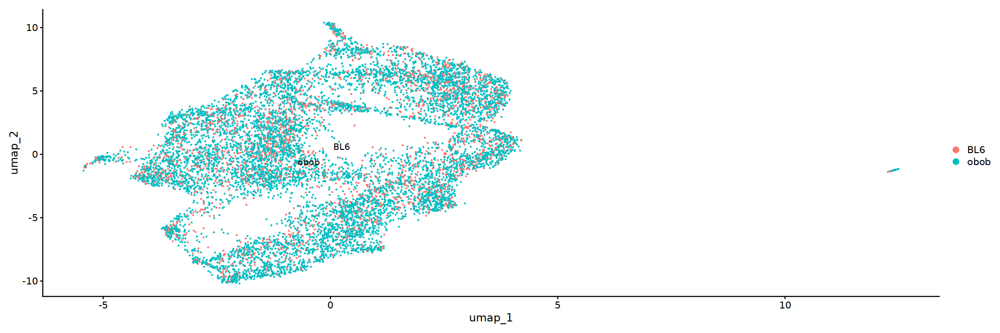

In [407]:
Idents(obj) <- obj %>% `[[` %>% pull(strain)
DimPlot(obj, reduction = "umap", label=T, repel = T)

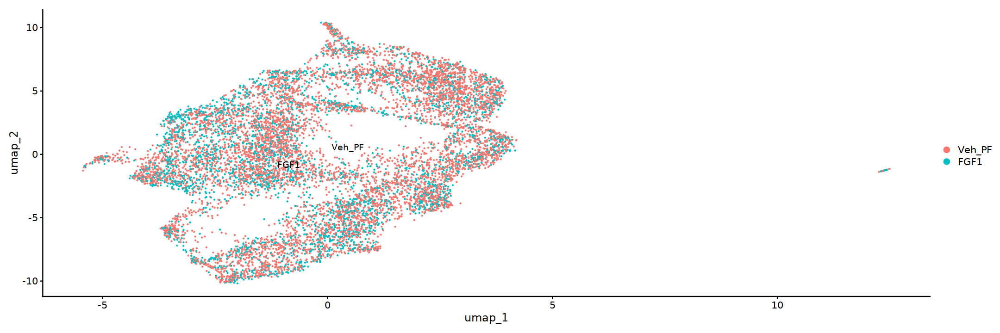

In [408]:
Idents(obj) <- obj %>% `[[` %>% pull(treatment)
DimPlot(obj, reduction = "umap", label=T, repel = T)

Warning message:
“Could not find Pdgfra in the default search locations, found in ‘RNA’ assay instead”
Warning message:
“Could not find Mbp in the default search locations, found in ‘RNA’ assay instead”


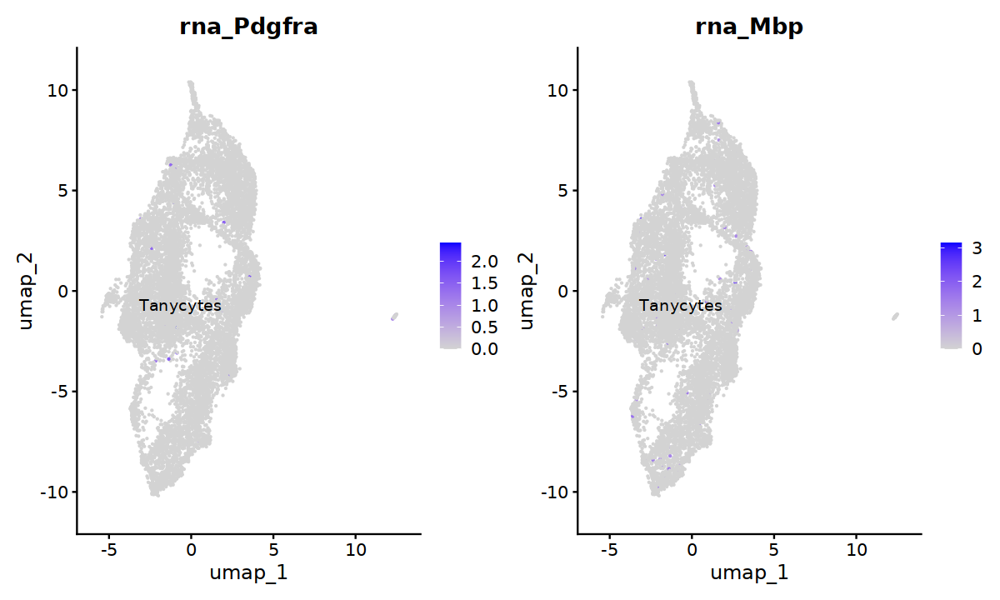

In [409]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=6)
FeaturePlot(obj, features=c("Pdgfra", "Mbp"), label=TRUE, repel=TRUE)

In [389]:
obj = qs::qread('_targets/objects/obj_cb_other_sct') 
obj

An object of class Seurat 
54956 features across 33409 samples within 3 assays 
Active assay: SCT (25157 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, integrated
 2 dimensional reductions calculated: pca, umap

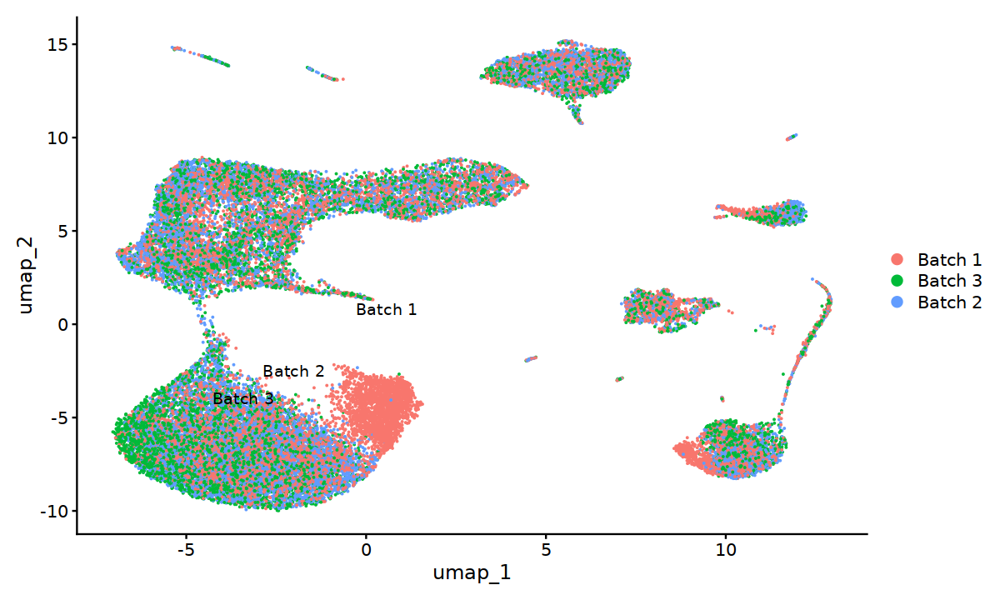

In [390]:
Idents(obj) <- obj %>% `[[` %>% pull(batch)
DimPlot(obj, reduction = "umap", label=T, repel = T)

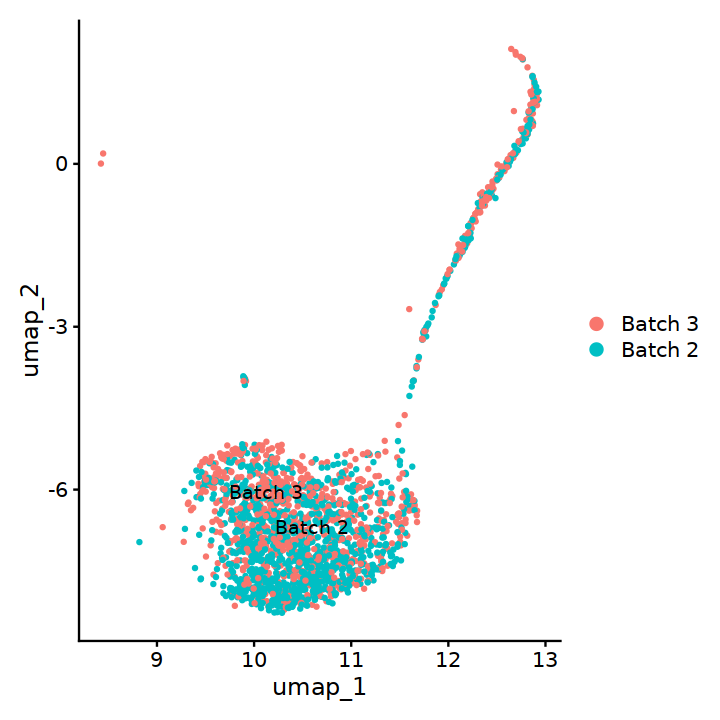

In [391]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% subset(subset = batch != 'Batch 1') %>%
subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

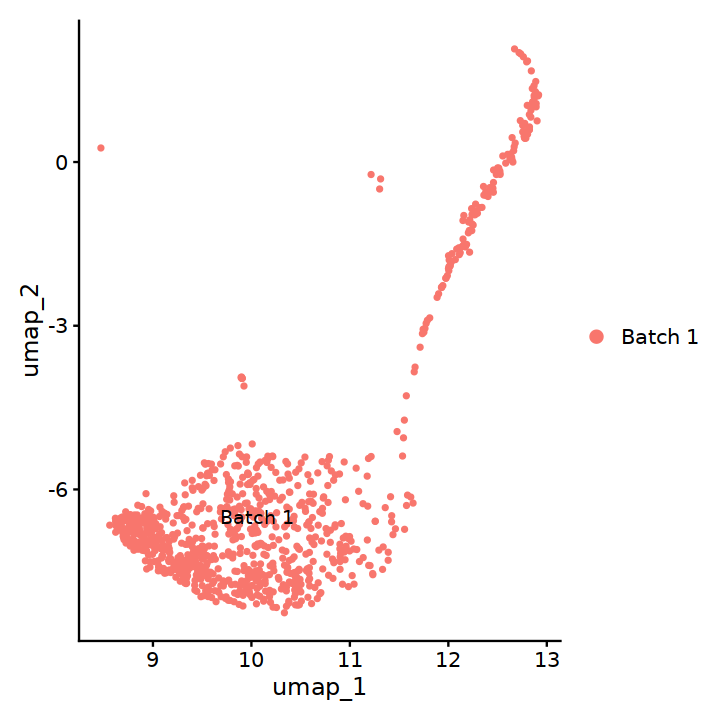

In [392]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% subset(subset = batch == 'Batch 1') %>%
subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

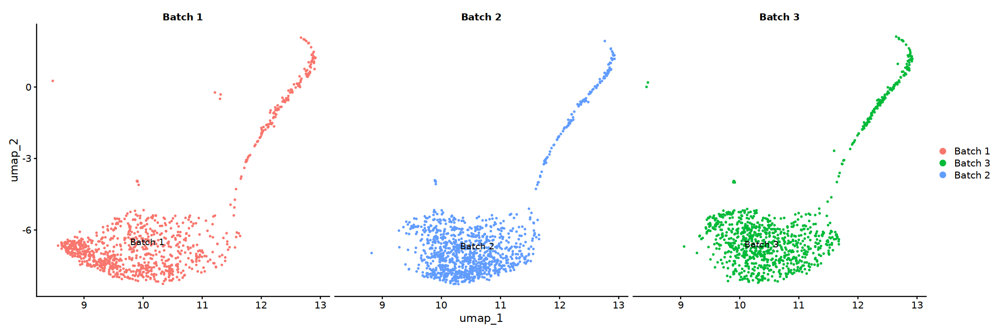

In [393]:
options(repr.plot.width=18, repr.plot.height=6)
Idents(obj) <- obj %>% `[[` %>% pull(batch)
obj %>% 
# subset(subset = batch == 'Batch 1') %>%
subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", split.by = 'batch', label=T, repel = T)

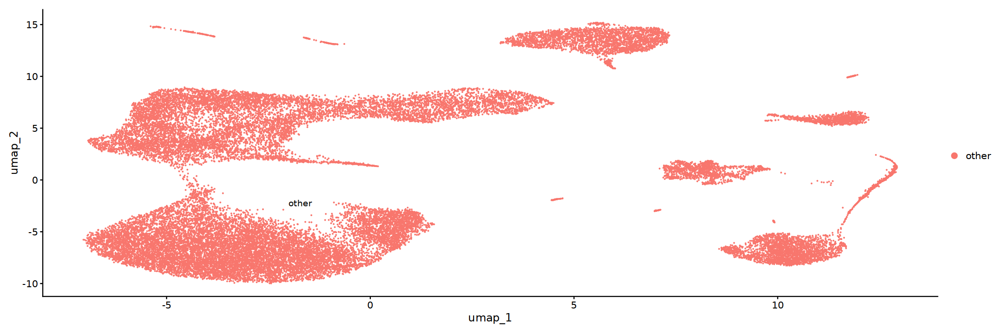

In [394]:
Idents(obj) <- obj %>% `[[` %>% pull(class)
DimPlot(obj, reduction = "umap", label=T, repel = T)

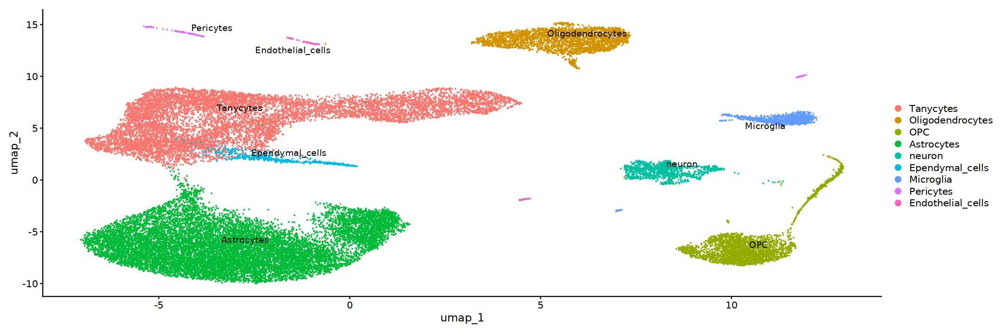

In [395]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj, reduction = "umap", label=T, repel = T)

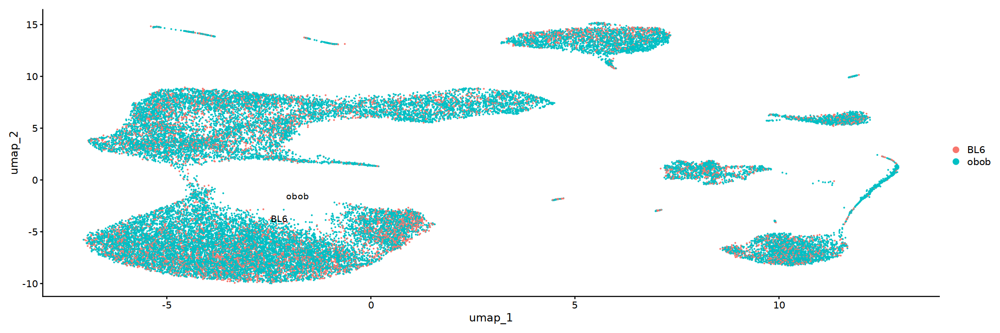

In [396]:
Idents(obj) <- obj %>% `[[` %>% pull(strain)
DimPlot(obj, reduction = "umap", label=T, repel = T)

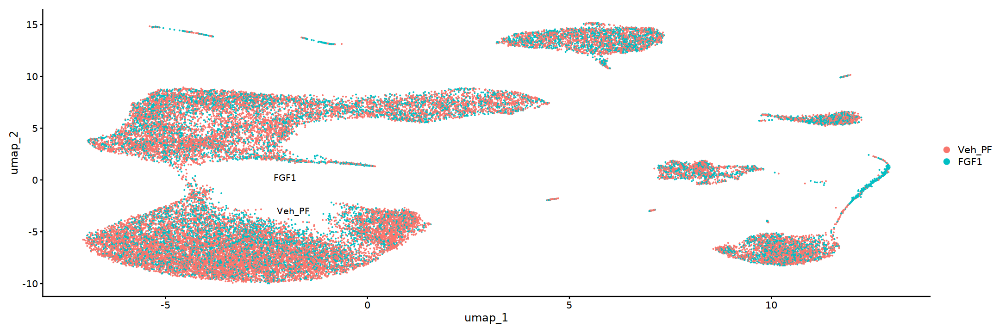

In [397]:
Idents(obj) <- obj %>% `[[` %>% pull(treatment)
DimPlot(obj, reduction = "umap", label=T, repel = T)

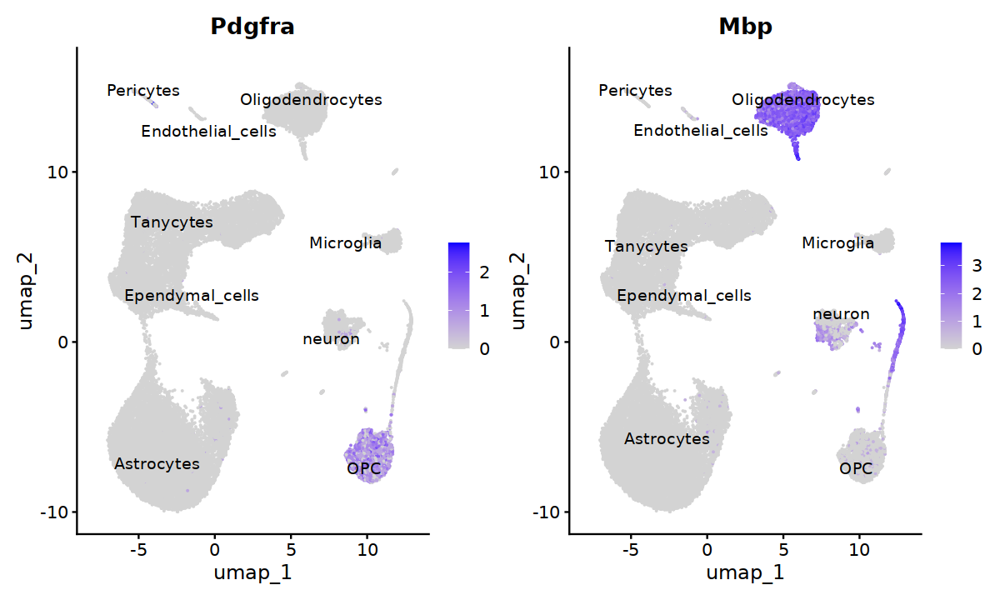

In [398]:
Idents(obj) <- obj %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=6)
FeaturePlot(obj, features=c("Pdgfra", "Mbp"), label=TRUE, repel=TRUE)

In [79]:
obj %>% `[[` %>% head

,orig.ident,nCount_RNA,nFeature_RNA,nCount_RNA_SCOP,nFeature_RNA_SCOP,Index.10x_SCOP,nCount_HTO_SCOP,nFeature_HTO_SCOP,Index.HTO_SCOP,nCount_spliced_SCOP,⋯,treatment,time,collection_date,isolation_date,batch,integrated_snn_res.0.5,seurat_clusters,class,integrated_snn_res.0.95,labels_lvl1
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<dbl>,<int>,<chr>,<dbl>,⋯,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<fct>,<chr>,<fct>,<fct>
SI-TT-A11_AAACCCAGTATCGGTT,SI-TT-A11,1530,1173,4761,2296,SI-TT-A11,1150,12,D706,944,⋯,Veh_PF,Day14,220407,22/6/2022,Batch 1,2,6,other,6,Tanycytes
SI-TT-A11_AAACGAAAGCAACAAT,SI-TT-A11,1064,740,2640,1296,SI-TT-A11,797,12,D706,604,⋯,Veh_PF,Day14,220407,22/6/2022,Batch 1,21,4,other,4,Oligodendrocytes
SI-TT-A11_AAACGAAAGGTTCTTG,SI-TT-A11,1934,1262,7617,2701,SI-TT-A11,788,12,D706,1178,⋯,Veh_PF,Day5,220329,22/6/2022,Batch 1,22,9,other,9,OPC
SI-TT-A11_AAACGAACAAGGAGTC,SI-TT-A11,4798,2304,12026,3374,SI-TT-A11,1753,12,D706,2248,⋯,FGF1,Day14,220131,22/6/2022,Batch 1,0,3,other,3,Astrocytes
SI-TT-A11_AAACGAACAGCCTTCT,SI-TT-A11,2783,1648,8725,2985,SI-TT-A11,1667,12,D706,1694,⋯,Veh_PF,Day14,220201,22/6/2022,Batch 1,0,3,other,3,Astrocytes
SI-TT-A11_AAACGCTAGTGCTAGG,SI-TT-A11,1243,937,3580,1882,SI-TT-A11,991,12,D706,774,⋯,Veh_PF,Day5,220329,22/6/2022,Batch 1,2,6,other,6,Tanycytes


In [83]:
obj %>% `[[` %>% colnames

[1] "orig.ident"                         "nCount_RNA"                        
 [3] "nFeature_RNA"                       "nCount_RNA_SCOP"                   
 [5] "nFeature_RNA_SCOP"                  "Index.10x_SCOP"                    
 [7] "nCount_HTO_SCOP"                    "nFeature_HTO_SCOP"                 
 [9] "Index.HTO_SCOP"                     "nCount_spliced_SCOP"               
[11] "nFeature_spliced_SCOP"              "nCount_unspliced_SCOP"             
[13] "nFeature_unspliced_SCOP"            "HTO_mcl_maxID_SCOP"                
[15] "HTO_mcl_secondID_SCOP"              "HTO_mcl_margin_SCOP"               
[17] "HTO_mcl_classification_SCOP"        "HTO_mcl_classification.global_SCOP"
[19] "hash.mcl.ID_SCOP"                   "doublet_SCOP"                      
[21] "predicted_dub_std_SCOP"             "predicted_dub_cut_SCOP"            
[23] "barcode_SCOP"                       "Index.10x"                         
[25] "barcode"                            "strain"                            
[27] "treatment"                          "time"                              
[29] "collection_date"                    "isolation_date"                    
[31] "batch"                              "integrated_snn_res.0.5"            
[33] "seurat_clusters"                    "class"                             
[35] "integrated_snn_res.0.95"            "labels_lvl1"

In [105]:
obj %>% `[[` %>% pull(hash.mcl.ID_SCOP) %>% unique %>% length

[1] 36

In [92]:
obj %>% `[[` %>% pull(HTO_mcl_margin_SCOP) %>% head

[1] 0.9083997 0.8681029 0.5654255 0.9492949 0.9650986 0.8958886

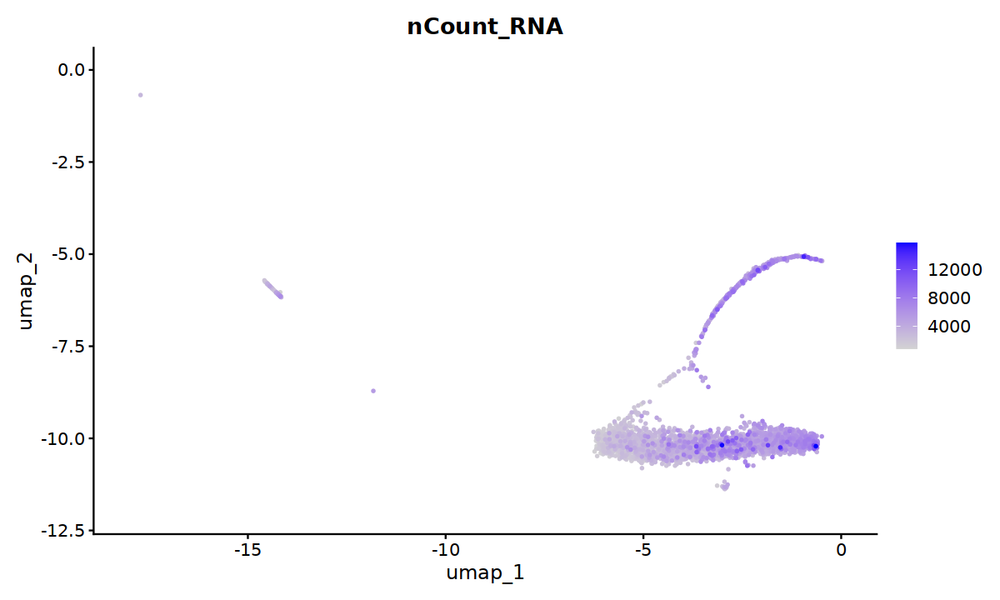

In [352]:
obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
FeaturePlot('nCount_RNA', order = TRUE)


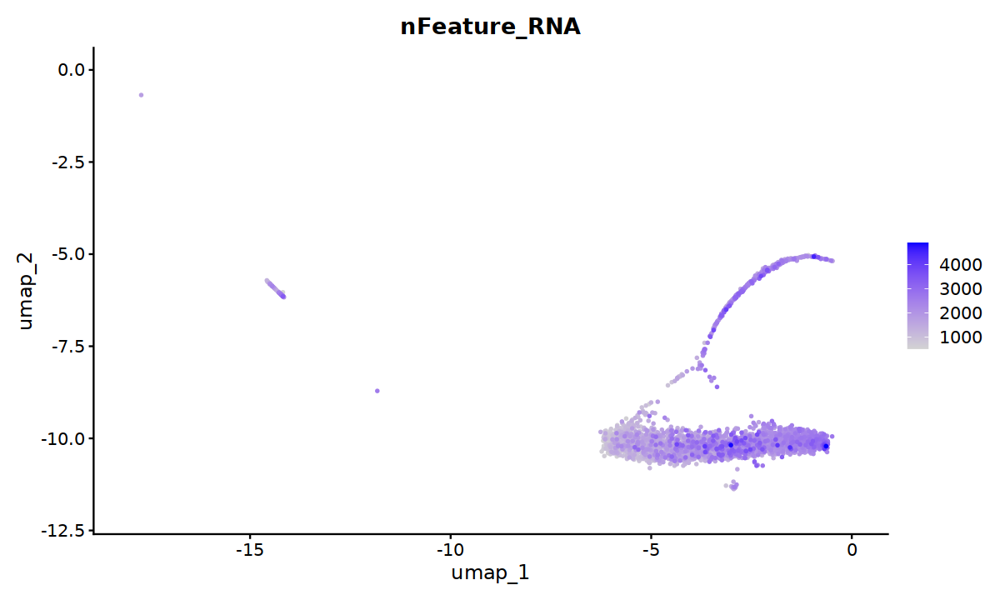

In [353]:
obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
FeaturePlot('nFeature_RNA', order = TRUE)


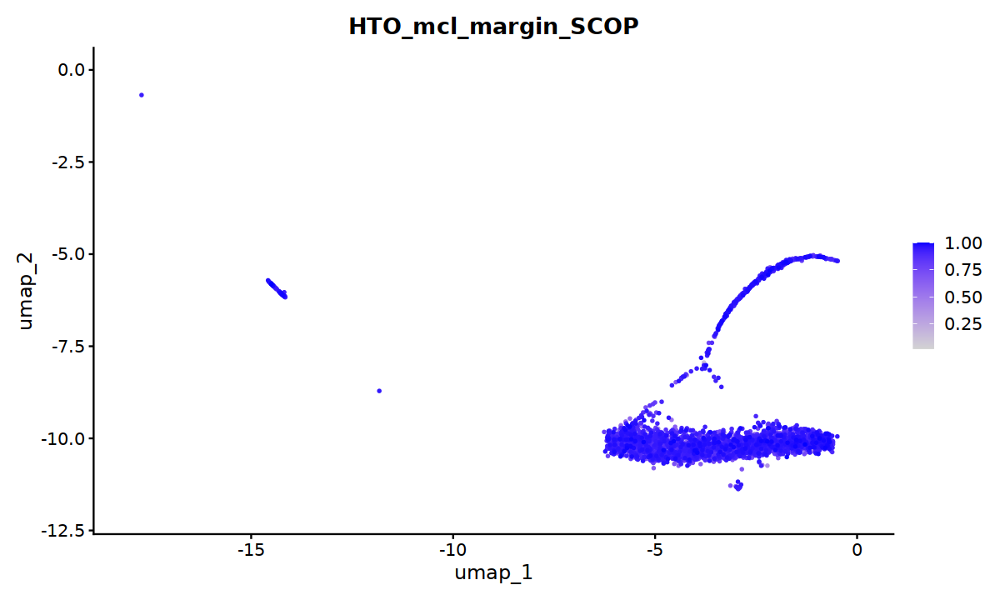

In [354]:

obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
# subset(subset = HTO_mcl_margin_SCOP < 0.5) %>%
FeaturePlot('HTO_mcl_margin_SCOP', order = TRUE)


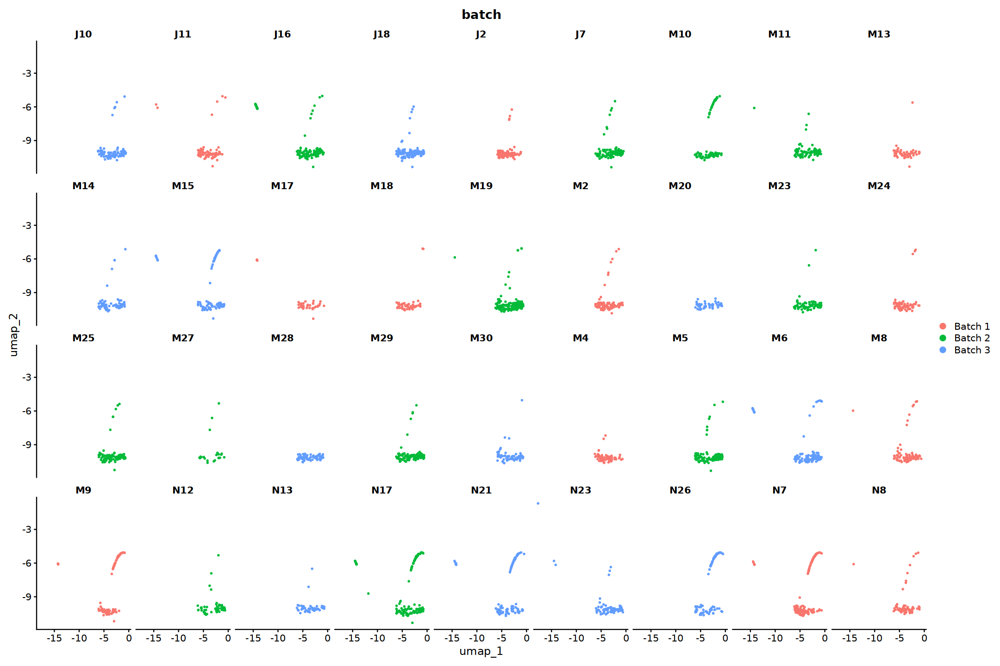

In [355]:
options(repr.plot.width=18, repr.plot.height=12)
obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
# subset(subset = HTO_mcl_margin_SCOP < 0.5) %>%
DimPlot(split.by = 'hash.mcl.ID_SCOP', group.by='batch', ncol=9)


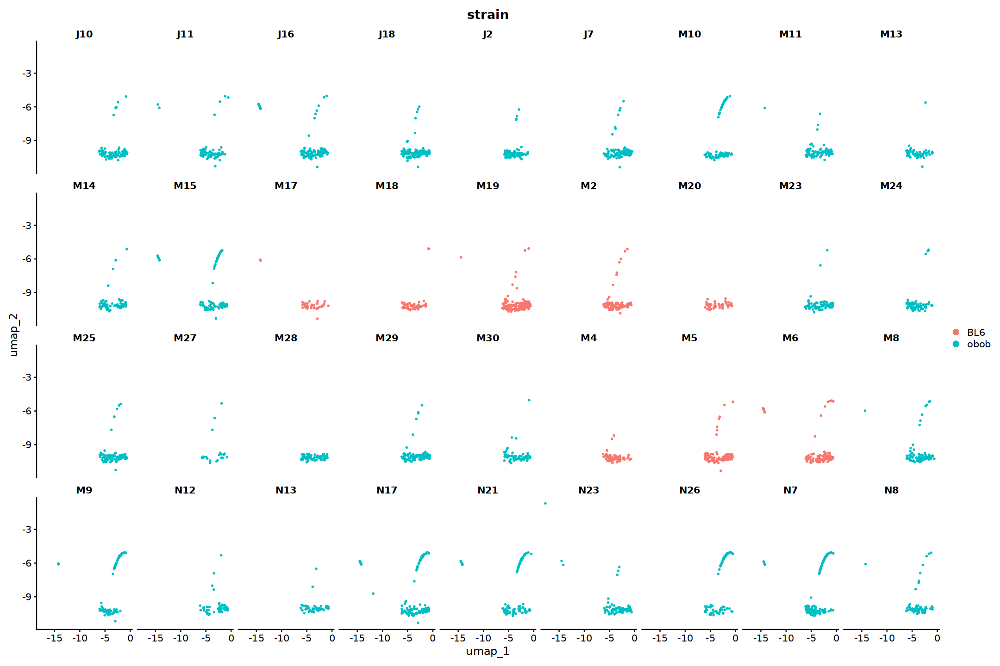

In [356]:
options(repr.plot.width=18, repr.plot.height=12)
obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
# subset(subset = HTO_mcl_margin_SCOP < 0.5) %>%
DimPlot(split.by = 'hash.mcl.ID_SCOP', group.by='strain', ncol=9)


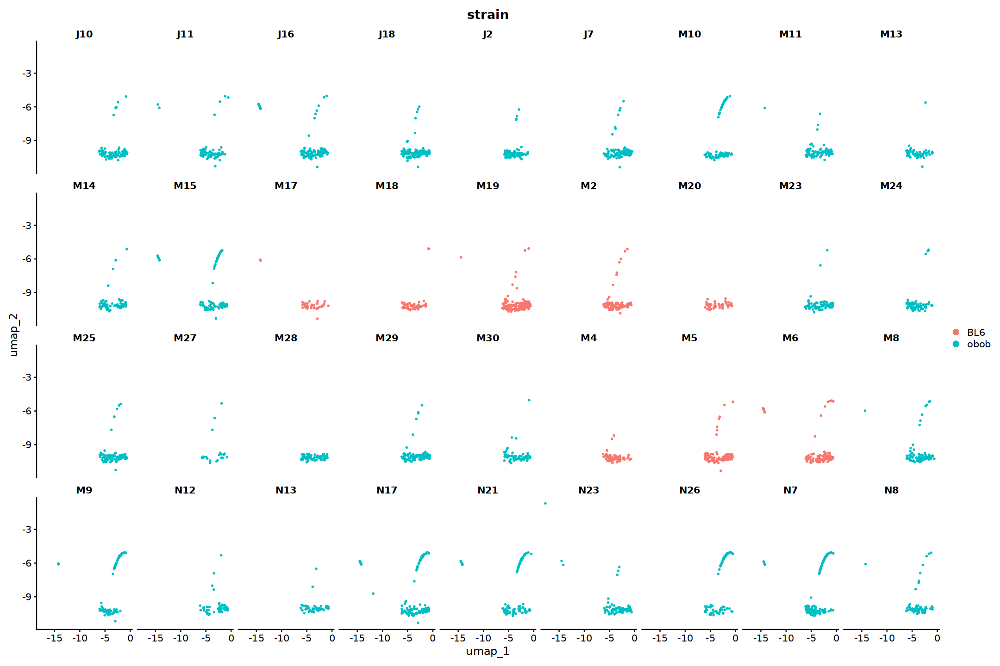

In [357]:
options(repr.plot.width=18, repr.plot.height=12)
obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
# subset(subset = HTO_mcl_margin_SCOP < 0.5) %>%
DimPlot(split.by = 'hash.mcl.ID_SCOP', group.by='strain', ncol=9)


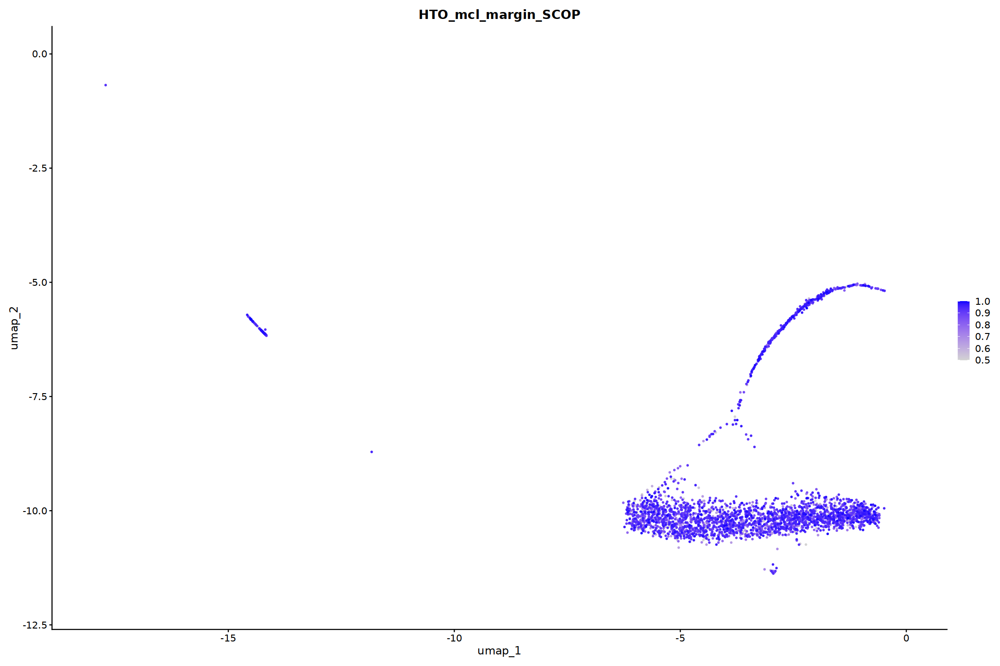

In [358]:

obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
# subset(subset = HTO_mcl_margin_SCOP < 0.5) %>%
FeaturePlot('HTO_mcl_margin_SCOP', order = TRUE, min.cutoff = 0.5)


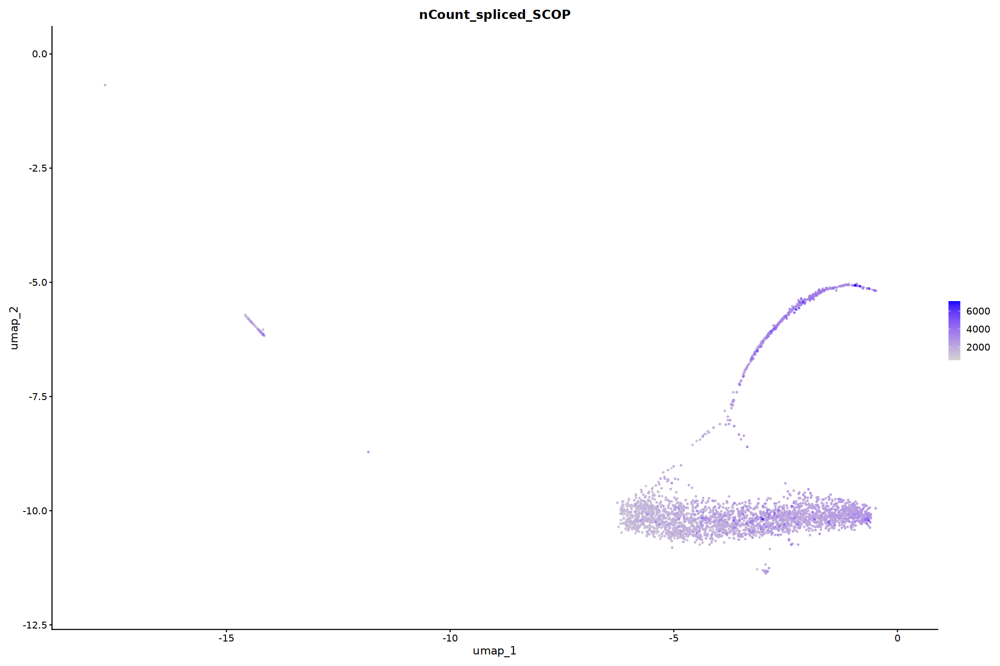

In [359]:

obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
# subset(subset = HTO_mcl_margin_SCOP < 0.5) %>%
FeaturePlot('nCount_spliced_SCOP', order = TRUE)


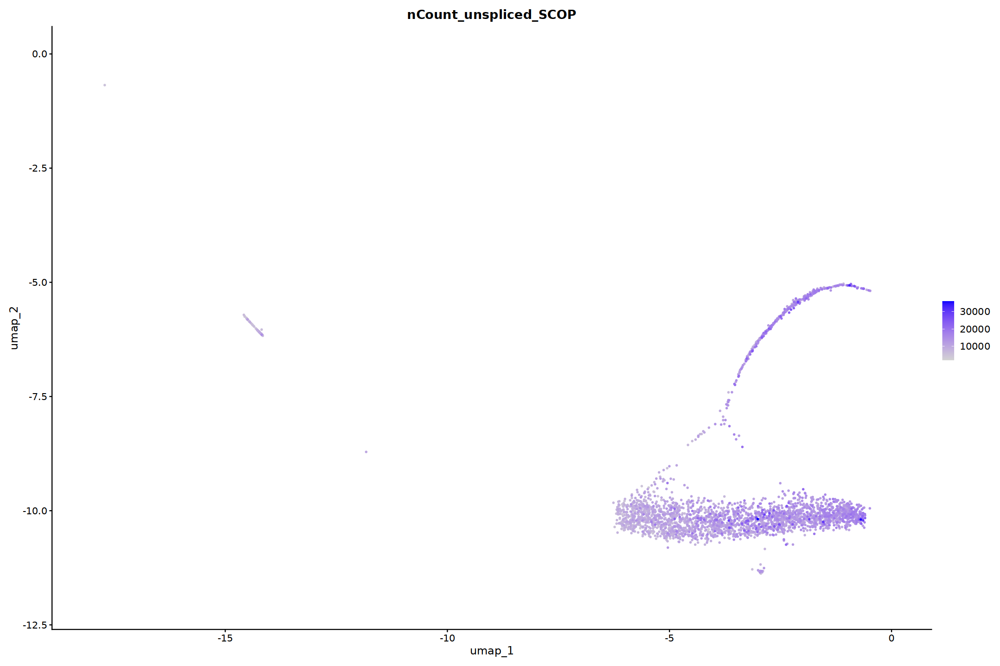

In [360]:

obj %>%
subset(subset = labels_lvl1 == 'OPC') %>%
# subset(subset = HTO_mcl_margin_SCOP < 0.5) %>%
FeaturePlot('nCount_unspliced_SCOP', order = TRUE)


In [116]:
source('../00_preprocessing/preprocessing.R')

In [117]:
obj_sct = obj %>% sc_transform_fgf1 %>% run_sct_chaser
obj_sct

Running SCTransform on assay: RNA

Running SCTransform on layer: counts

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 25184 by 33540

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 5000 cells

Found 388 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 25184 genes

Computing corrected count matrix for 25184 genes

Calculating gene attributes

Wall clock passed: Time difference of 15.34606 mins

Determine variable features

Regressing out batch

Centering data matrix

Getting residuals for block 1(of 7) for counts dataset

Getting residuals for block 2(of 7) for counts dataset

Getting residuals for block 3(of 7) for counts dataset

Getting residuals for block 4(of 7) for counts dataset

Getting residuals for block 5(of 7) for counts dataset

Getting residuals for block

An object of class Seurat 
54983 features across 33540 samples within 3 assays 
Active assay: SCT (25184 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, integrated
 2 dimensional reductions calculated: pca, umap

In [124]:
options(repr.plot.width=6, repr.plot.height=6)

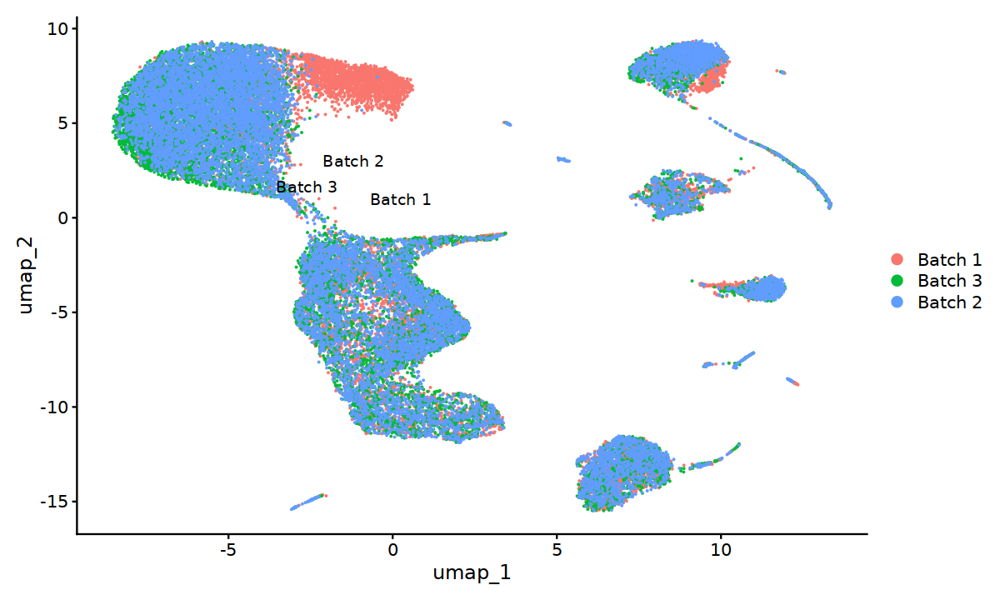

In [131]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(batch)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

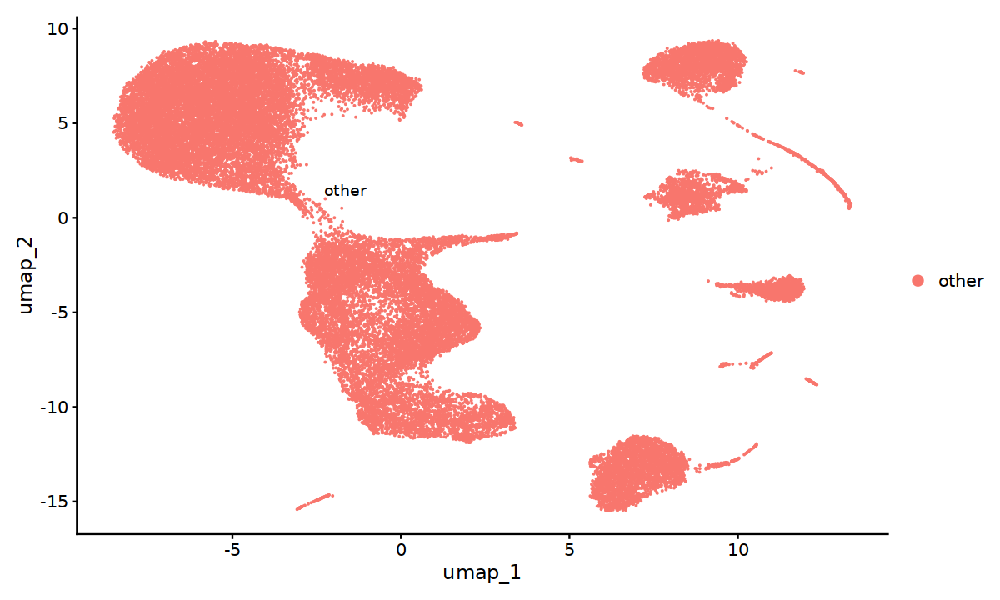

In [132]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(class)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

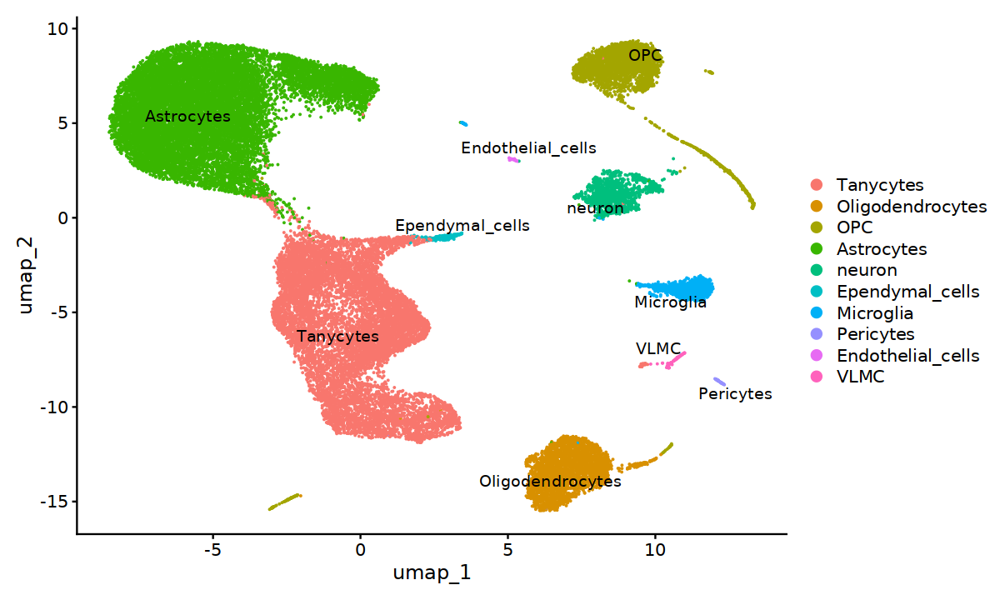

In [133]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

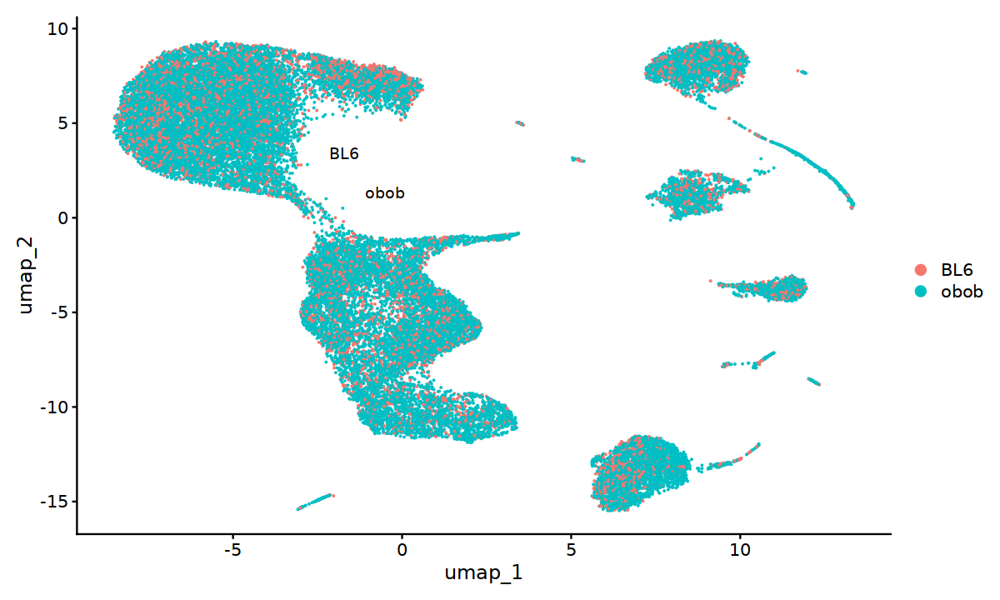

In [134]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(strain)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

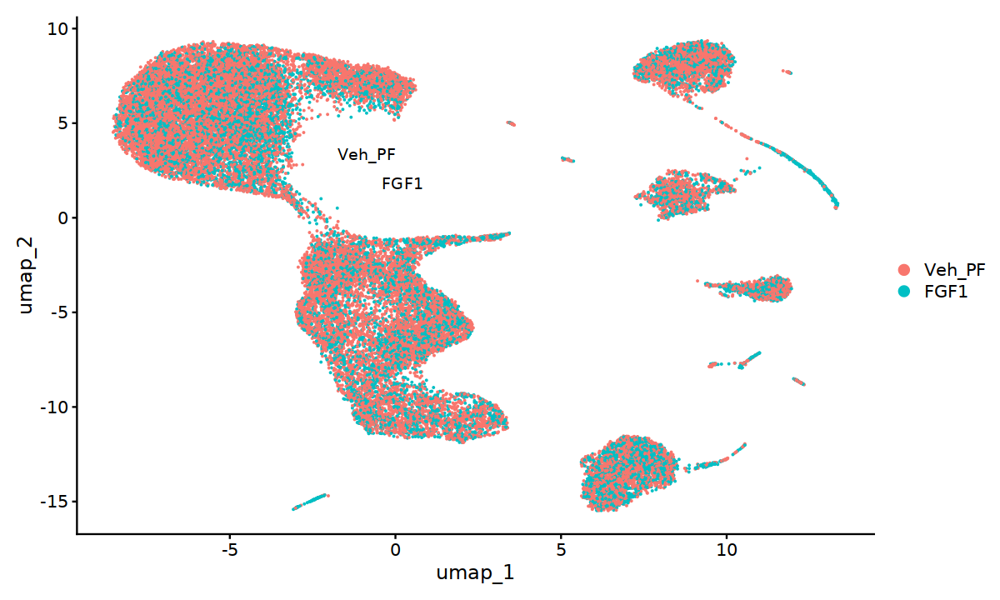

In [135]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(treatment)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

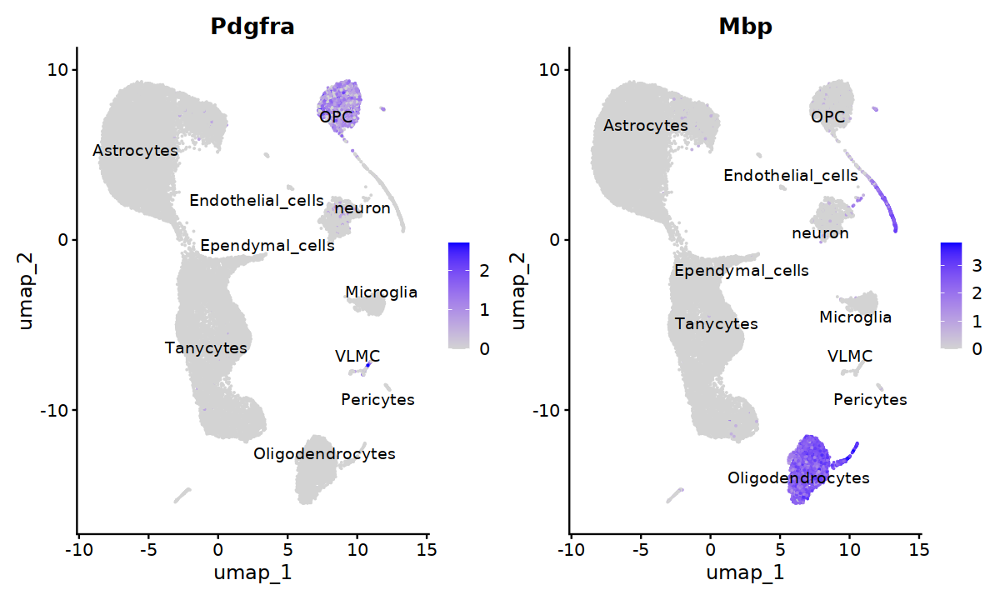

In [136]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=6)
FeaturePlot(obj_sct, features=c("Pdgfra", "Mbp"), label=TRUE, repel=TRUE)

In [314]:
obj_sct = obj %>% 
subset(subset = labels_lvl1 == 'Oligodendrocytes') %>% 
# sc_transform_fgf1 %>% run_sct_chaser
process_seurat(method = "integrate", batch ="Index.10x_SCOP", dims = 10, res = 0.95, k.weight=50)
obj_sct

Normalizing layer: counts

Finding variable features for layer counts

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at -2.3468”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 0.49965”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 0.090619”
Normalizing layer: counts

Finding variable features for layer counts

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at -1.9058”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 0.30103”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal cond

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2815
Number of edges: 104005

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7609
Number of communities: 13
Elapsed time: 0 seconds


An object of class Seurat 
29799 features across 2815 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

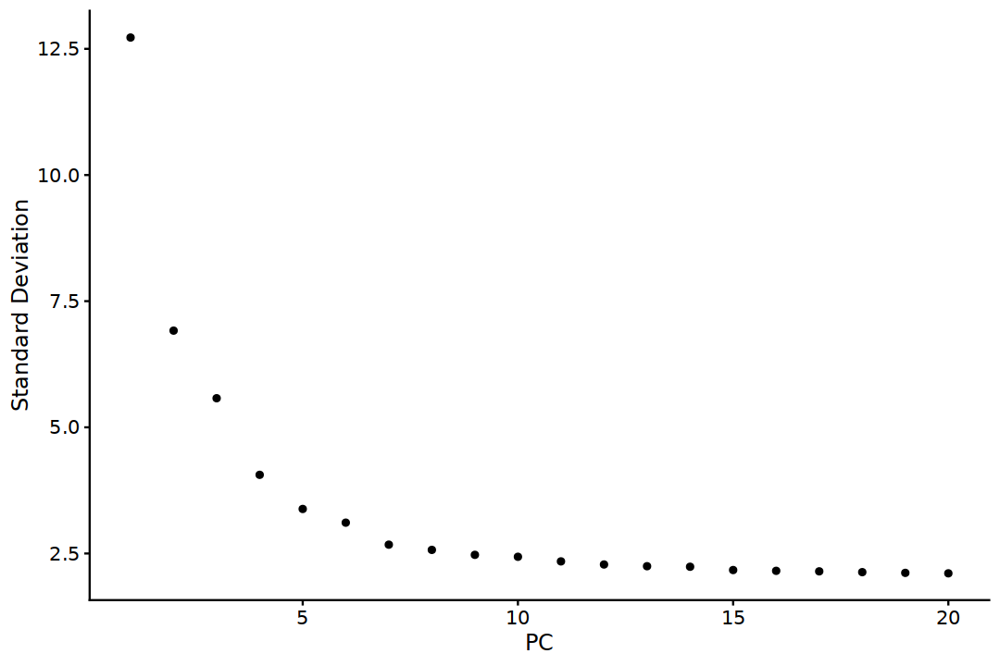

In [315]:
obj_sct %>% ElbowPlot

In [316]:
obj %>% `[[` %>% rownames_to_column %>% distinct(rowname, Index.10x_SCOP) %>%
group_by(Index.10x_SCOP) %>%
summarise(n = n())

Index.10x_SCOP,n
<chr>,<int>
SI-TT-A11,2163
SI-TT-A12,2169
SI-TT-B12,2087
SI-TT-C11,2499
SI-TT-C12,2357
SI-TT-D11,2609
SI-TT-E10,1284
SI-TT-E11,2314
SI-TT-E12,2183


In [317]:
obj

An object of class Seurat 
29799 features across 33540 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [318]:
options(tibble.width = Inf)
options(width = 200) 
obj_sct %>% `[[` %>% rownames_to_column %>% select(rowname, Index.10x_SCOP, nCount_RNA, nFeature_RNA) %>%
group_by(Index.10x_SCOP) %>%
mutate(total_cells = n(),
       sum_RNA = sum(nCount_RNA),
       sum_Feature = sum(nFeature_RNA)) %>%
mutate(sum_RNA_per_cell = sum_RNA/total_cells,
       sum_Feature_per_cells = sum_Feature/total_cells) %>%
distinct(Index.10x_SCOP, sum_RNA, sum_Feature, total_cells, sum_RNA_per_cell, sum_Feature_per_cells) %>% 
arrange(desc(sum_Feature_per_cells)) %>%
print(n=Inf)

# A tibble: 15 × 6
# Groups:   Index.10x_SCOP [15]
   Index.10x_SCOP sum_RNA sum_Feature total_cells sum_RNA_per_cell sum_Feature_per_cells
   <chr>            <dbl>       <int>       <int>            <dbl>                 <dbl>
 1 SI-TT-E10       575209      289207         161            3573.                 1796.
 2 SI-TT-F10       516239      298625         234            2206.                 1276.
 3 SI-TT-A11       454751      262604         211            2155.                 1245.
 4 SI-TT-G10       413856      205269         219            1890.                  937.
 5 SI-TT-G11       381570      188878         203            1880.                  930.
 6 SI-TT-C11       394734      186776         201            1964.                  929.
 7 SI-TT-F11       432881      202611         222            1950.                  913.
 8 SI-TT-E11       408703      190801         215            1901.                  887.
 9 SI-TT-E12       357994      168599         196          

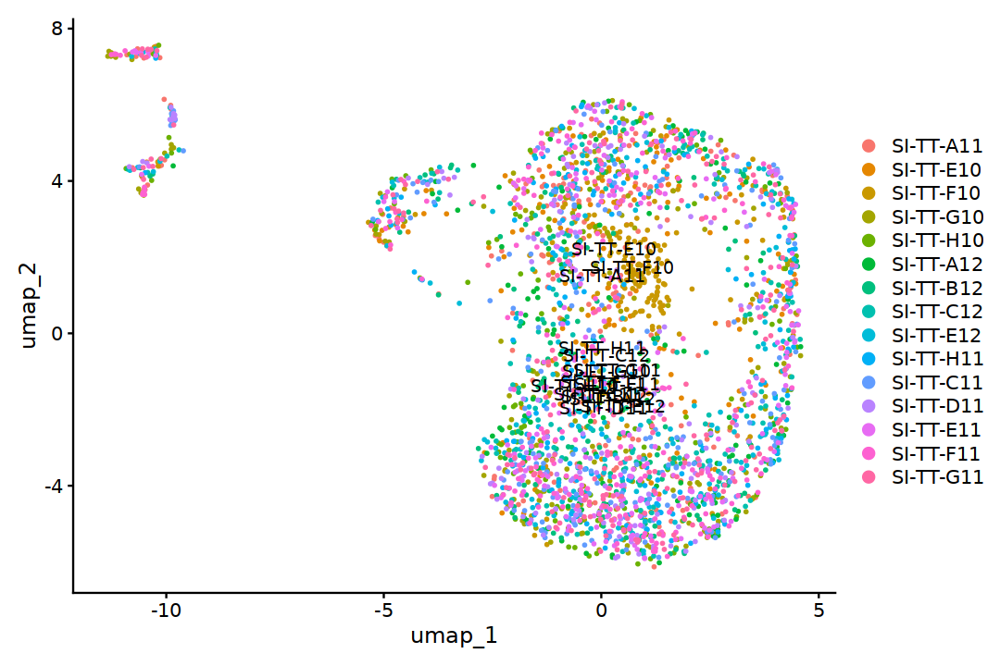

In [319]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(Index.10x_SCOP)
DimPlot(obj_sct, reduction = "umap", label=T)

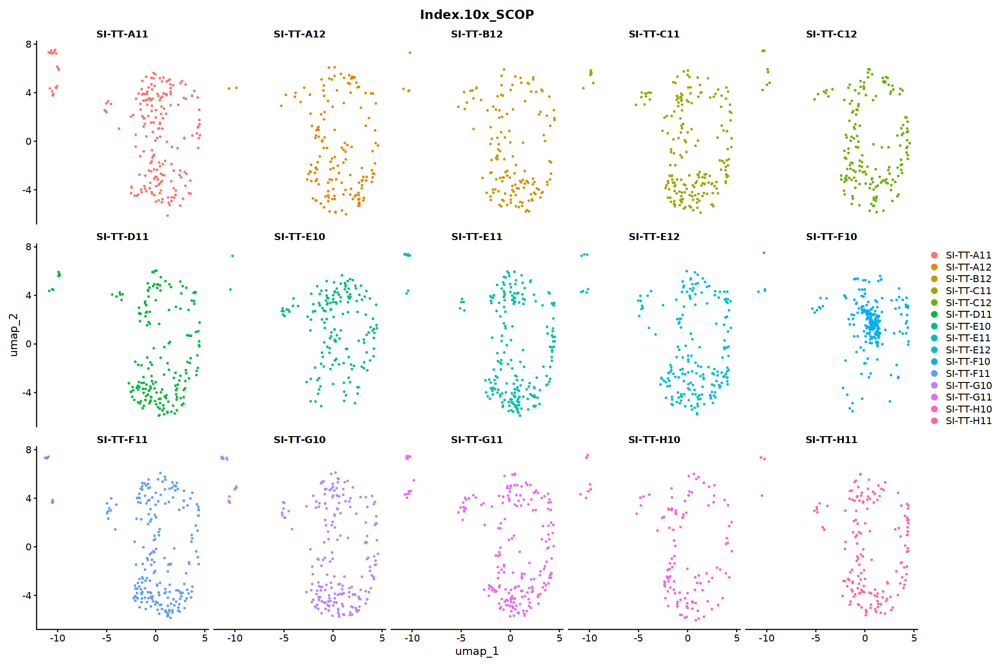

In [320]:
options(repr.plot.width=18, repr.plot.height=12)
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(Index.10x_SCOP)
obj_sct %>% DimPlot(split.by = 'Index.10x_SCOP', group.by='Index.10x_SCOP', ncol=5)


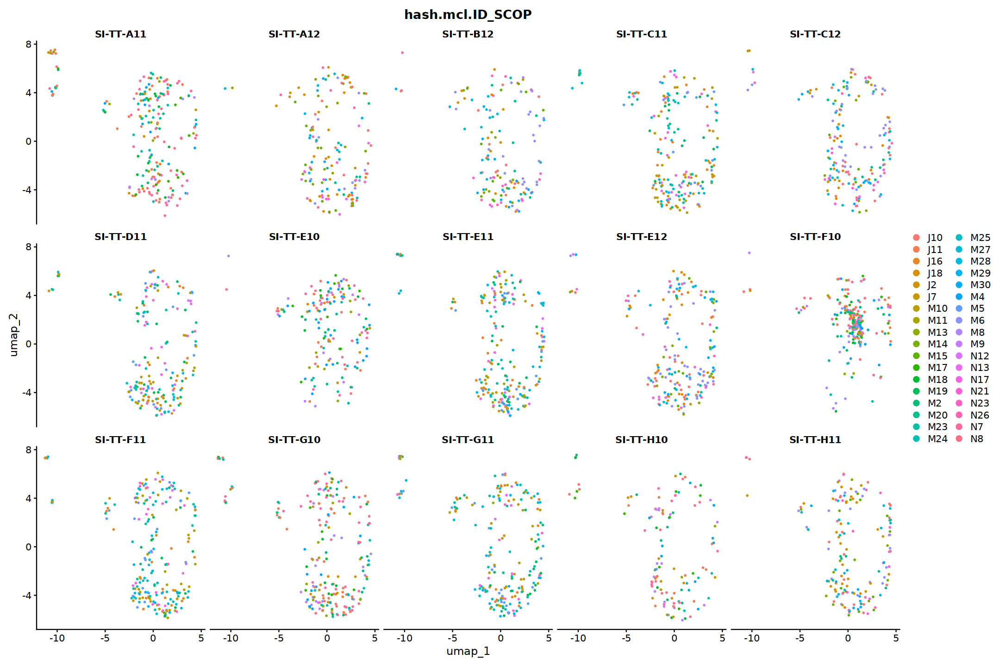

In [321]:
options(repr.plot.width=18, repr.plot.height=12)
obj_sct %>%
DimPlot(split.by = 'Index.10x_SCOP', group.by='hash.mcl.ID_SCOP', ncol=5)


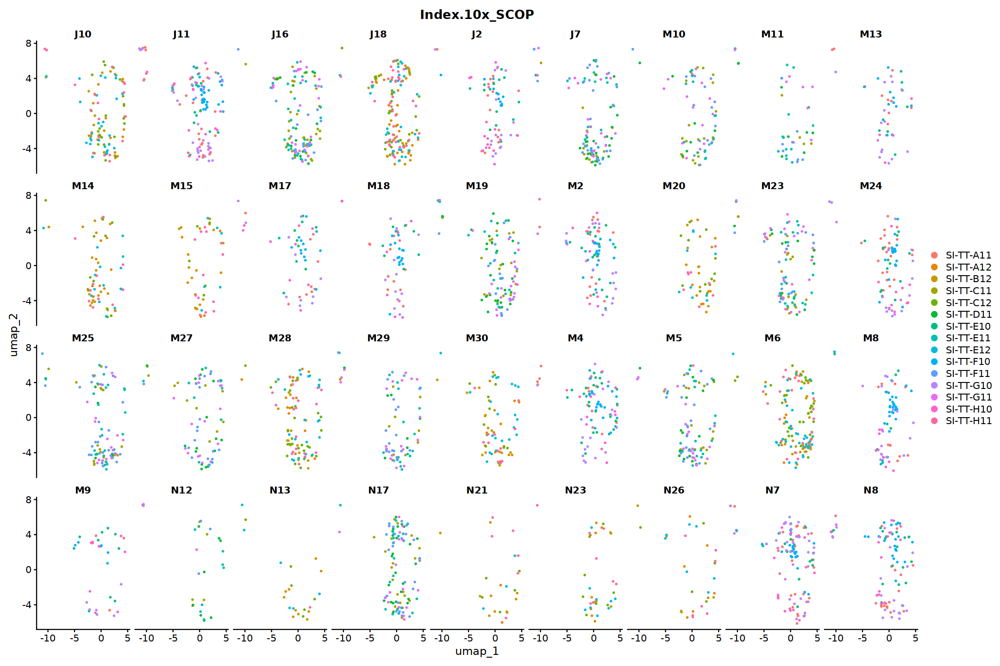

In [322]:
options(repr.plot.width=18, repr.plot.height=12)
obj_sct %>%
DimPlot(split.by = 'hash.mcl.ID_SCOP', group.by='Index.10x_SCOP', ncol=9)


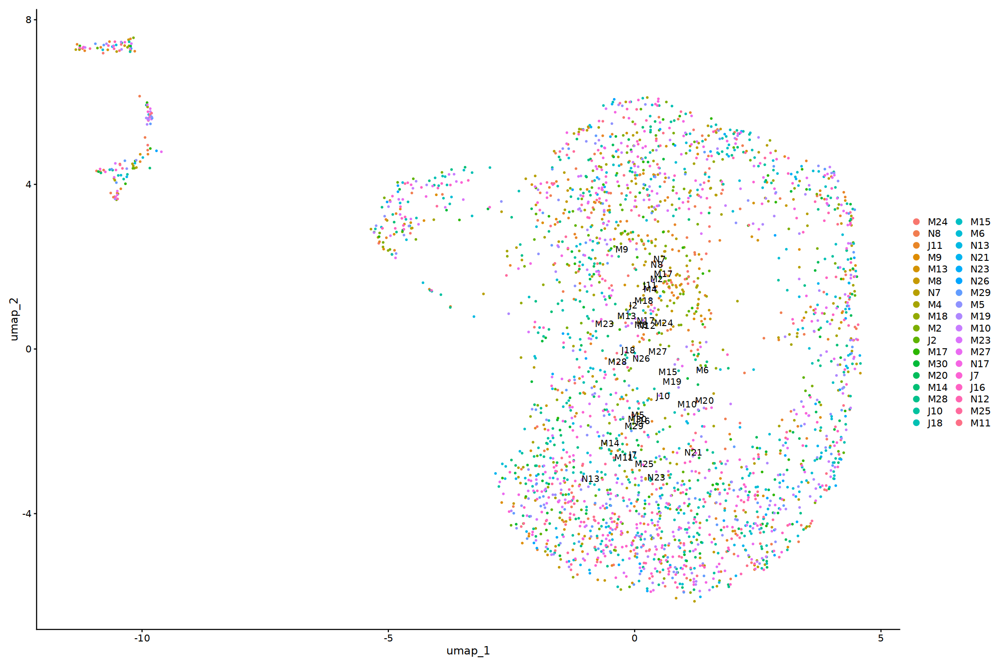

In [323]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(hash.mcl.ID_SCOP)
DimPlot(obj_sct, reduction = "umap", label=T)

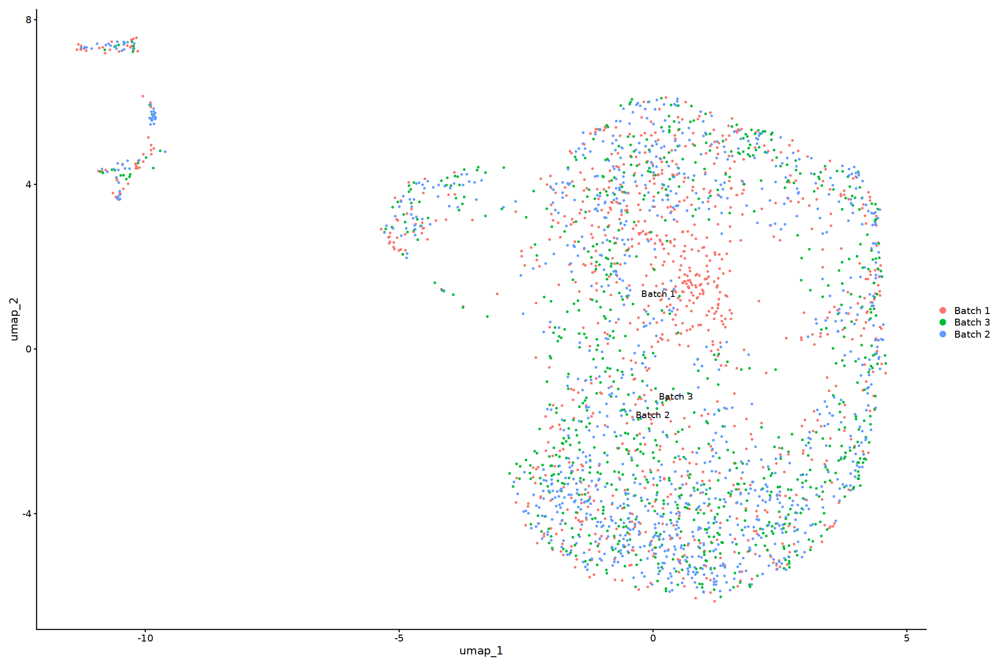

In [324]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(batch)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

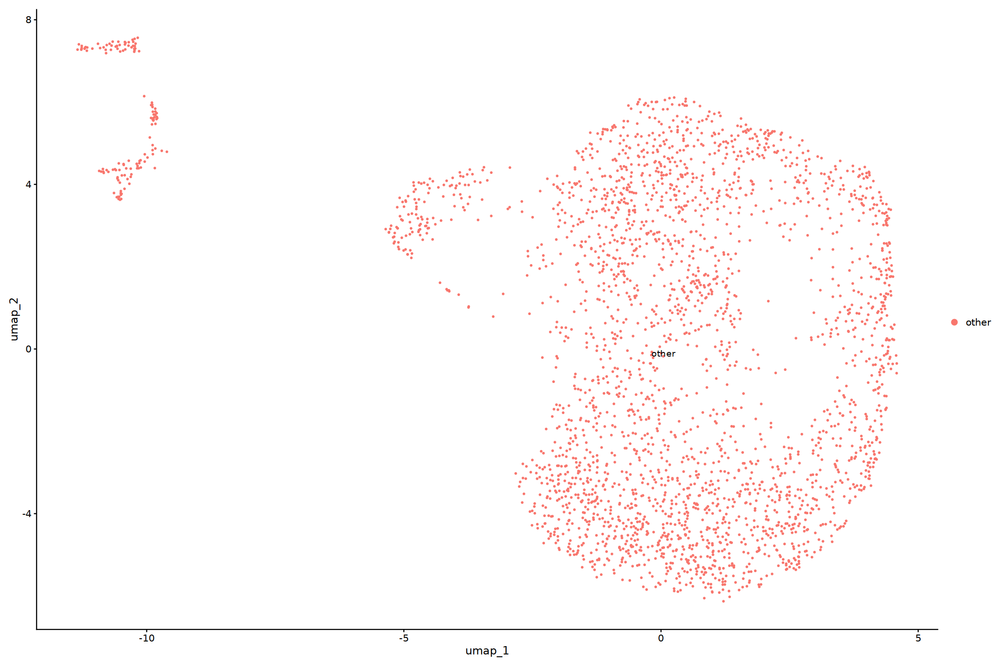

In [325]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(class)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

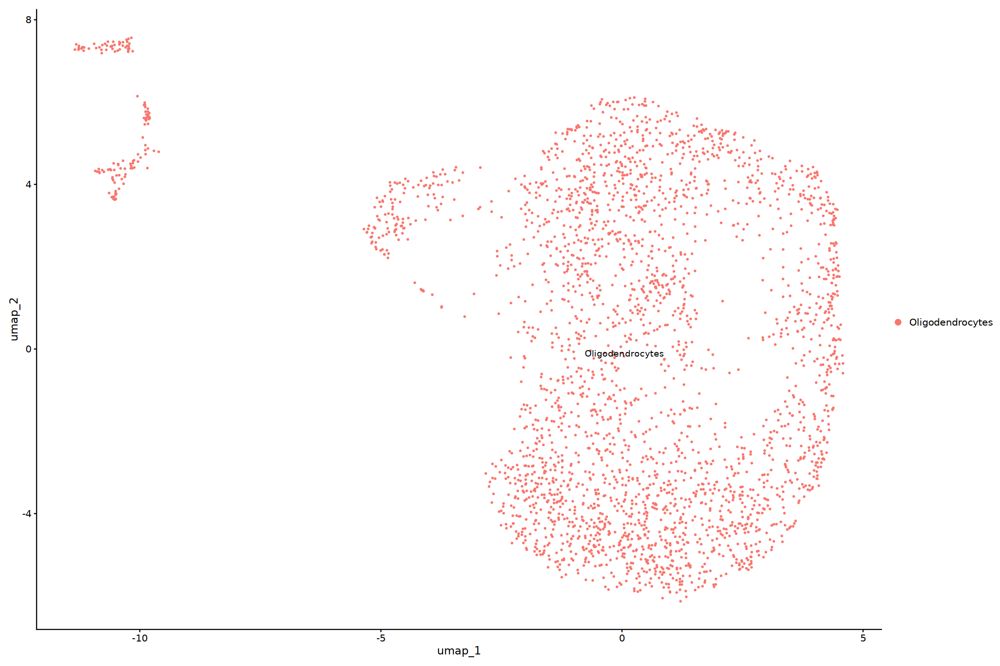

In [326]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

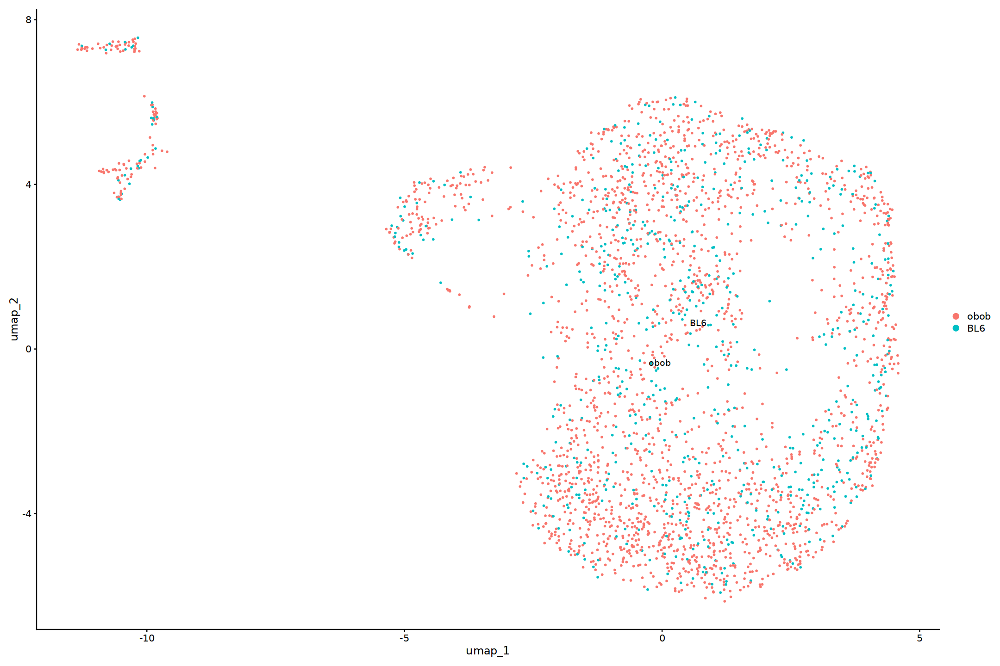

In [327]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(strain)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

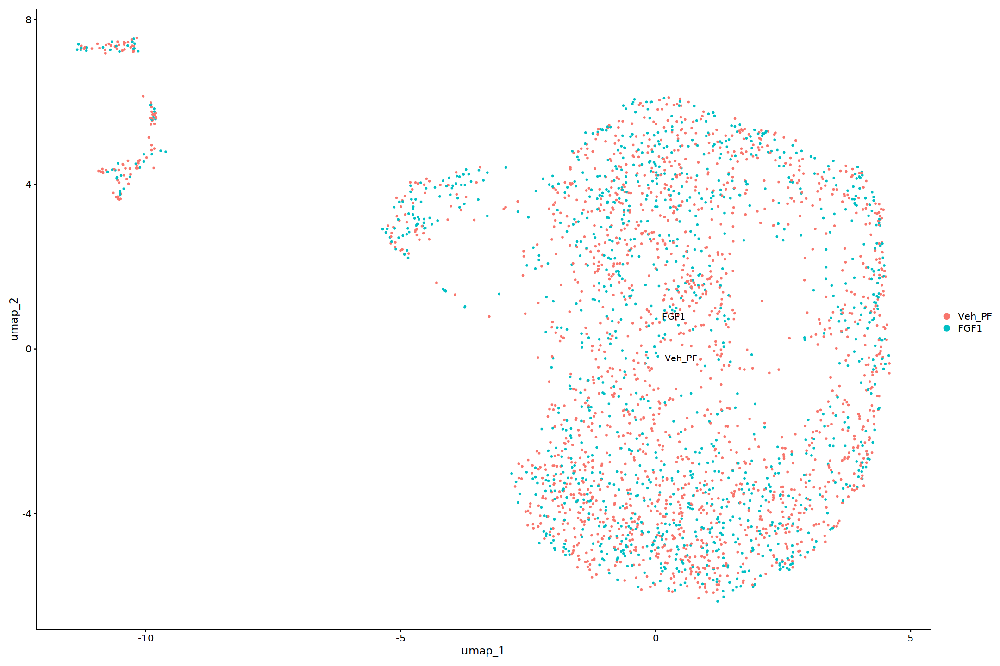

In [328]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(treatment)
DimPlot(obj_sct, reduction = "umap", label=T, repel = T)

Warning message:
“Could not find Pdgfra in the default search locations, found in ‘RNA’ assay instead”


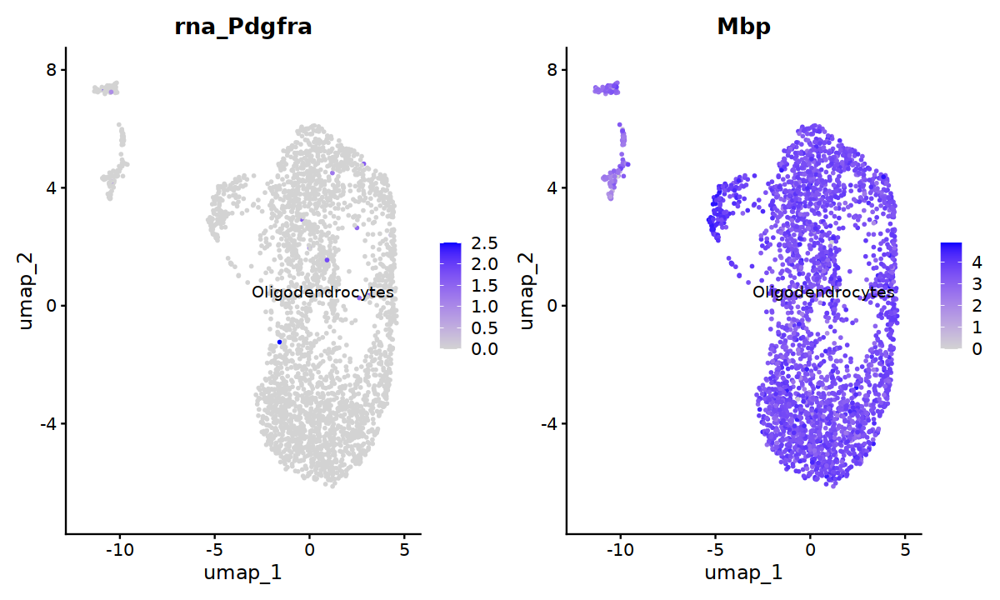

In [329]:
Idents(obj_sct) <- obj_sct %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=6)
FeaturePlot(obj_sct, features=c("Pdgfra", "Mbp"), label=TRUE, repel=TRUE)

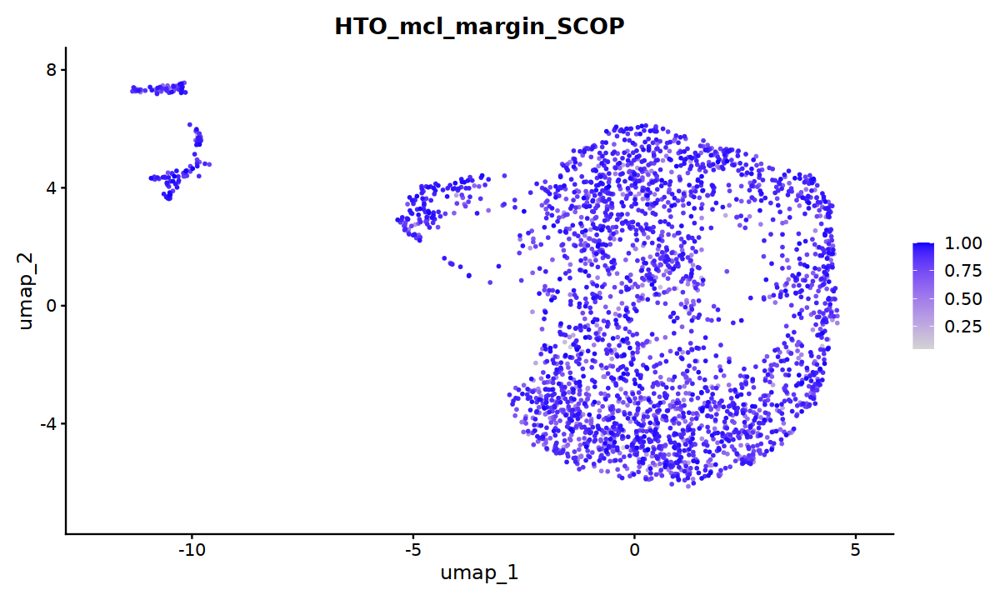

In [330]:

obj_sct %>%
FeaturePlot('HTO_mcl_margin_SCOP', order = TRUE)


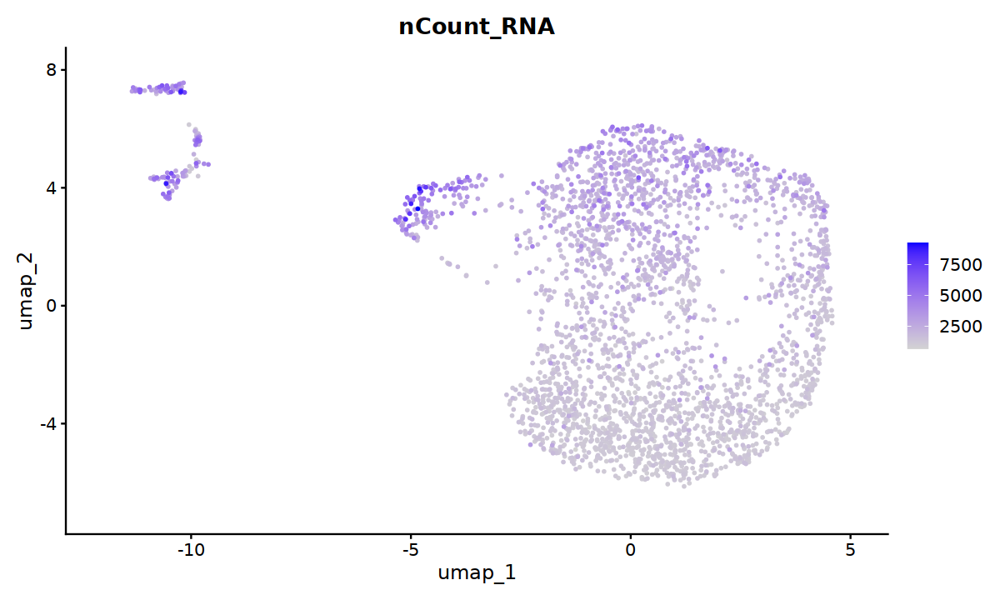

In [331]:

obj_sct %>%
FeaturePlot('nCount_RNA', order = TRUE)


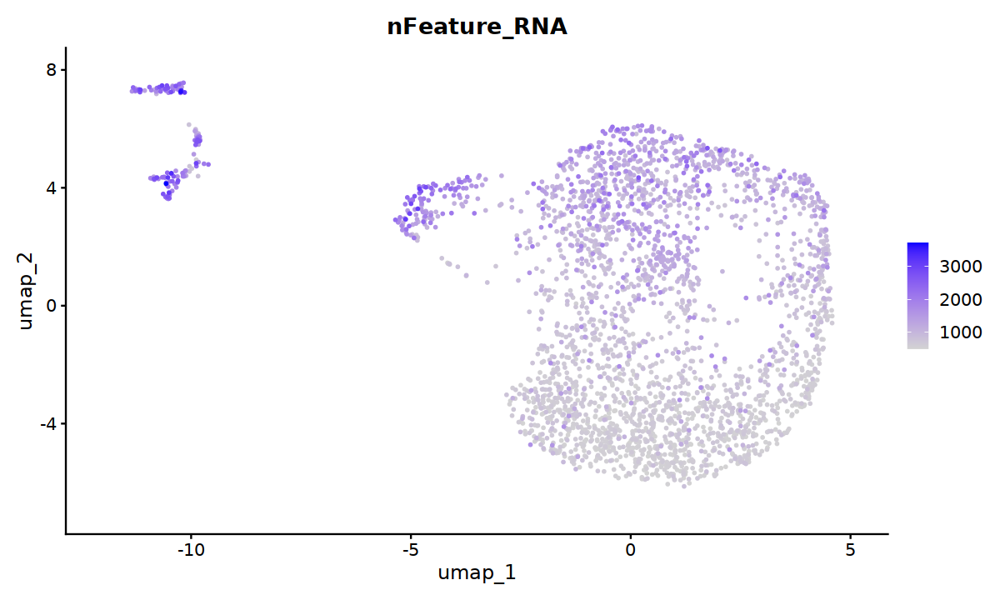

In [332]:

obj_sct %>%
FeaturePlot('nFeature_RNA', order = TRUE)


In [333]:
nFeature_RNA

ERROR: Error in eval(expr, envir, enclos): object 'nFeature_RNA' not found


In [ ]:
#SI-TT-A11, SI-TT-F10

In [290]:
obj_sct %>% `[[` %>% colnames

[1] "orig.ident"                         "nCount_RNA"                        
 [3] "nFeature_RNA"                       "nCount_RNA_SCOP"                   
 [5] "nFeature_RNA_SCOP"                  "Index.10x_SCOP"                    
 [7] "nCount_HTO_SCOP"                    "nFeature_HTO_SCOP"                 
 [9] "Index.HTO_SCOP"                     "nCount_spliced_SCOP"               
[11] "nFeature_spliced_SCOP"              "nCount_unspliced_SCOP"             
[13] "nFeature_unspliced_SCOP"            "HTO_mcl_maxID_SCOP"                
[15] "HTO_mcl_secondID_SCOP"              "HTO_mcl_margin_SCOP"               
[17] "HTO_mcl_classification_SCOP"        "HTO_mcl_classification.global_SCOP"
[19] "hash.mcl.ID_SCOP"                   "doublet_SCOP"                      
[21] "predicted_dub_std_SCOP"             "predicted_dub_cut_SCOP"            
[23] "barcode_SCOP"                       "Index.10x"                         
[25] "barcode"                            "strain"                            
[27] "treatment"                          "time"                              
[29] "collection_date"                    "isolation_date"                    
[31] "batch"                              "integrated_snn_res.0.5"            
[33] "seurat_clusters"                    "class"                             
[35] "integrated_snn_res.0.95"            "labels_lvl1"

In [418]:
qs::qread('clusters_tibble.qs')

label,object,day,cluster
<chr>,<list>,<chr>,<chr>
Astrocytes,exp_labelled_other,all,Astrocytes
Day14.Astrocytes,exp_labelled_other,Day14,Astrocytes
Day5.Astrocytes,exp_labelled_other,Day5,Astrocytes
a1_Tany__Astrocytes,exp_labelled_other,all,a1_Tany__Astrocytes
Day14.a1_Tany__Astrocytes,exp_labelled_other,Day14,a1_Tany__Astrocytes
Day5.a1_Tany__Astrocytes,exp_labelled_other,Day5,a1_Tany__Astrocytes
MOL,exp_labelled_other,all,MOL
Day14.MOL,exp_labelled_other,Day14,MOL
Day5.MOL,exp_labelled_other,Day5,MOL


In [419]:
obj_cb_neuron = qs::qread('_targets/objects/obj_cb_neuron')
obj_cb_neuron

An object of class Seurat 
29799 features across 105096 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



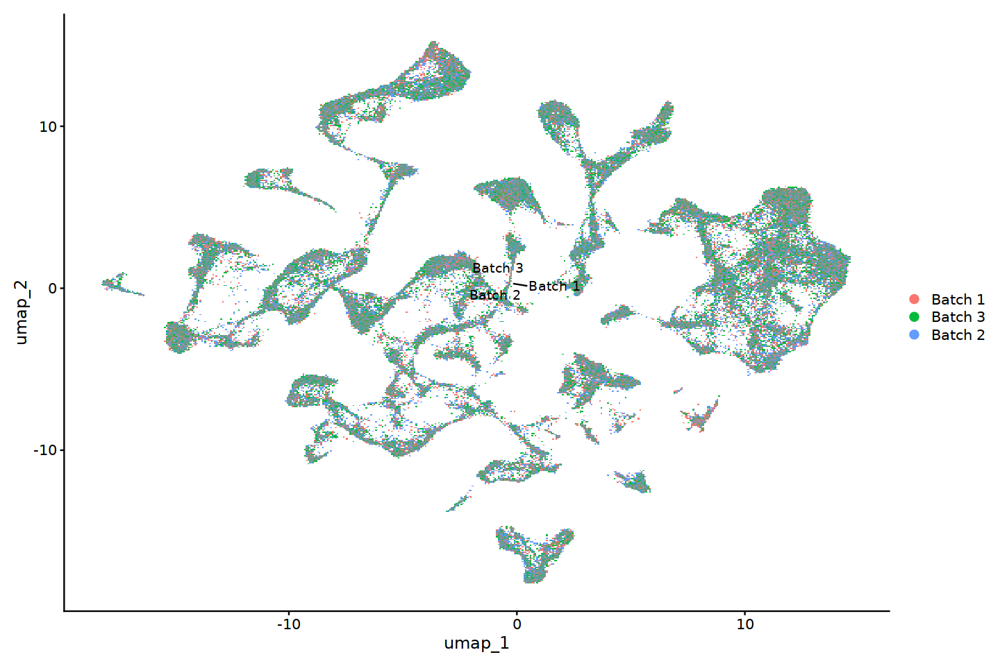

In [441]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

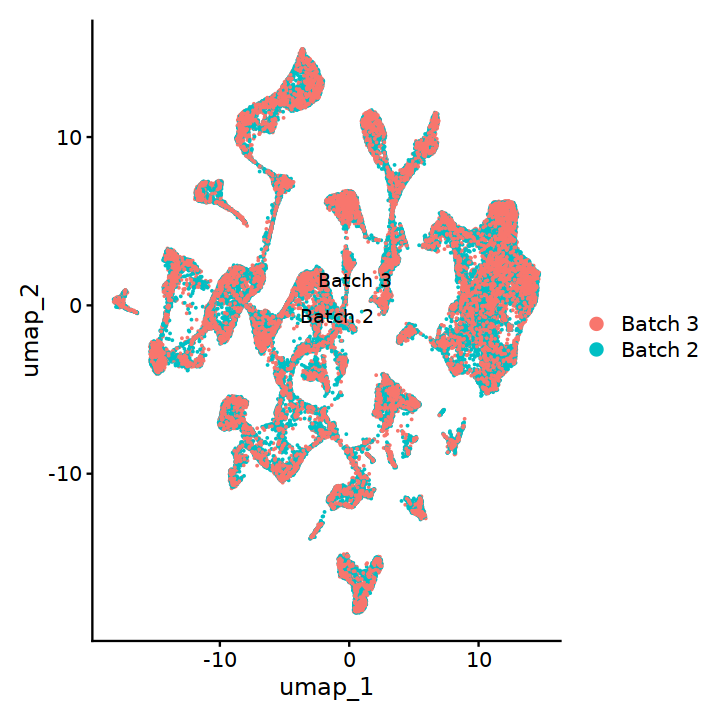

In [442]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
obj_cb_neuron %>% subset(subset = batch != 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

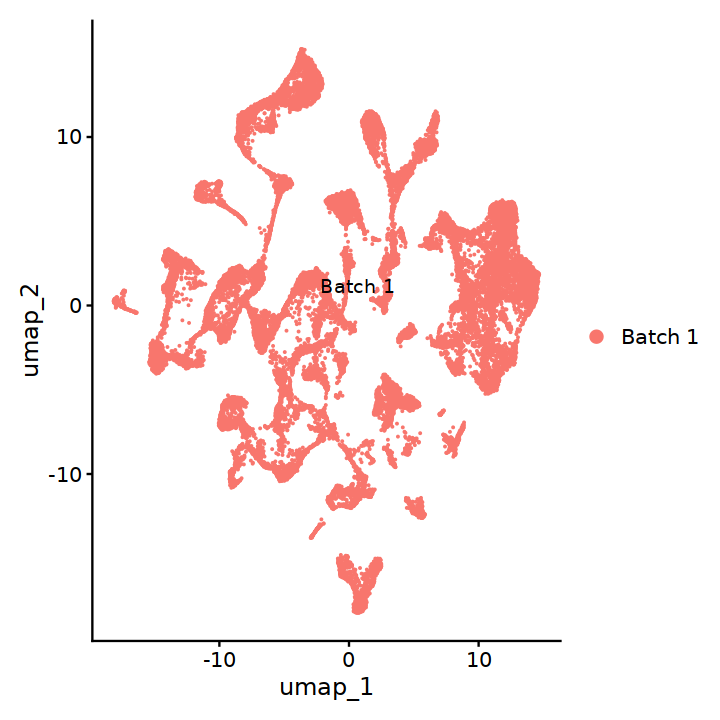

In [443]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
obj_cb_neuron %>% subset(subset = batch == 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



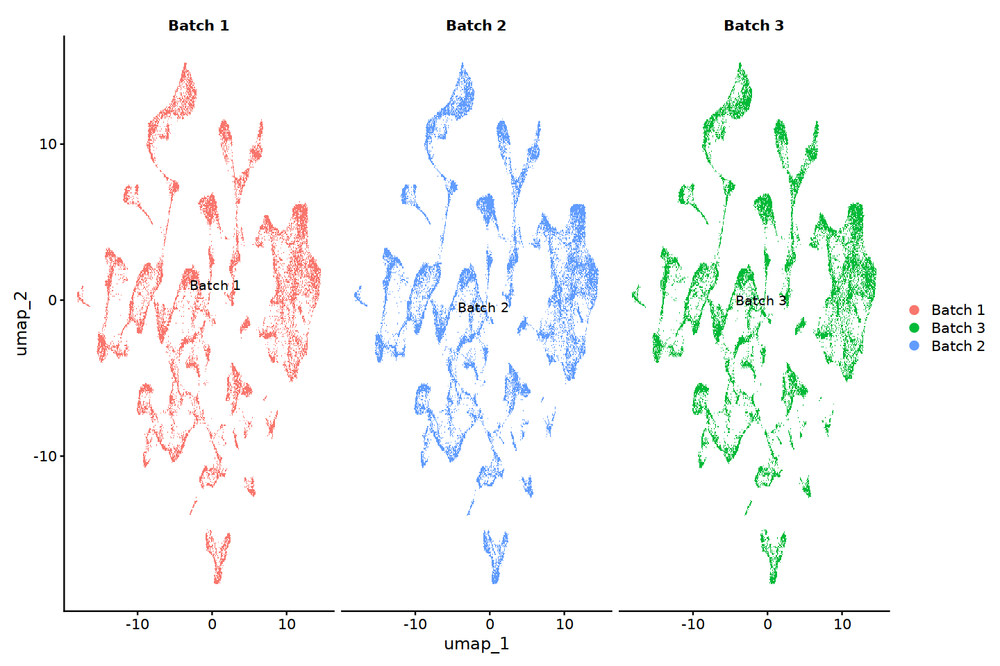

In [436]:
options(repr.plot.width=12, repr.plot.height=8)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
obj_cb_neuron %>% 
# subset(subset = batch == 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", split.by = 'batch', label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



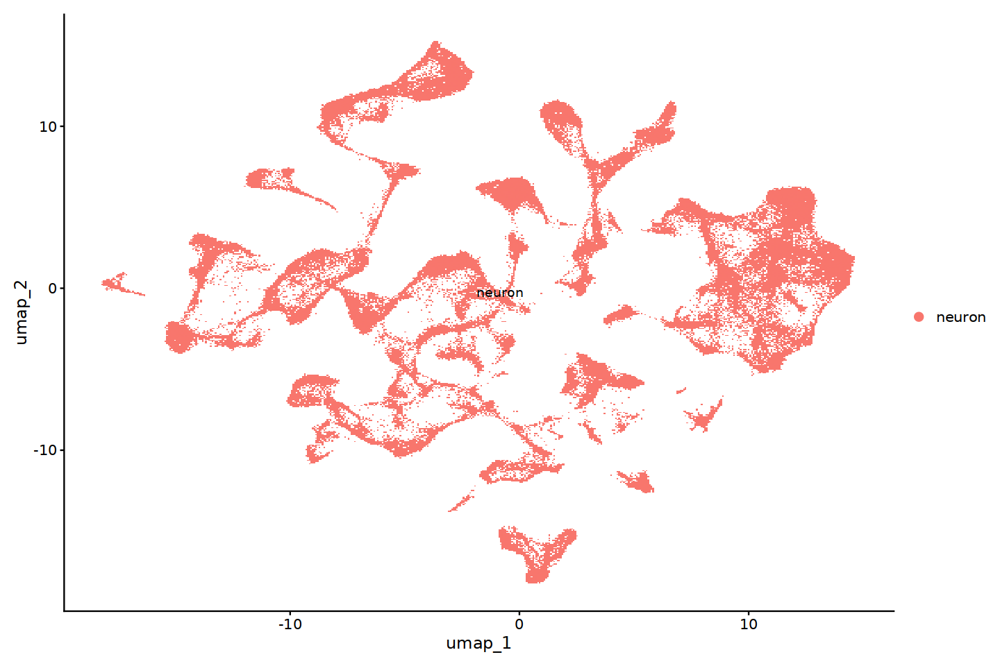

In [437]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(class)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


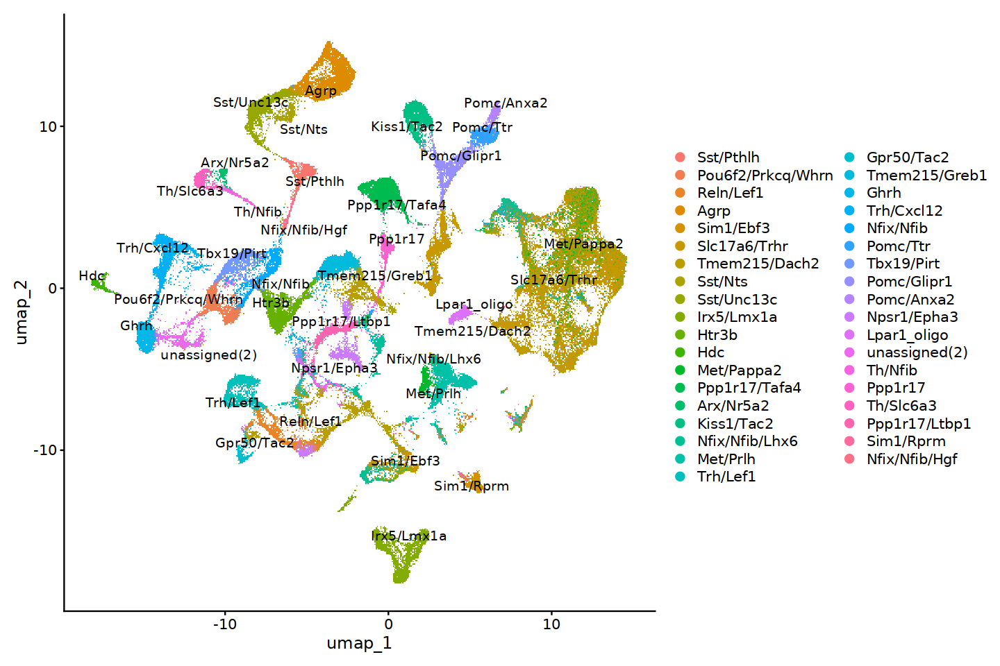

In [438]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

In [ ]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



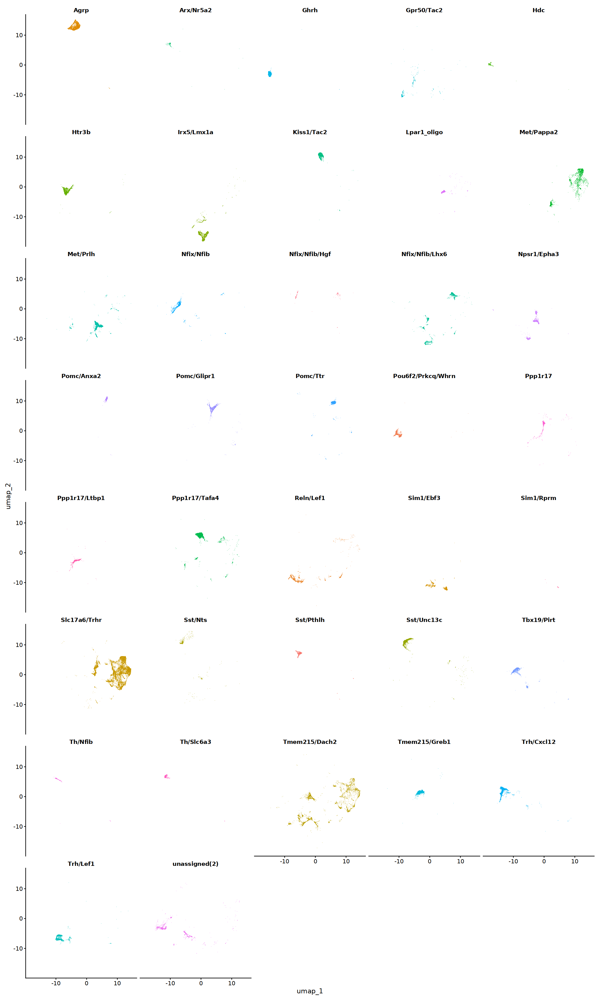

In [457]:
options(repr.plot.width=18, repr.plot.height=30)
obj_cb_neuron %>%
DimPlot(split.by = 'labels_lvl1', ncol=5)+ NoLegend()


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


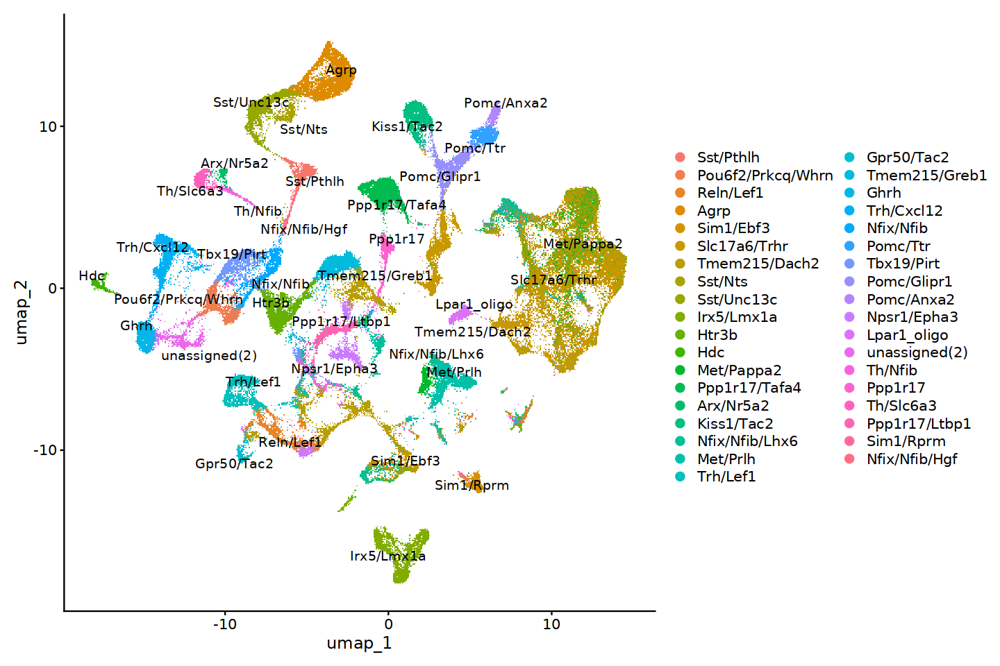

In [439]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



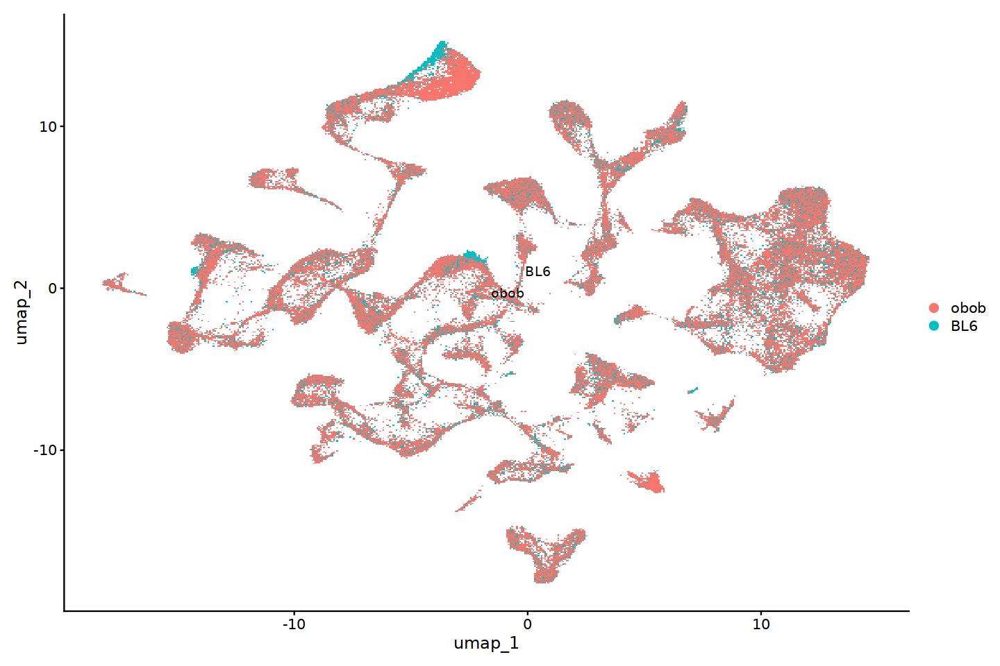

In [440]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(strain)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



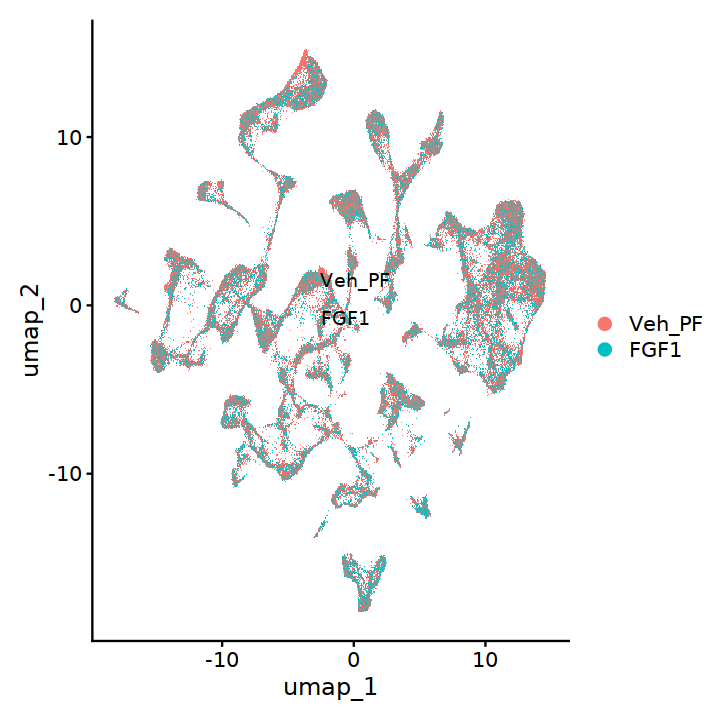

In [444]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(treatment)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Warning message:
“Could not find Sst in the default search locations, found in ‘RNA’ assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“ggrepel: 28 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 28 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 28 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


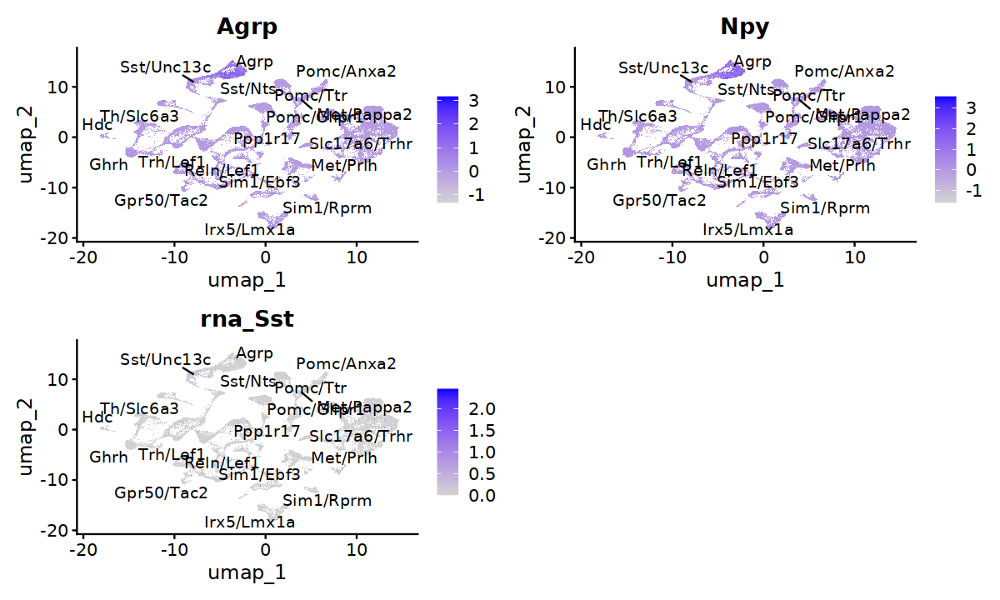

In [445]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=6)
FeaturePlot(obj_cb_neuron, features=c("Agrp", "Npy", 'Sst'), label=TRUE, repel=TRUE)

In [446]:
obj_cb_neuron

An object of class Seurat 
29799 features across 105096 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [447]:
obj_cb_neuron@assays$integrated

Assay data with 2000 features for 105096 cells
Top 10 variable features:
 Hdc, Adarb2, E130114P18Rik, Gpc5, Gm32647, Unc13c, Ebf1, Col24a1, Npsr1, Il1rapl2 

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



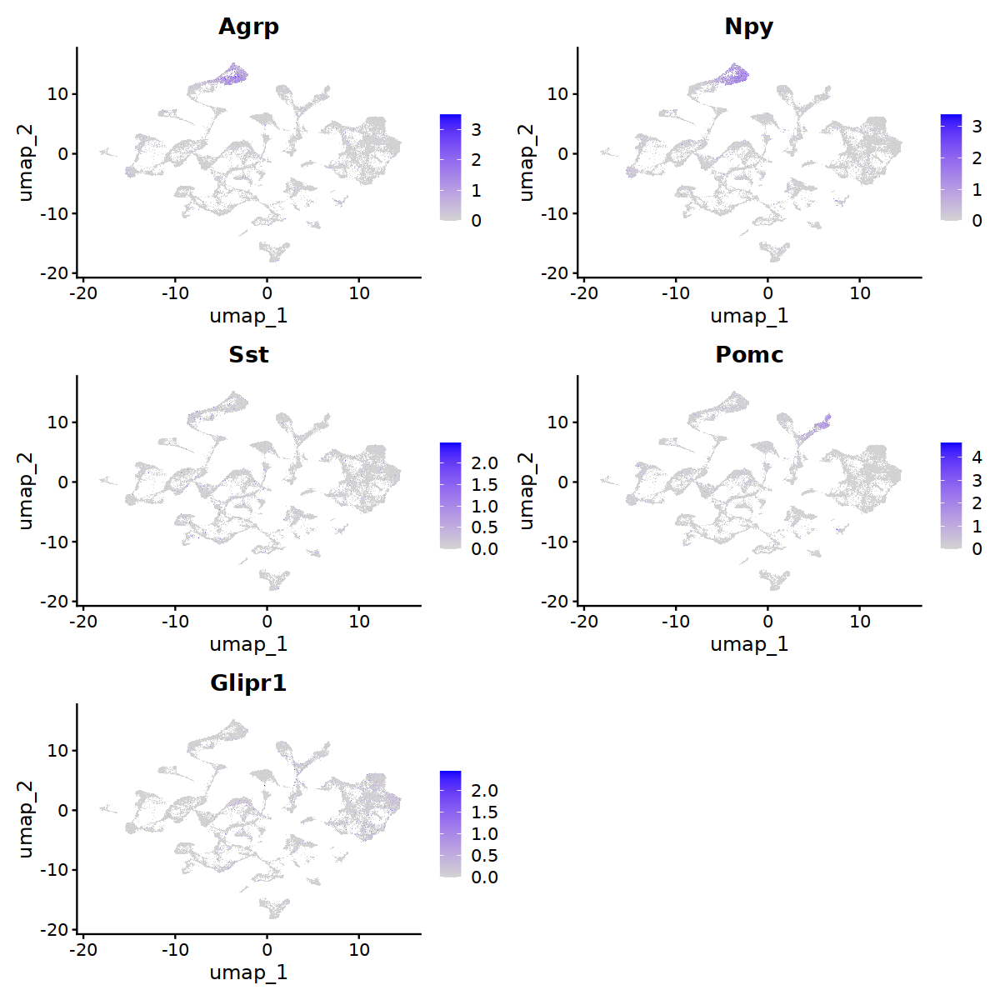

In [453]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
options(repr.plot.width=10, repr.plot.height=10)
DefaultAssay(obj_cb_neuron) = 'RNA'
FeaturePlot(obj_cb_neuron, features=c("Agrp", "Npy", 'Sst', 'Pomc', 'Glipr1'), order=TRUE, )

In [458]:
obj_cb_neuron %>% `[[` %>% head

,orig.ident,nCount_RNA,nFeature_RNA,nCount_RNA_SCOP,nFeature_RNA_SCOP,Index.10x_SCOP,nCount_HTO_SCOP,nFeature_HTO_SCOP,Index.HTO_SCOP,nCount_spliced_SCOP,⋯,time,collection_date,isolation_date,batch,integrated_snn_res.0.5,seurat_clusters,class,integrated_snn_res.0.95,labels_lvl1,prediction.score.max
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<dbl>,<int>,<chr>,<dbl>,⋯,<chr>,<dbl>,<chr>,<chr>,<chr>,<fct>,<chr>,<fct>,<chr>,<dbl>
SI-TT-A11_AAACCCAAGGTGGTTG,SI-TT-A11,5427,2686,18589,4492,SI-TT-A11,1233,12,D706,2936,⋯,Day14,220201,22/6/2022,Batch 1,31,20,neuron,20,Sst/Pthlh,1.0000000
SI-TT-A11_AAACCCACATACAGCT,SI-TT-A11,6794,3191,22352,4816,SI-TT-A11,1000,12,D706,2976,⋯,Day5,220329,22/6/2022,Batch 1,5,11,neuron,11,Pou6f2/Prkcq/Whrn,0.5933309
SI-TT-A11_AAACCCACATGAGGGT,SI-TT-A11,13576,5516,44099,7365,SI-TT-A11,12215,12,D706,7888,⋯,Day14,220407,22/6/2022,Batch 1,40,45,neuron,45,Reln/Lef1,0.3597994
SI-TT-A11_AAACCCAGTACGTTCA,SI-TT-A11,3849,2247,17749,4347,SI-TT-A11,1699,12,D706,2474,⋯,Day14,220407,22/6/2022,Batch 1,3,1,neuron,1,Agrp,1.0000000
SI-TT-A11_AAACCCATCCAAGCAT,SI-TT-A11,6044,3023,21805,4803,SI-TT-A11,2167,12,D706,3573,⋯,Day5,211213,22/6/2022,Batch 1,25,43,neuron,43,Sim1/Ebf3,1.0000000
SI-TT-A11_AAACCCATCCCATAAG,SI-TT-A11,13238,4512,37468,5802,SI-TT-A11,1790,12,D706,5281,⋯,Day5,211214,22/6/2022,Batch 1,7,10,neuron,10,Slc17a6/Trhr,0.5965835


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



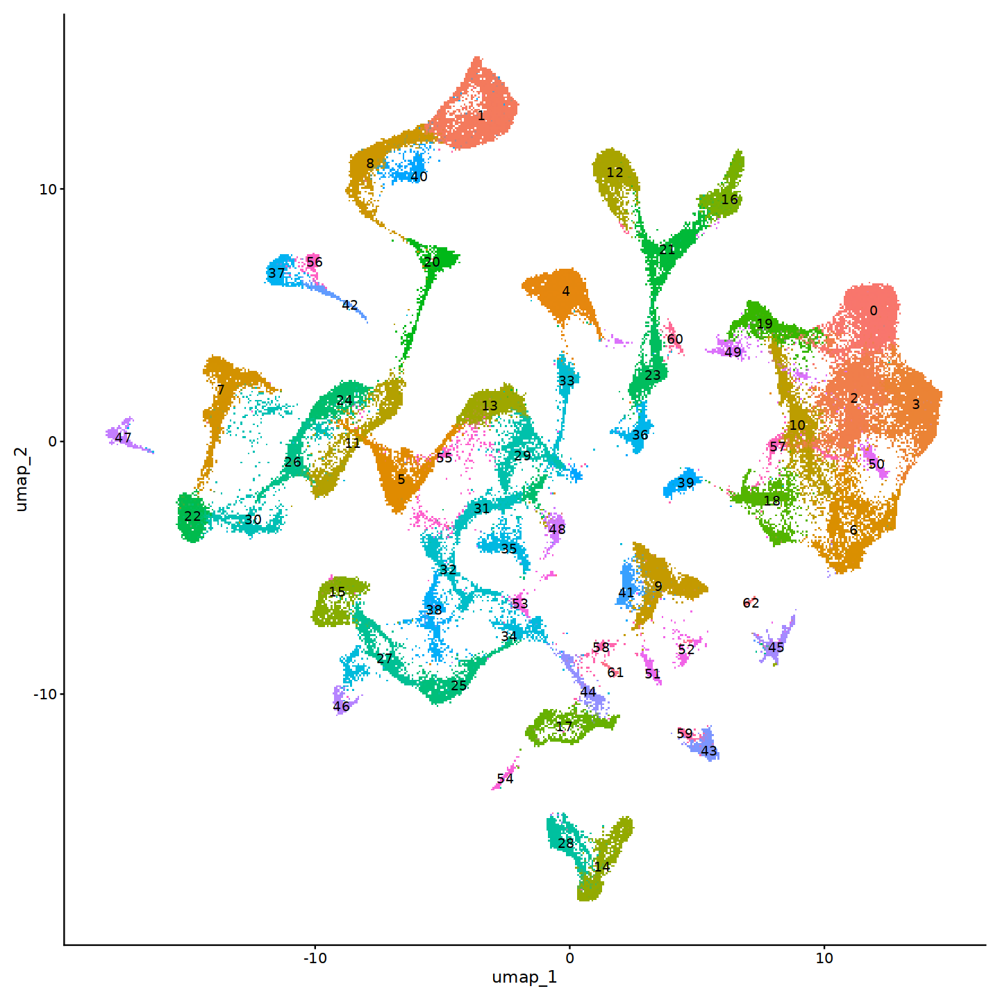

In [465]:
options(repr.plot.width=12, repr.plot.height=12)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(integrated_snn_res.0.95)
DimPlot(obj_cb_neuron, reduction = "umap", label=TRUE) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



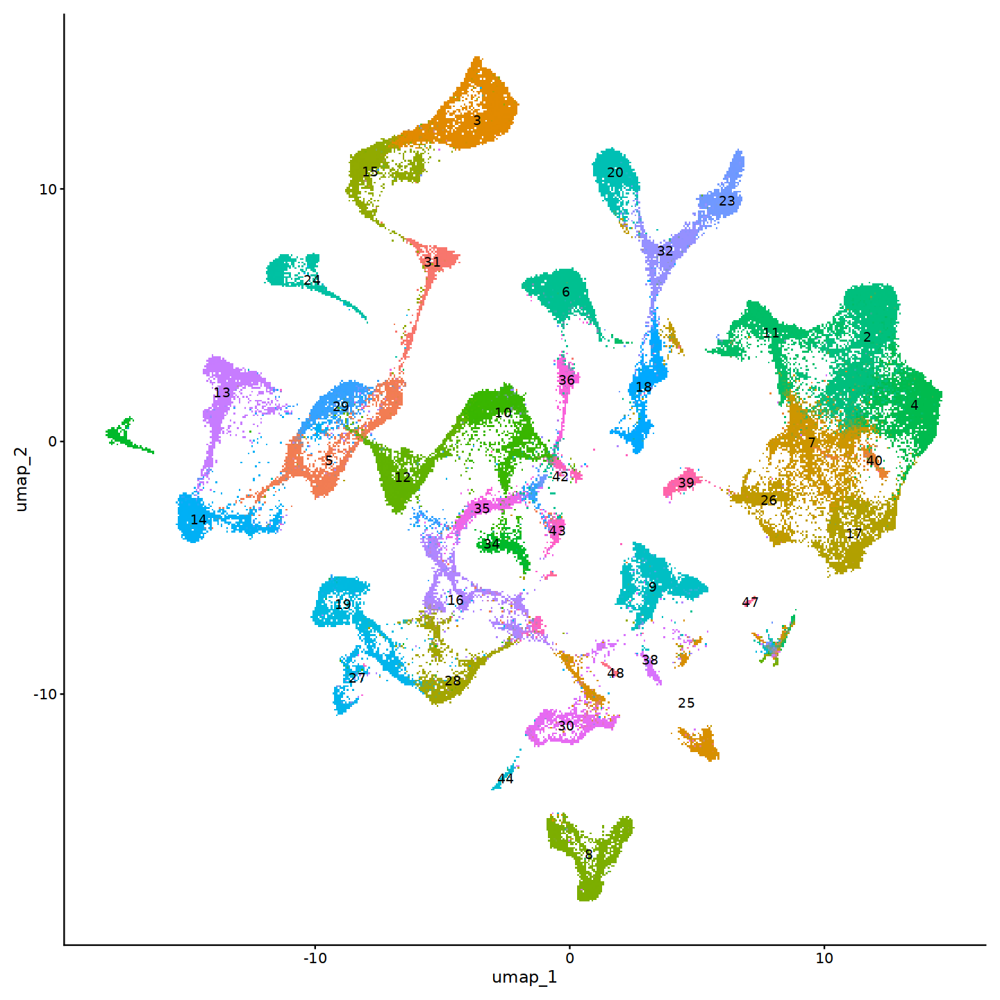

In [464]:
options(repr.plot.width=12, repr.plot.height=12)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(integrated_snn_res.0.5)
DimPlot(obj_cb_neuron, reduction = "umap", label=TRUE) + NoLegend()

In [ ]:
v

In [600]:
obj_cb_neuron = qs::qread('_targets/objects/obj_cb_neuron_4')
obj_cb_neuron

An object of class Seurat 
29799 features across 105096 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [601]:
obj_cb_neuron %>% `[[` %>% colnames

[1] "orig.ident"                         "nCount_RNA"                         "nFeature_RNA"                       "nCount_RNA_SCOP"                    "nFeature_RNA_SCOP"                 
 [6] "Index.10x_SCOP"                     "nCount_HTO_SCOP"                    "nFeature_HTO_SCOP"                  "Index.HTO_SCOP"                     "nCount_spliced_SCOP"               
[11] "nFeature_spliced_SCOP"              "nCount_unspliced_SCOP"              "nFeature_unspliced_SCOP"            "HTO_mcl_maxID_SCOP"                 "HTO_mcl_secondID_SCOP"             
[16] "HTO_mcl_margin_SCOP"                "HTO_mcl_classification_SCOP"        "HTO_mcl_classification.global_SCOP" "hash.mcl.ID_SCOP"                   "doublet_SCOP"                      
[21] "predicted_dub_std_SCOP"             "predicted_dub_cut_SCOP"             "barcode_SCOP"                       "Index.10x"                          "barcode"                           
[26] "strain"                             "treatment"                          "time"                               "collection_date"                    "isolation_date"                    
[31] "batch"                              "integrated_snn_res.0.5"             "seurat_clusters"                    "class"                              "integrated_snn_res.0.75"           
[36] "labels_lvl1"                        "prediction.score.max"               "predicted.id"                       "labels"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



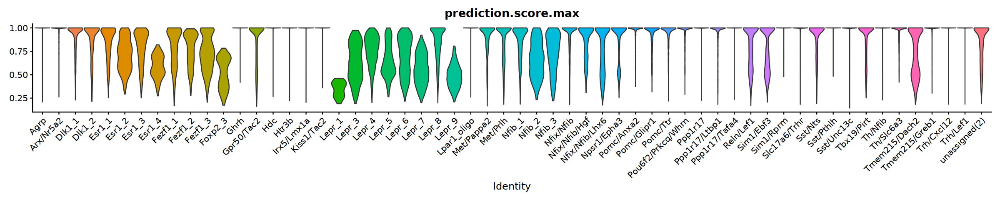

In [611]:
options(repr.plot.width=20, repr.plot.height=4)
obj_cb_neuron %>%
VlnPlot(features = "prediction.score.max", group.by = 'labels_lvl1',
       pt.size=0) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



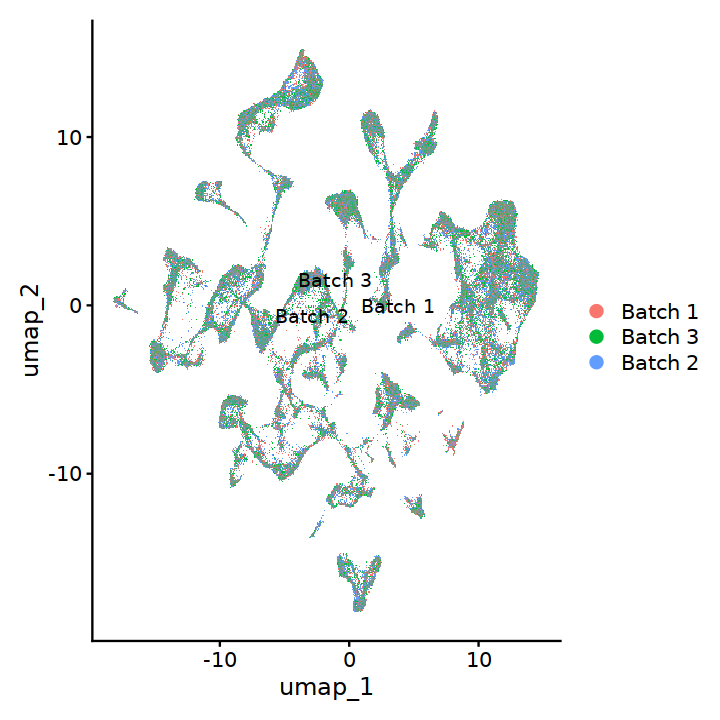

In [561]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



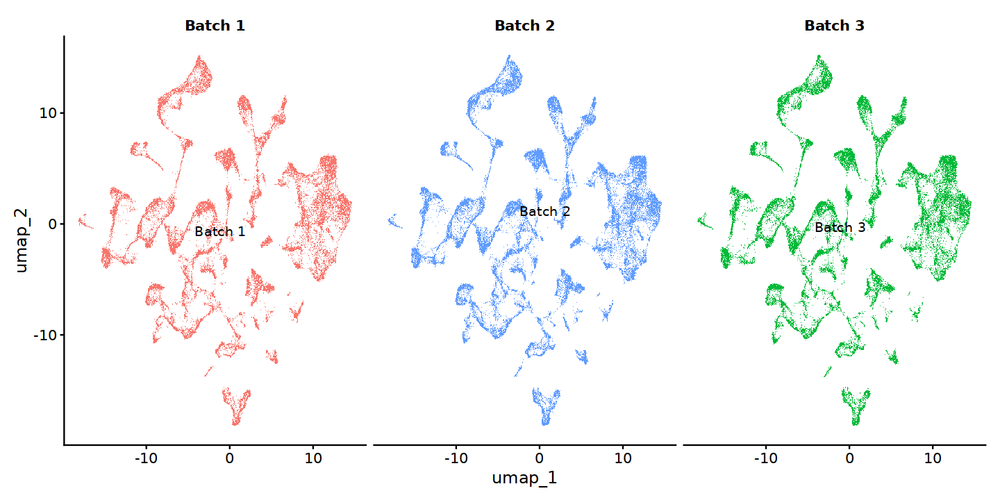

In [562]:
options(repr.plot.width=12, repr.plot.height=6)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
obj_cb_neuron %>% 
# subset(subset = batch == 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", split.by = 'batch', label=T, repel = T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



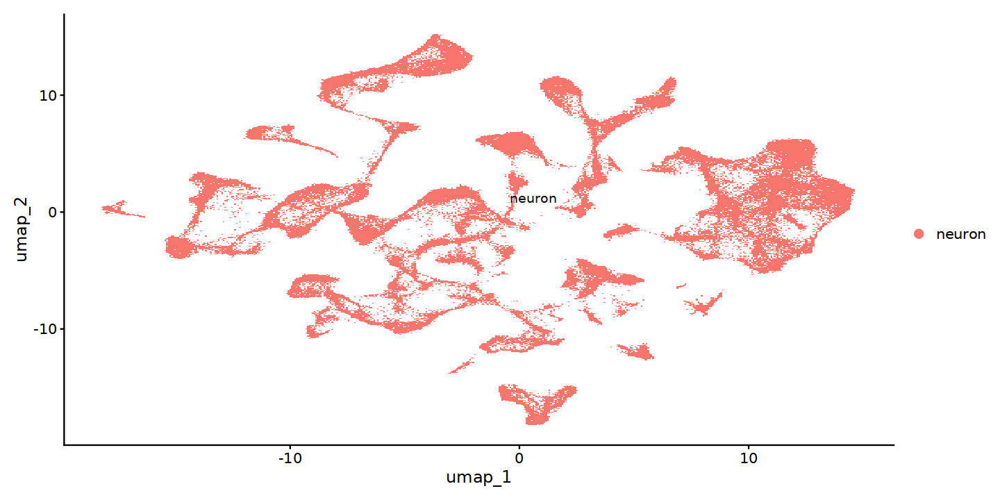

In [563]:
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(class)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


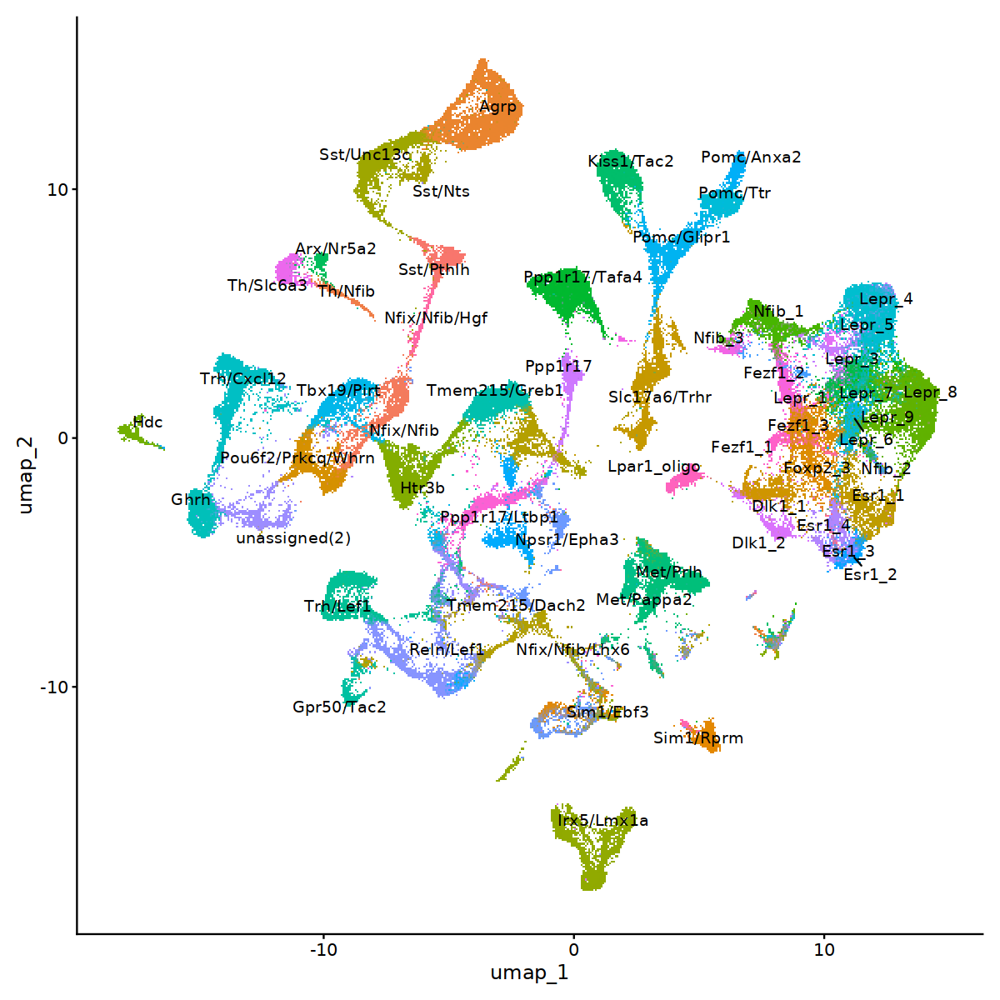

In [599]:
options(repr.plot.width=10, repr.plot.height=10)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



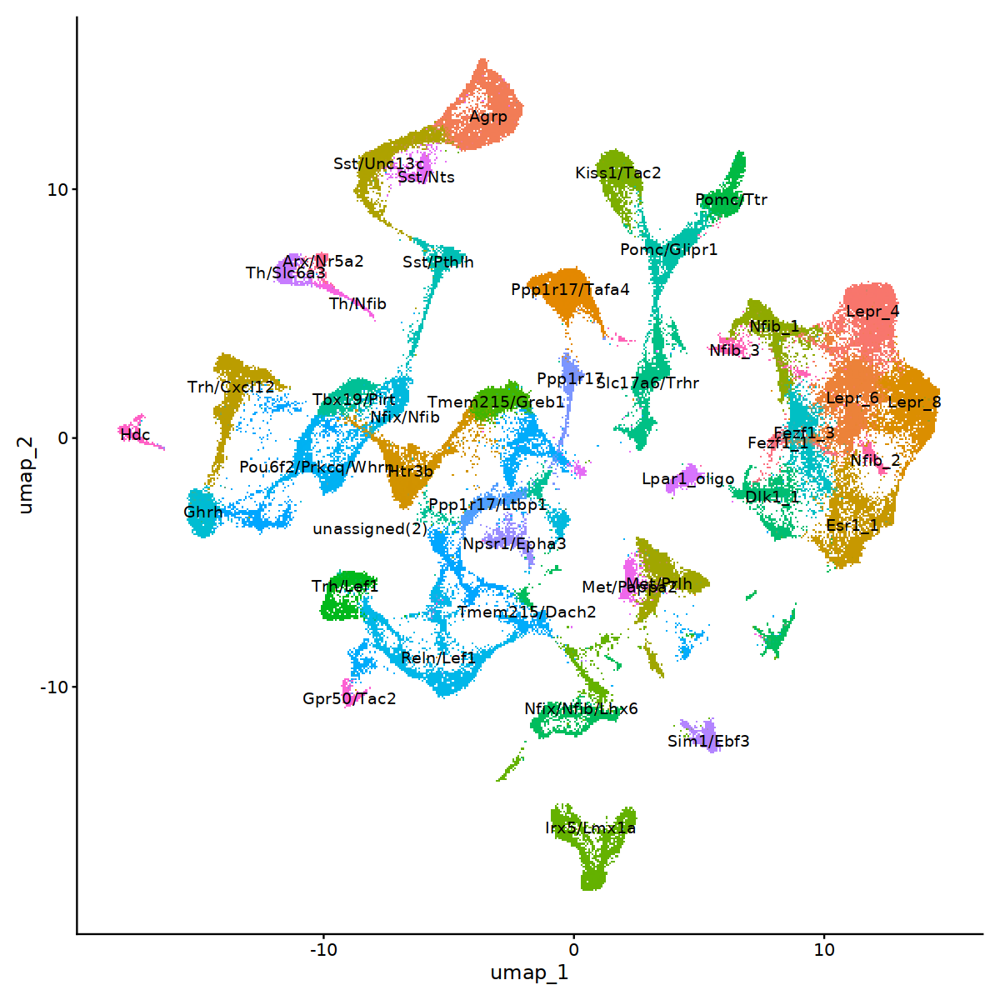

In [597]:
options(repr.plot.width=10, repr.plot.height=10)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels)
DimPlot(obj_cb_neuron, reduction = "umap", label=T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



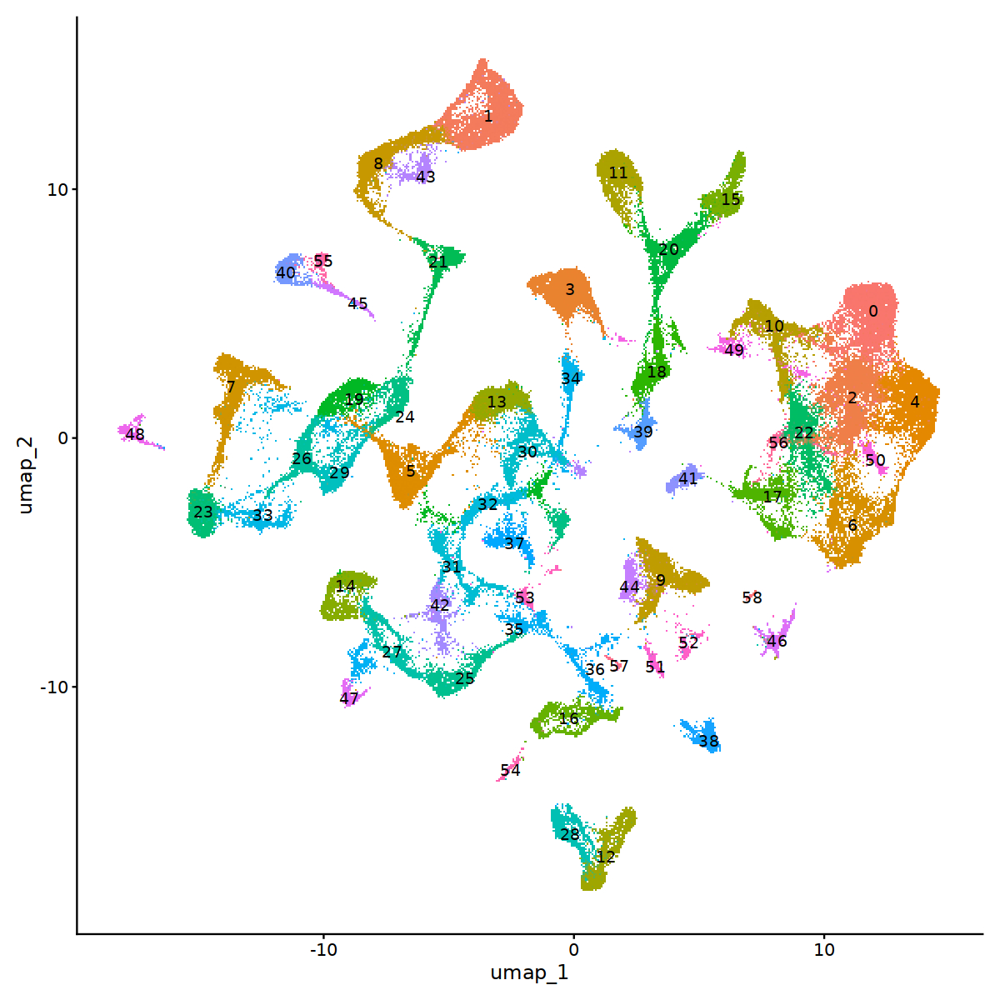

In [598]:
options(repr.plot.width=10, repr.plot.height=10)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(seurat_clusters)
DimPlot(obj_cb_neuron, reduction = "umap", label=T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


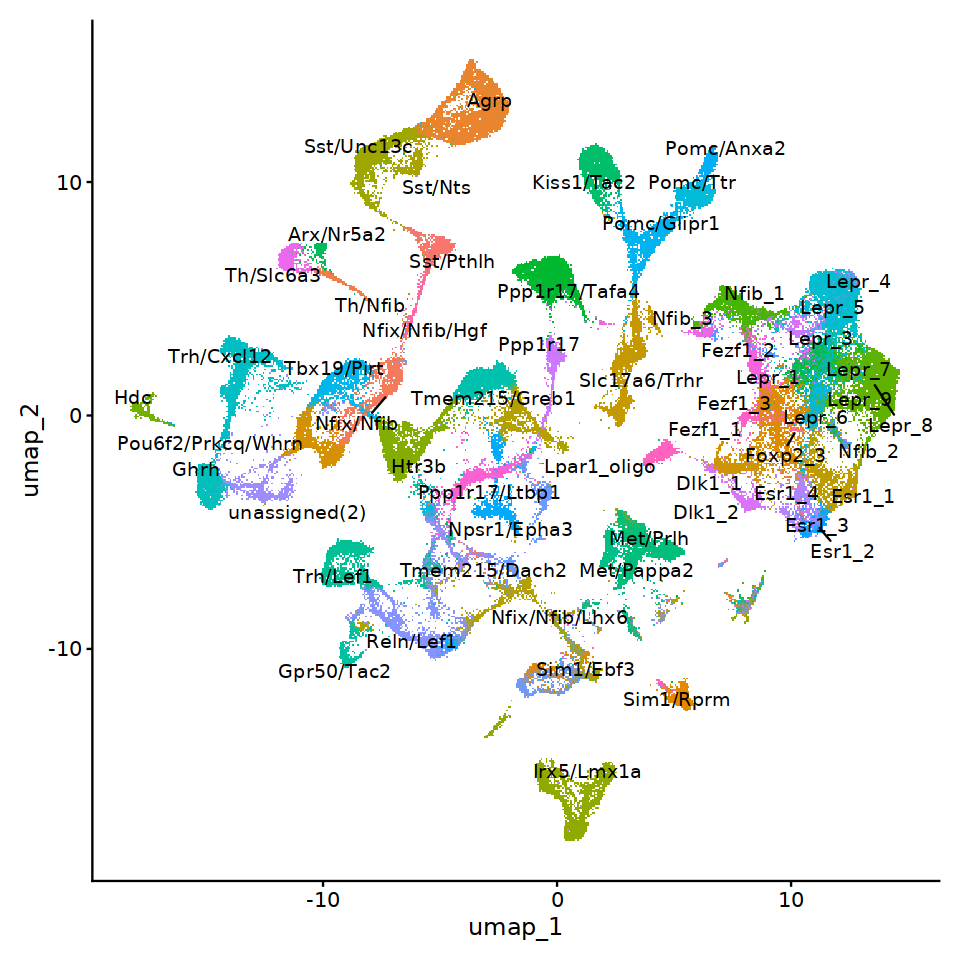

In [574]:
options(repr.plot.width=8, repr.plot.height=8)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



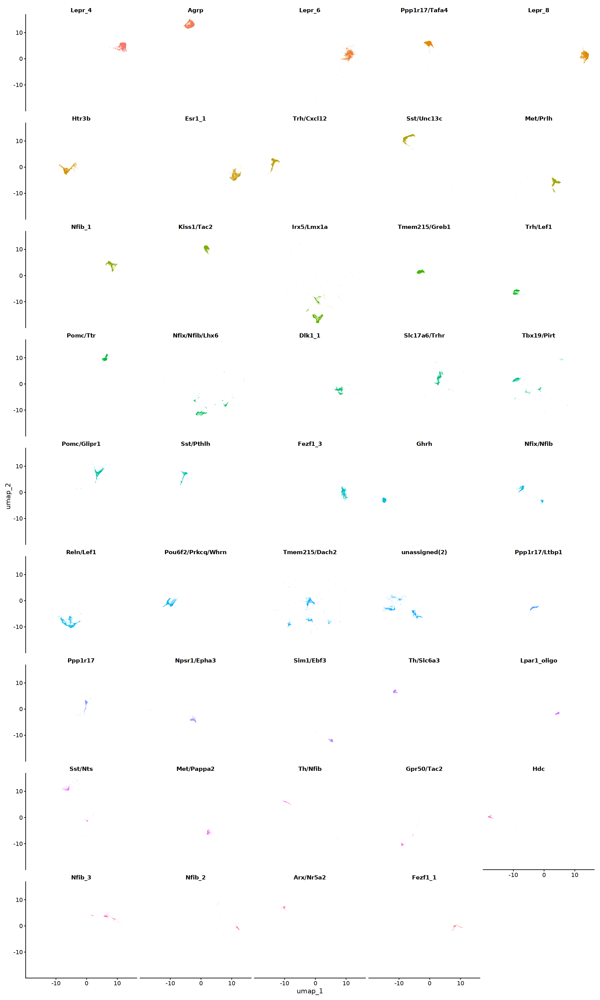

In [567]:
options(repr.plot.width=18, repr.plot.height=30)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels)
obj_cb_neuron %>%
DimPlot(split.by = 'labels', ncol=5)+ NoLegend()


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



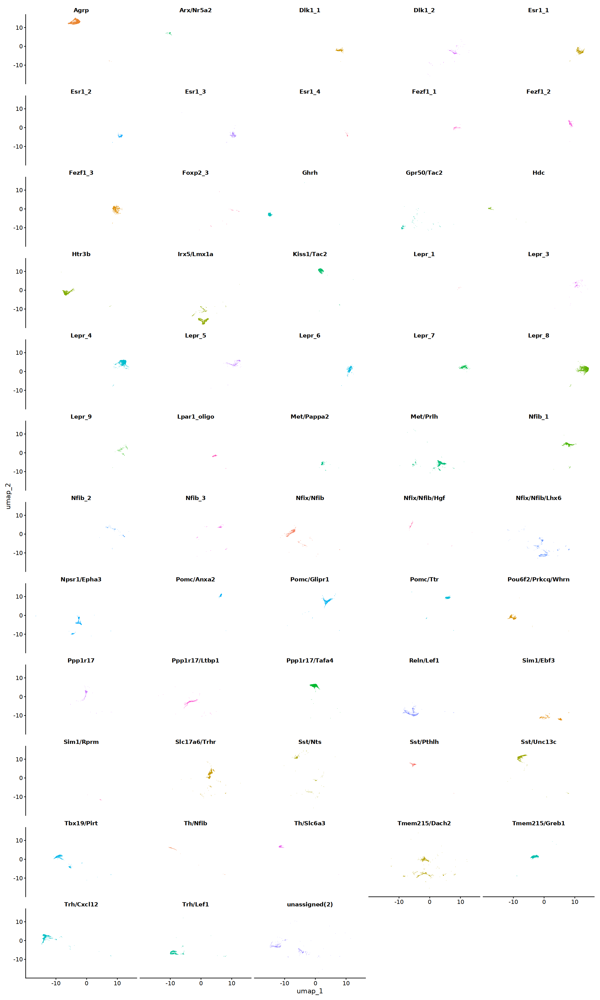

In [568]:
options(repr.plot.width=18, repr.plot.height=30)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
obj_cb_neuron %>%
DimPlot(split.by = 'labels_lvl1', ncol=5)+ NoLegend()


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



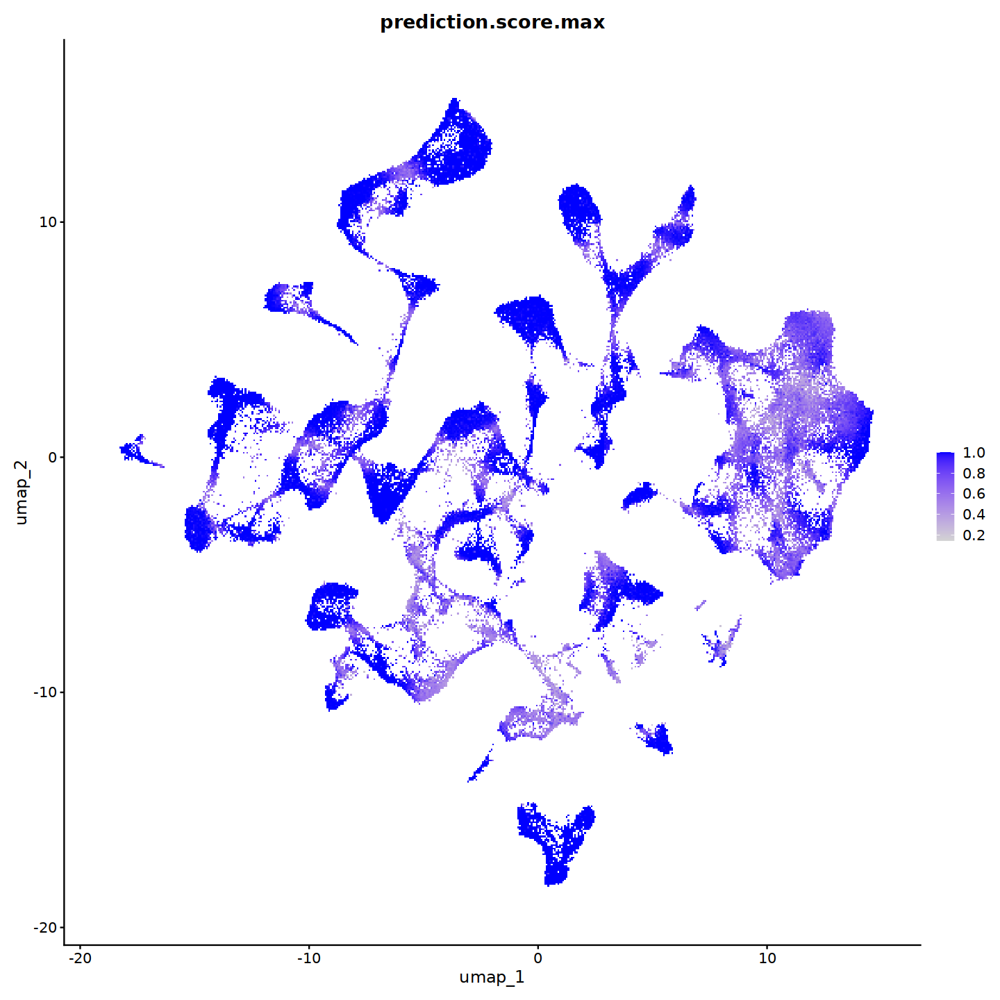

In [582]:
options(repr.plot.width=12, repr.plot.height=12)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels)
obj_cb_neuron %>%
FeaturePlot(features='prediction.score.max')


In [583]:
obj_cb_neuron = qs::qread('_targets/objects/obj_cb_neuron_3')
obj_cb_neuron

An object of class Seurat 
29799 features across 105096 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 layers present: data, scale.data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [584]:
obj_cb_neuron %>% `[[` %>% colnames

[1] "orig.ident"                         "nCount_RNA"                         "nFeature_RNA"                       "nCount_RNA_SCOP"                    "nFeature_RNA_SCOP"                 
 [6] "Index.10x_SCOP"                     "nCount_HTO_SCOP"                    "nFeature_HTO_SCOP"                  "Index.HTO_SCOP"                     "nCount_spliced_SCOP"               
[11] "nFeature_spliced_SCOP"              "nCount_unspliced_SCOP"              "nFeature_unspliced_SCOP"            "HTO_mcl_maxID_SCOP"                 "HTO_mcl_secondID_SCOP"             
[16] "HTO_mcl_margin_SCOP"                "HTO_mcl_classification_SCOP"        "HTO_mcl_classification.global_SCOP" "hash.mcl.ID_SCOP"                   "doublet_SCOP"                      
[21] "predicted_dub_std_SCOP"             "predicted_dub_cut_SCOP"             "barcode_SCOP"                       "Index.10x"                          "barcode"                           
[26] "strain"                             "treatment"                          "time"                               "collection_date"                    "isolation_date"                    
[31] "batch"                              "integrated_snn_res.0.5"             "seurat_clusters"                    "class"                              "integrated_snn_res.0.75"           
[36] "labels_lvl1"                        "prediction.score.max"               "predicted.celltype.score"           "predicted.celltype"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



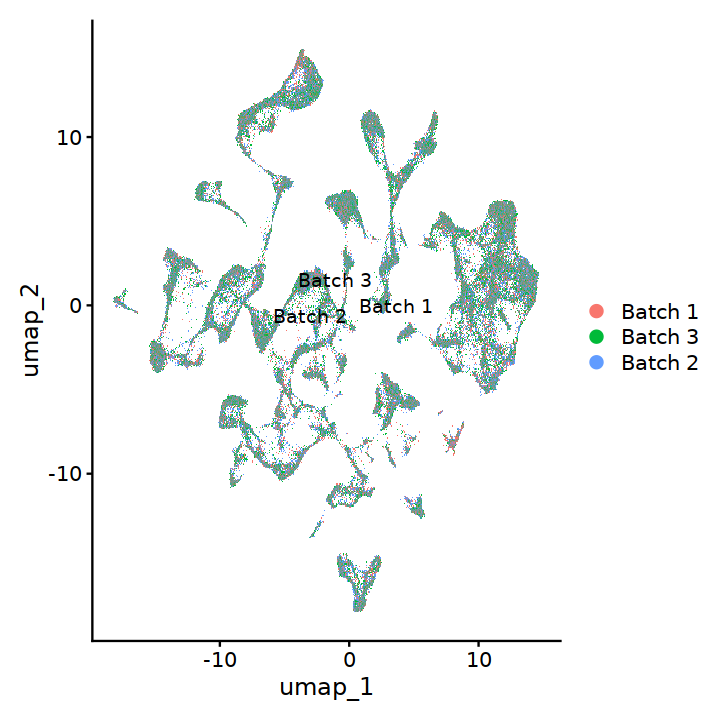

In [585]:
options(repr.plot.width=6, repr.plot.height=6)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



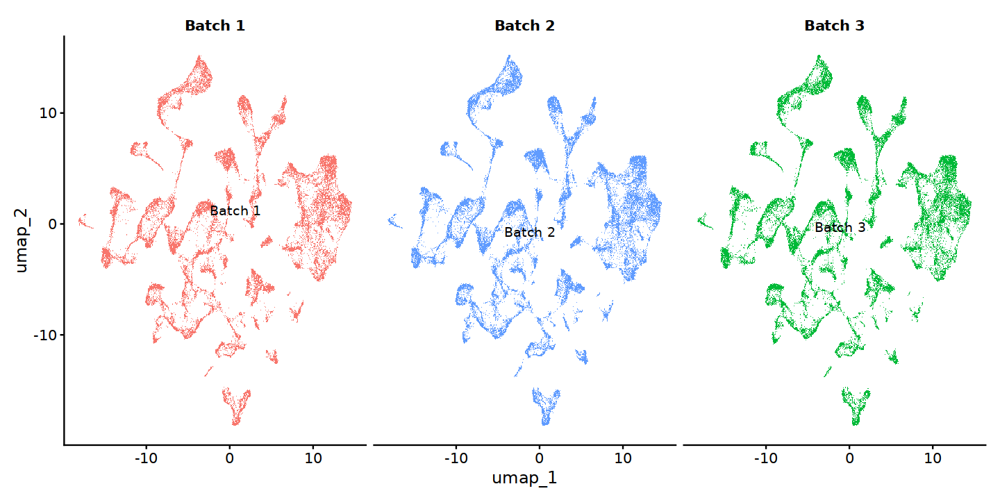

In [586]:
options(repr.plot.width=12, repr.plot.height=6)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(batch)
obj_cb_neuron %>% 
# subset(subset = batch == 'Batch 1') %>%
# subset(subset = labels_lvl1 == 'OPC') %>%
DimPlot(reduction = "umap", split.by = 'batch', label=T, repel = T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


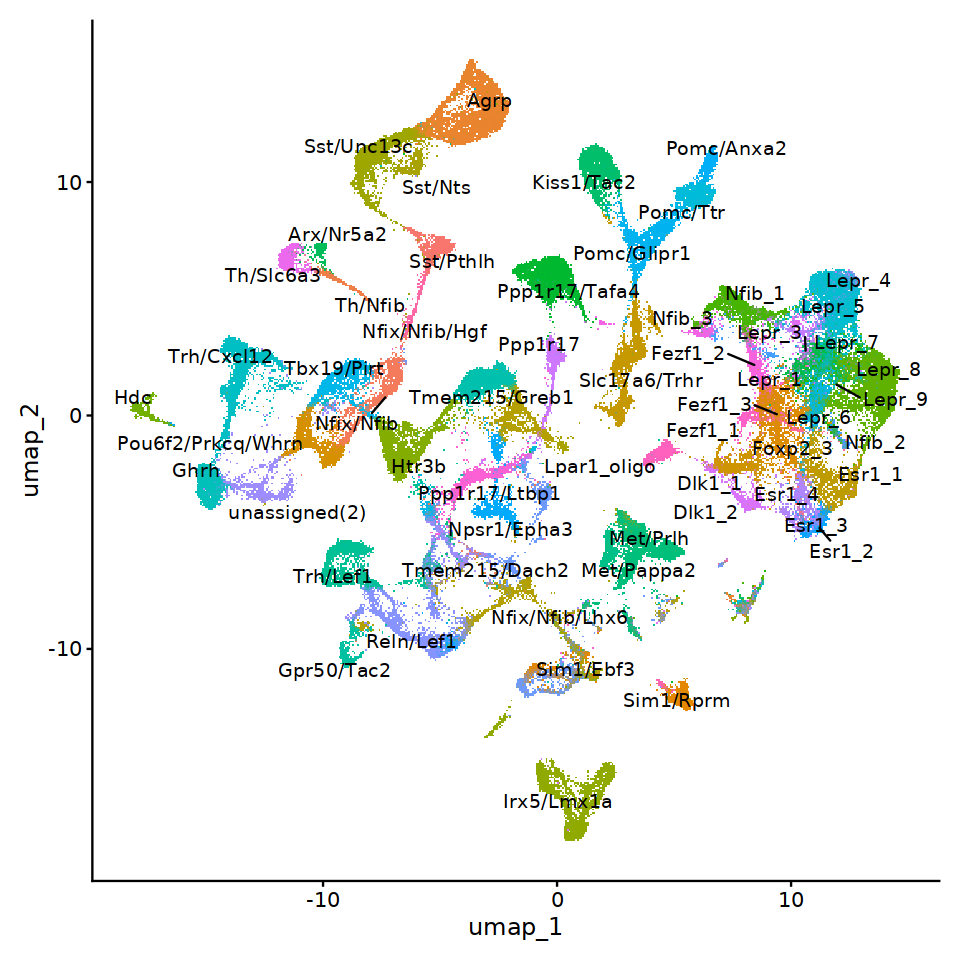

In [587]:
options(repr.plot.width=8, repr.plot.height=8)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



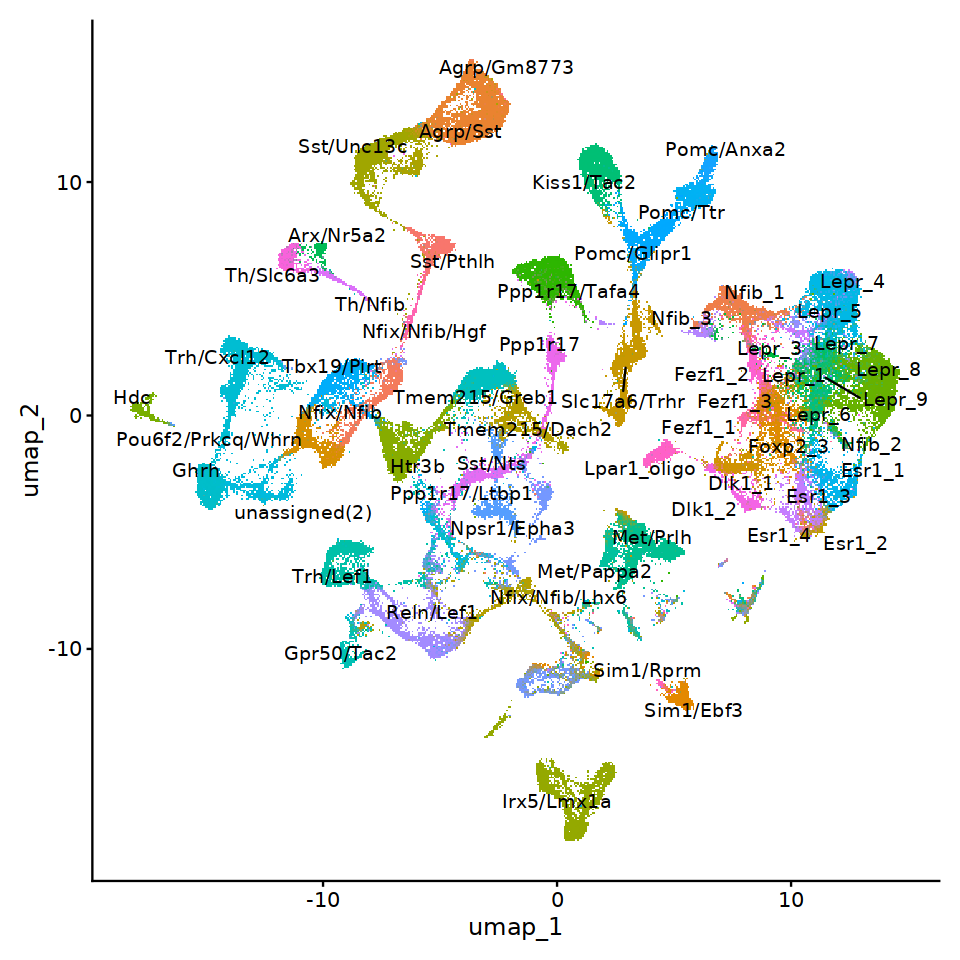

In [588]:
options(repr.plot.width=8, repr.plot.height=8)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(predicted.celltype)
DimPlot(obj_cb_neuron, reduction = "umap", label=T, repel = T) + NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



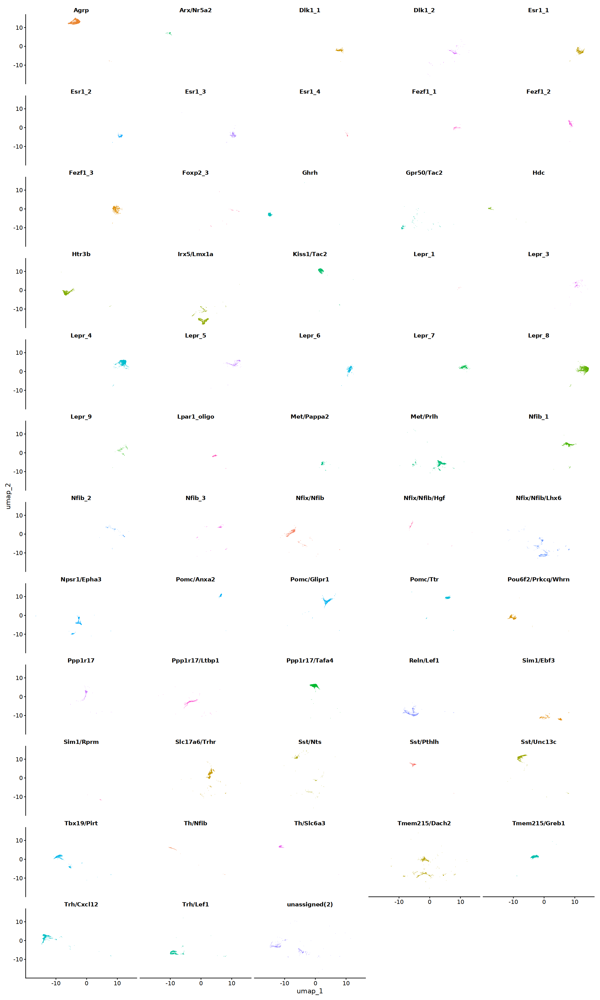

In [589]:
options(repr.plot.width=18, repr.plot.height=30)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
obj_cb_neuron %>%
DimPlot(split.by = 'labels_lvl1', ncol=5)+ NoLegend()


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



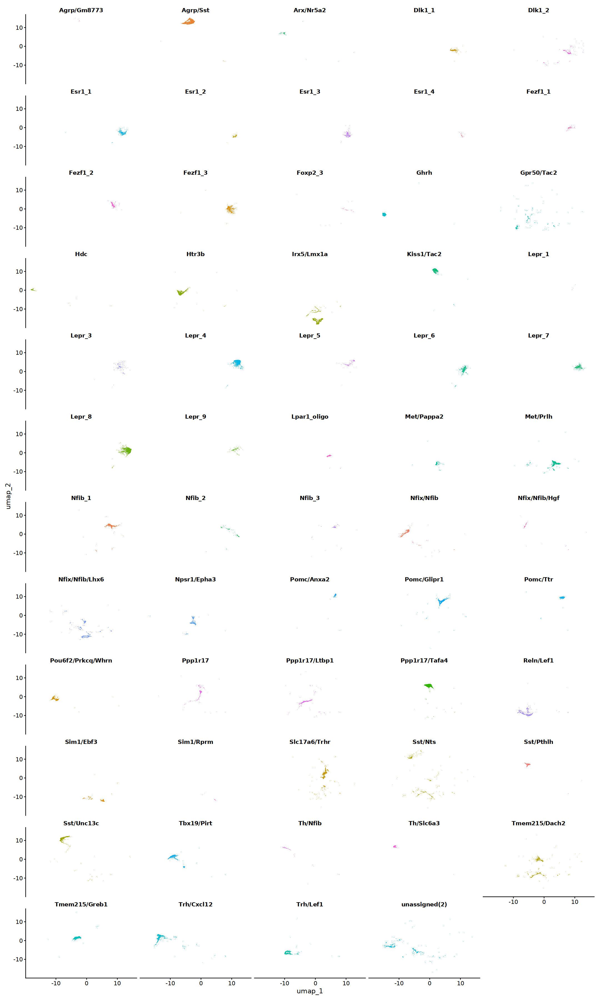

In [590]:
options(repr.plot.width=18, repr.plot.height=30)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(predicted.celltype)
obj_cb_neuron %>%
DimPlot(split.by = 'predicted.celltype', ncol=5)+ NoLegend()


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



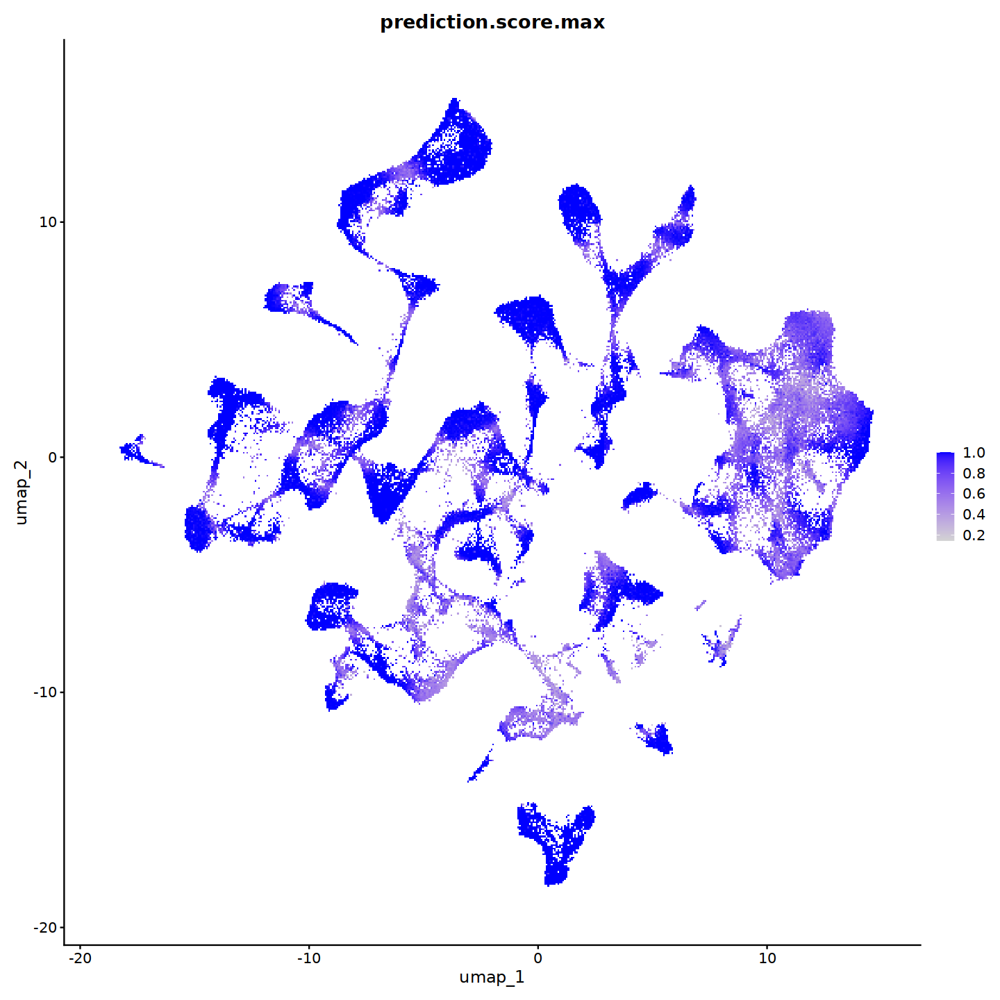

In [592]:
options(repr.plot.width=12, repr.plot.height=12)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
obj_cb_neuron %>%
FeaturePlot(features='prediction.score.max')


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



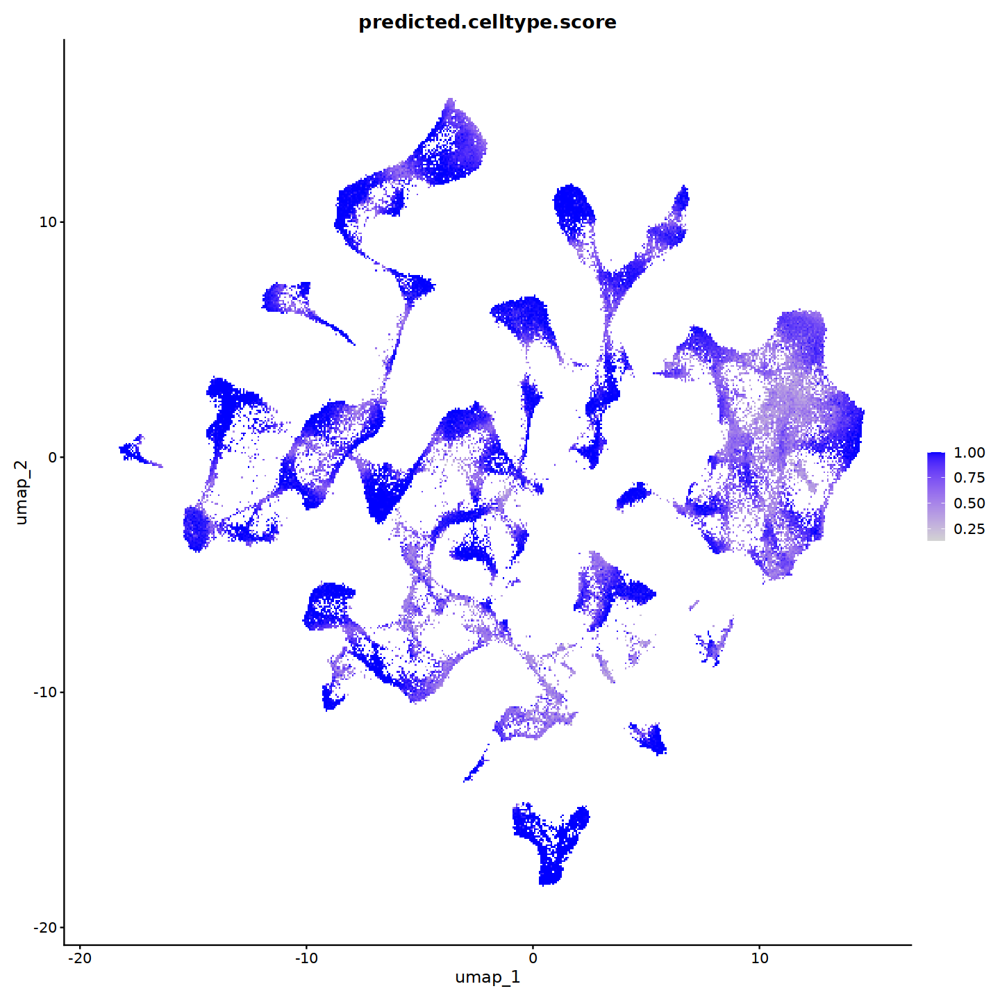

In [593]:
options(repr.plot.width=12, repr.plot.height=12)
Idents(obj_cb_neuron) <- obj_cb_neuron %>% `[[` %>% pull(labels_lvl1)
obj_cb_neuron %>%
FeaturePlot(features='predicted.celltype.score')


In [612]:
obj_other = qs::qread('_targets/objects/obj_cb_other')
obj_tany = qs::qread('_targets/objects/obj_cb_tany')

In [615]:
obj_other %>% `[[` %>% colnames

[1] "orig.ident"                         "nCount_RNA"                         "nFeature_RNA"                       "nCount_RNA_SCOP"                    "nFeature_RNA_SCOP"                 
 [6] "Index.10x_SCOP"                     "nCount_HTO_SCOP"                    "nFeature_HTO_SCOP"                  "Index.HTO_SCOP"                     "nCount_spliced_SCOP"               
[11] "nFeature_spliced_SCOP"              "nCount_unspliced_SCOP"              "nFeature_unspliced_SCOP"            "HTO_mcl_maxID_SCOP"                 "HTO_mcl_secondID_SCOP"             
[16] "HTO_mcl_margin_SCOP"                "HTO_mcl_classification_SCOP"        "HTO_mcl_classification.global_SCOP" "hash.mcl.ID_SCOP"                   "doublet_SCOP"                      
[21] "predicted_dub_std_SCOP"             "predicted_dub_cut_SCOP"             "barcode_SCOP"                       "Index.10x"                          "barcode"                           
[26] "strain"                             "treatment"                          "time"                               "collection_date"                    "isolation_date"                    
[31] "batch"                              "integrated_snn_res.0.5"             "seurat_clusters"                    "class"                              "integrated_snn_res.0.75"           
[36] "labels_lvl1"

In [619]:
obj_other_02 = obj_tany %>% `[[` %>% select(labels_lvl2) %>% AddMetaData(obj_other, .)

In [627]:
obj_other_02 %>% `[[` %>% head %>% mutate(labels_lvl2 = case_when(is.na(labels_lvl2) ~ labels_lvl1,
                                                                  TRUE ~ labels_lvl2,))

,orig.ident,nCount_RNA,nFeature_RNA,nCount_RNA_SCOP,nFeature_RNA_SCOP,Index.10x_SCOP,nCount_HTO_SCOP,nFeature_HTO_SCOP,Index.HTO_SCOP,nCount_spliced_SCOP,⋯,time,collection_date,isolation_date,batch,integrated_snn_res.0.5,seurat_clusters,class,integrated_snn_res.0.75,labels_lvl1,labels_lvl2
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<dbl>,<int>,<chr>,<dbl>,⋯,<chr>,<dbl>,<chr>,<chr>,<chr>,<fct>,<chr>,<fct>,<fct>,<fct>
SI-TT-A11_AAACCCAGTATCGGTT,SI-TT-A11,1530,1173,4761,2296,SI-TT-A11,1150,12,D706,944,⋯,Day14,220407,22/6/2022,Batch 1,1,8,other,8,Tanycytes,a1_Tanycytes
SI-TT-A11_AAACGAAAGCAACAAT,SI-TT-A11,1064,740,2640,1296,SI-TT-A11,797,12,D706,604,⋯,Day14,220407,22/6/2022,Batch 1,21,4,other,4,Oligodendrocytes,Oligodendrocytes
SI-TT-A11_AAACGAAAGGTTCTTG,SI-TT-A11,1934,1262,7617,2701,SI-TT-A11,788,12,D706,1178,⋯,Day5,220329,22/6/2022,Batch 1,22,15,other,15,OPC,OPC
SI-TT-A11_AAACGAACAAGGAGTC,SI-TT-A11,4798,2304,12026,3374,SI-TT-A11,1753,12,D706,2248,⋯,Day14,220131,22/6/2022,Batch 1,0,5,other,5,Astrocytes,Astrocytes
SI-TT-A11_AAACGAACAGCCTTCT,SI-TT-A11,2783,1648,8725,2985,SI-TT-A11,1667,12,D706,1694,⋯,Day14,220201,22/6/2022,Batch 1,0,1,other,1,Astrocytes,Astrocytes
SI-TT-A11_AAACGCTAGTGCTAGG,SI-TT-A11,1243,937,3580,1882,SI-TT-A11,991,12,D706,774,⋯,Day5,220329,22/6/2022,Batch 1,1,10,other,10,Tanycytes,a2_Tanycytes


In [639]:
obj_other_02 %>%
AddMetaData(., 
            .[[]] %>% select(labels_lvl1) %>% rename(labels_lvl3 = labels_lvl1)) %>%
`[[` %>% head

,orig.ident,nCount_RNA,nFeature_RNA,nCount_RNA_SCOP,nFeature_RNA_SCOP,Index.10x_SCOP,nCount_HTO_SCOP,nFeature_HTO_SCOP,Index.HTO_SCOP,nCount_spliced_SCOP,⋯,collection_date,isolation_date,batch,integrated_snn_res.0.5,seurat_clusters,class,integrated_snn_res.0.75,labels_lvl1,labels_lvl2,labels_lvl3
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<dbl>,<int>,<chr>,<dbl>,⋯,<dbl>,<chr>,<chr>,<chr>,<fct>,<chr>,<fct>,<fct>,<fct>,<fct>
SI-TT-A11_AAACCCAGTATCGGTT,SI-TT-A11,1530,1173,4761,2296,SI-TT-A11,1150,12,D706,944,⋯,220407,22/6/2022,Batch 1,1,8,other,8,Tanycytes,a1_Tanycytes,Tanycytes
SI-TT-A11_AAACGAAAGCAACAAT,SI-TT-A11,1064,740,2640,1296,SI-TT-A11,797,12,D706,604,⋯,220407,22/6/2022,Batch 1,21,4,other,4,Oligodendrocytes,NA,Oligodendrocytes
SI-TT-A11_AAACGAAAGGTTCTTG,SI-TT-A11,1934,1262,7617,2701,SI-TT-A11,788,12,D706,1178,⋯,220329,22/6/2022,Batch 1,22,15,other,15,OPC,NA,OPC
SI-TT-A11_AAACGAACAAGGAGTC,SI-TT-A11,4798,2304,12026,3374,SI-TT-A11,1753,12,D706,2248,⋯,220131,22/6/2022,Batch 1,0,5,other,5,Astrocytes,NA,Astrocytes
SI-TT-A11_AAACGAACAGCCTTCT,SI-TT-A11,2783,1648,8725,2985,SI-TT-A11,1667,12,D706,1694,⋯,220201,22/6/2022,Batch 1,0,1,other,1,Astrocytes,NA,Astrocytes
SI-TT-A11_AAACGCTAGTGCTAGG,SI-TT-A11,1243,937,3580,1882,SI-TT-A11,991,12,D706,774,⋯,220329,22/6/2022,Batch 1,1,10,other,10,Tanycytes,a2_Tanycytes,Tanycytes


In [641]:
obj_other_02 %>% `[[` %>%colnames

[1] "orig.ident"                         "nCount_RNA"                         "nFeature_RNA"                       "nCount_RNA_SCOP"                    "nFeature_RNA_SCOP"                 
 [6] "Index.10x_SCOP"                     "nCount_HTO_SCOP"                    "nFeature_HTO_SCOP"                  "Index.HTO_SCOP"                     "nCount_spliced_SCOP"               
[11] "nFeature_spliced_SCOP"              "nCount_unspliced_SCOP"              "nFeature_unspliced_SCOP"            "HTO_mcl_maxID_SCOP"                 "HTO_mcl_secondID_SCOP"             
[16] "HTO_mcl_margin_SCOP"                "HTO_mcl_classification_SCOP"        "HTO_mcl_classification.global_SCOP" "hash.mcl.ID_SCOP"                   "doublet_SCOP"                      
[21] "predicted_dub_std_SCOP"             "predicted_dub_cut_SCOP"             "barcode_SCOP"                       "Index.10x"                          "barcode"                           
[26] "strain"                             "treatment"                          "time"                               "collection_date"                    "isolation_date"                    
[31] "batch"                              "integrated_snn_res.0.5"             "seurat_clusters"                    "class"                              "integrated_snn_res.0.75"           
[36] "labels_lvl1"                        "labels_lvl2"